# TEST CON FEATURES DEL PSD

# Generar 'X' e 'y' para todos los experimentos
<p>Como datos para las X se toma la media de los 17 canales de:</p>
<ul>
    <li>X_1: PSD de la banda delta (1~4Hz)</li>
    <li>X_2: PSD de la banda theta (4~8Hz)</li>
    <li>X_3: PSD de la banda alpha (8~14Hz)</li>
    <li>X_4: PSD de la banda beta (14~31Hz)</li>
    <li>X_5: PSD de la banda gamma (31~50 Hz)</li>
</ul>

In [1]:
import mne
from mne.externals.pymatreader import read_mat

from read import read_features

import matplotlib
import matplotlib.pyplot as plt

import numpy as np

import pandas as pd

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler

In [2]:
labels = {
    'leve': 0,
    'moderada': 1,
    'severa': 2
}

def parse_y(y, lim_leve=0.075, lim_moderada=0.15):
    def classify(val):
        if (val <= lim_leve):
            return labels['leve']
        if (val <= lim_moderada):
            return labels['moderada']
        return labels['severa']
    
    len_y = len(y)
    classified = np.zeros(len_y, dtype=int)
    
    for i in range(len_y):
        classified[i] = classify(y[i])
        
    return classified

In [3]:
# Las que mejores graficas tienen
# features_files = ['4_20151105_noon.mat', '4_20151107_noon.mat', '5_20141108_noon.mat','12_20150928_noon.mat','14_20151014_night.mat', '18_20150926_noon.mat', '21_20151016_noon.mat']

# features_files = ['4_20151105_noon.mat', '5_20141108_noon.mat', '21_20151016_noon.mat']

features_files = ['1_20151124_noon_2.csv', '2_20151106_noon.csv', '3_20151024_noon.csv','4_20151105_noon.csv', '4_20151107_noon.csv',
            '5_20141108_noon.csv', '5_20151012_night.csv', '6_20151121_noon.csv','7_20151015_night.csv', '8_20151022_noon.csv', 
            '9_20151017_night.csv', '10_20151125_noon.csv', '11_20151024_night.csv', '12_20150928_noon.csv', '13_20150929_noon.csv',
            '14_20151014_night.csv','15_20151126_night.csv', '16_20151128_night.csv', '17_20150925_noon.csv', '18_20150926_noon.csv',
            '19_20151114_noon.csv', '20_20151129_night.csv', '21_20151016_noon.csv']

# features_files = ['21_20151016_noon.csv']

X_all = {} # psd
X_all_eog = {} # psd + eog
y_all = {} # datos perclos raw
y_all_limits = {} # thresholds perclos para cada experimento
y_all_class = {} # datos parseados a su clase

for experiment in features_files:
    
    ''' EOG parpadeos por epoch'''
    mat_data = read_mat(f'./SEED-VIG/Raw_Data/{experiment[:-4]}.mat')
    
    sfreq = mat_data['EOG']['eog_config']['current_sample_rate']
    samples = mat_data['EOG']['eog_h']*1e-6 
    samples = np.vstack((samples, mat_data['EOG']['eog_v']*1e-6))

    ch_names = ['EOG_H', 'EOG_V']
    ch_types = ["eog"]*len(ch_names)

    info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types=ch_types)

    info.set_montage('standard_1020')
    
    raw = mne.io.RawArray(samples, info, verbose=False)
    
    # Busqueda del treshold para el parpadeo
    # En los 5 primeros segundos del experimento, buscamos el percentil 2.5 y calculamos su valor absoluto como threshold para detectar parpadeos
    threshold = abs(np.percentile(raw.get_data()[1][:5*1000], 2.5))
    
    blinks = mne.preprocessing.find_eog_events(raw, filter_length='10s', thresh=threshold, verbose=False)
    blinks = blinks.T[0]
    
    n_samples = 885
    dur_sample = 8 # segs
    len_sample = 8*125
    
    blinks_per_sample = []
    for i in range(n_samples):
        blinks_per_sample.append([])
        
    for val in blinks:
        blinks_per_sample[val//len_sample].append(val)
    
    n_blinks_per_sample = [0]*n_samples
        
    for i in range(885):
        n_blinks_per_sample[i] = len(blinks_per_sample[i])
        
    scaler = MinMaxScaler(feature_range=(0, 1))
    n_blinks_per_sample = np.array(n_blinks_per_sample)
    n_blinks_per_sample = scaler.fit_transform(n_blinks_per_sample.reshape(-1,1))
    
    
    ''' PSD '''
    mat_data = read_mat(f'./SEED-VIG/EEG_Feature_5Bands/{experiment[:-4]}.mat')
    perclos_data = read_mat(f'./SEED-VIG/perclos_labels/{experiment[:-4]}.mat')
    y = np.array(perclos_data['perclos'])

    n_channels = 17
    psd_data = mat_data['psd_movingAve']
    perclos = []
    psd_delta = []
    psd_theta = []
    psd_alpha = []
    psd_beta = []
    psd_gamma = []
    start = 0
    end = 885
    for t in range(start, end):
        vals= np.zeros(5)

        for i in range(n_channels):
            vals[0] += psd_data[i][t][0]
            vals[1] += psd_data[i][t][1]
            vals[2] += psd_data[i][t][2]
            vals[3] += psd_data[i][t][3]
            vals[4] += psd_data[i][t][4]
        vals /= 17

        perclos.append(y[t])
        psd_delta.append(vals[0])
        psd_theta.append(vals[1])
        psd_alpha.append(vals[2])
        psd_beta.append(vals[3])
        psd_gamma.append(vals[4])

    
    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_delta = np.array(psd_delta)
    psd_delta = scaler.fit_transform(psd_delta.reshape(-1,1))

    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_theta = np.array(psd_theta)
    psd_theta = scaler.fit_transform(psd_theta.reshape(-1,1))

    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_alpha = np.array(psd_alpha)
    psd_alpha = scaler.fit_transform(psd_alpha.reshape(-1,1))

    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_beta = np.array(psd_beta)
    psd_beta = scaler.fit_transform(psd_beta.reshape(-1,1))
    
    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_gamma = np.array(psd_gamma)
    psd_gamma = scaler.fit_transform(psd_gamma.reshape(-1,1))

    X = psd_delta
    X = np.hstack((X, psd_theta))
    X = np.hstack((X, psd_alpha))
    X = np.hstack((X, psd_beta))
    ''' DESCOMENTAR PARA USAR PSD DE GAMMA '''
    X = np.hstack((X, psd_gamma))
    
    X_all[f'{experiment[:-4]}'] = X # guardamos los psd
    
    X = np.hstack((X, n_blinks_per_sample))
    
    X_all_eog[f'{experiment[:-4]}'] = X # guardamos psd + eog
    
    ''' LABELS '''
    y_all[f'{experiment[:-4]}'] = y # guardamos perclos raw
    
    range_values = (np.max(y)-np.min(y))/100
    lim_leve = np.min(y)+range_values*12.5
    lim_moderada = np.min(y)+range_values*30
    y_all_limits[f'{experiment[:-4]}'] = [lim_leve, lim_moderada]
    
    y_all_class[f'{experiment[:-4]}'] = parse_y(y, lim_leve, lim_moderada) # guardamos ya clasificada
    
print(f'Generados los diccionarios X_all e y_all')

Generados los diccionarios X_all e y_all


In [4]:
print(X_all_eog['1_20151124_noon_2'].shape)

for key in X_all:
    print(key)

(885, 6)
1_20151124_noon_2
2_20151106_noon
3_20151024_noon
4_20151105_noon
4_20151107_noon
5_20141108_noon
5_20151012_night
6_20151121_noon
7_20151015_night
8_20151022_noon
9_20151017_night
10_20151125_noon
11_20151024_night
12_20150928_noon
13_20150929_noon
14_20151014_night
15_20151126_night
16_20151128_night
17_20150925_noon
18_20150926_noon
19_20151114_noon
20_20151129_night
21_20151016_noon


# Para busqueda de hyperparametros y plotear resultados/metricas

## Regresion

In [5]:
from sklearn.model_selection import RandomizedSearchCV

from sklearn.model_selection import StratifiedShuffleSplit

from sklearn.model_selection import train_test_split

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

from scipy.stats import uniform, randint, loguniform, gamma

def find_and_test_best_model_reg(X, y, model, space, cv=10, n_iter=100, scoring=None):
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)
    
    search = RandomizedSearchCV(model, space, n_iter=n_iter, scoring=scoring, n_jobs=-1, cv=cv, random_state=42)
    result = search.fit(X_train, y_train)
    
    print(f"Best Model:")
    print(f"\tScore: {result.best_score_:.4f}")
    print(f"\tHyperparameters: {result.best_params_}")
    
    print('\nResults with X_test:')
    best_model = result.best_estimator_
    final_predictions = best_model.predict(X_test)
    # Por si los valores son mayores de 1 o menores que 0
    final_predictions = np.clip(final_predictions, 0, 1)
    
    rmse = np.sqrt(mean_squared_error(y_test, final_predictions))
    print(f"\tRMSE: {rmse:.4f}")
    
    # represents the proportion of variance (of y) that has been explained by the independent variables in the model
    r2 = r2_score(y_test, final_predictions)
    print(f"\tr^2: {r2:.4f}")
    
    return best_model, rmse, r2

def plot_results_reg(X, y, model):
    plt.figure(figsize=(20, 8))
    plt.plot(y, color="black", label="real", zorder=0)
    predictions = model.predict(X)
    predictions = np.clip(predictions, 0, 1)
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.show()

## Juntamos todos los datos en un solo X e y

In [95]:
from read import read_features

X = []
X_eog = []
X_eeg = []
y = []
y_class = []

for key in X_all:
    X.append(X_all[key])
    X_eog.append(X_all_eog[key])
    aux, aux2 = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    aux_minmax = scaler.fit_transform(aux)
    X_eeg.append(aux_minmax)
    
    y.append(y_all[key])
    y_class.append(y_all_class[key])

X = np.array(X)
X = X.reshape((X.shape[0]*X.shape[1], X.shape[2]))
X_eog = np.array(X_eog)
X_eog = X_eog.reshape((X_eog.shape[0]*X_eog.shape[1], X_eog.shape[2]))
X_eeg = np.array(X_eeg)
X_eeg = X_eeg.reshape((X_eeg.shape[0]*X_eeg.shape[1], X_eeg.shape[2]))

y = np.array(y)
y = y.reshape((y.shape[0]*y.shape[1]))

In [96]:
print(f'{X.shape}, {X_eog.shape}, {X_eeg.shape}, {y.shape}')

(20355, 5), (20355, 6), (20355, 136), (20355,)


# Modelo General
Se entrena con todos los datos de los experimentos

## SMV-r

In [22]:
from sklearn.svm import SVR

### SMV-r EEG

In [ ]:
print(f"Experiment: Modelo General SVM-r EEG")
model = SVR()

space = dict()

space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['tol'] = uniform(1e-5, 1e-1)
space['C'] = randint(1, 500)
space['epsilon'] = uniform(0.01, 0.5)
space['shrinking'] = [True, False]

general_model, rmse, r2 = find_and_test_best_model_reg(X_eeg, y, model, space, cv=10,  n_iter=10)

for key in X_all:   
    data, aux2 = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_minmax = scaler.fit_transform(data_minmax)
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

Experiment: Modelo General SVM-r EEG


In [ ]:
for key in X_all:   
    data, aux2 = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_minmax = scaler.fit_transform(data_minmax)
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### SMV-r PSD

In [72]:
print(f"Experiment: Modelo General SVM-r PSD")
model = SVR()

space = dict()

space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['tol'] = uniform(1e-5, 1e-1)
space['C'] = randint(1, 500)
space['epsilon'] = uniform(0.01, 0.5)
space['shrinking'] = [True, False]

general_model, rmse, r2 = find_and_test_best_model_reg(X, y, model, space, cv=10,  n_iter=10)

Experiment: Modelo General SVM-r PSD
Best Model:
	Score: 0.4326
	Hyperparameters: {'C': 100, 'epsilon': 0.08143340896097039, 'gamma': 'scale', 'kernel': 'rbf', 'shrinking': True, 'tol': 0.09700098521619943}

Results with X_test:
	RMSE: 0.2055
	r^2: 0.4279


Experiment: 1_20151124_noon_2
	RMSE: 0.1380
	r^2: 0.7694


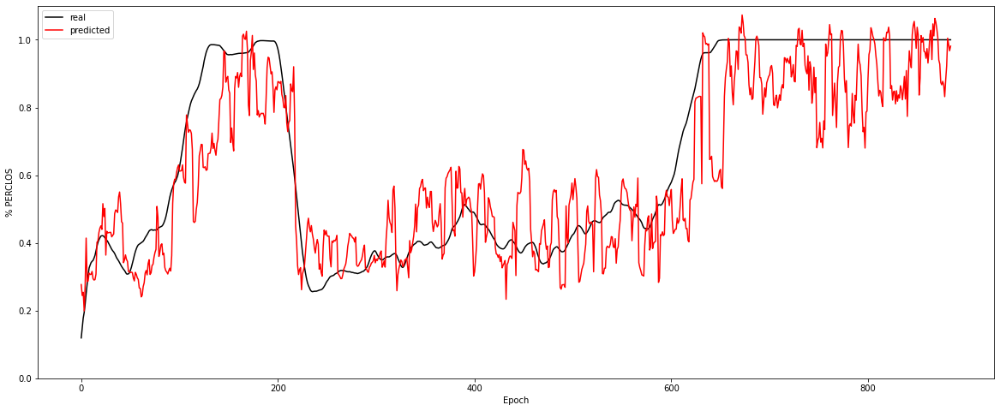

Experiment: 2_20151106_noon
	RMSE: 0.1493
	r^2: 0.1686


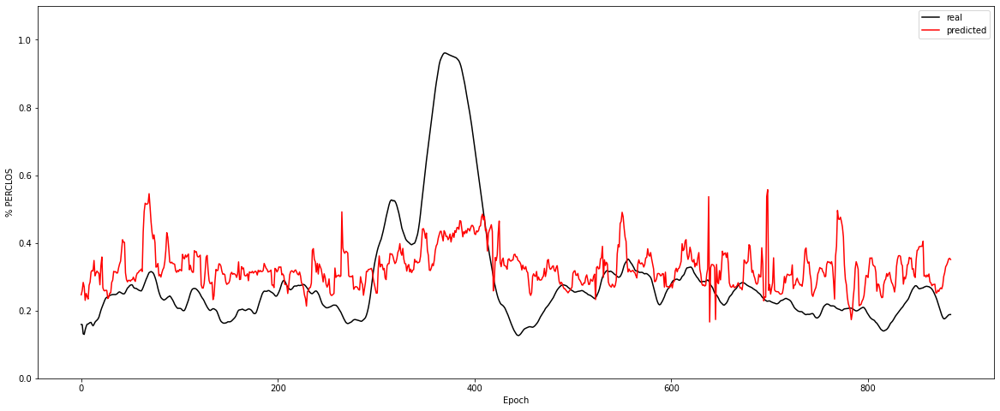

Experiment: 3_20151024_noon
	RMSE: 0.1823
	r^2: -0.2505


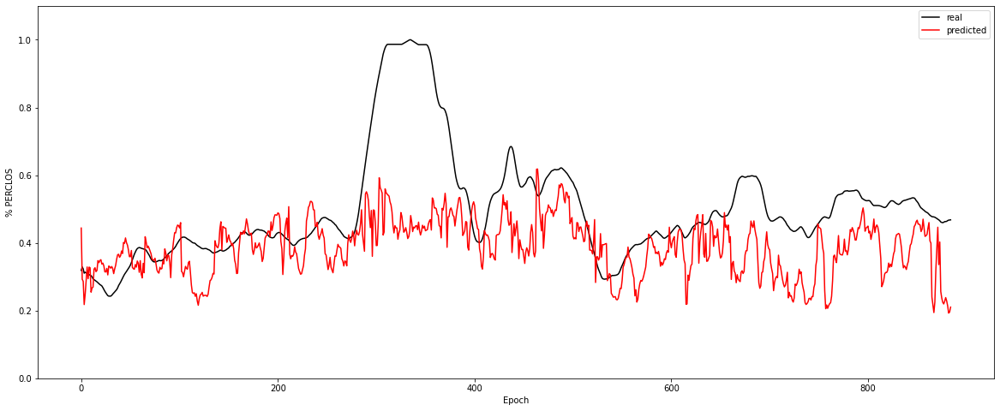

Experiment: 4_20151105_noon
	RMSE: 0.1444
	r^2: 0.4456


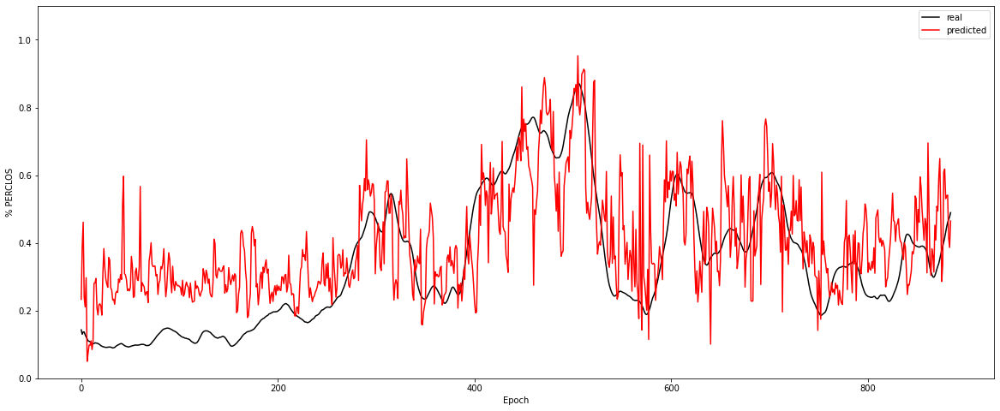

Experiment: 4_20151107_noon
	RMSE: 0.1417
	r^2: 0.6436


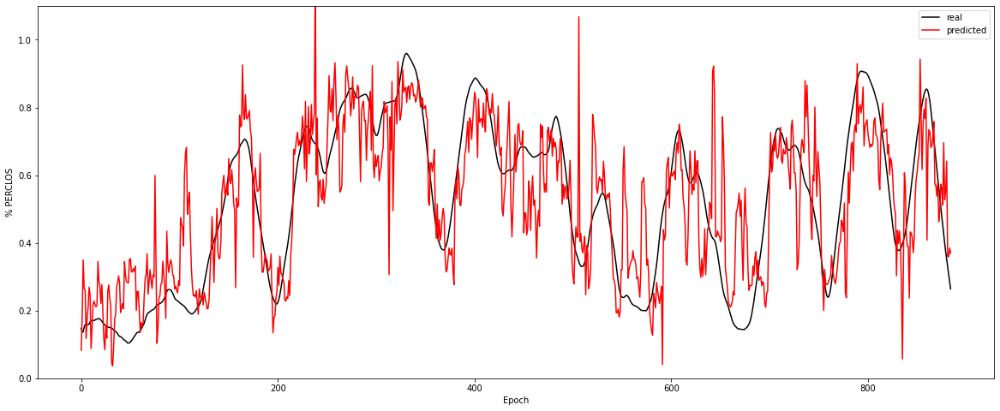

Experiment: 5_20141108_noon
	RMSE: 0.2069
	r^2: 0.6011


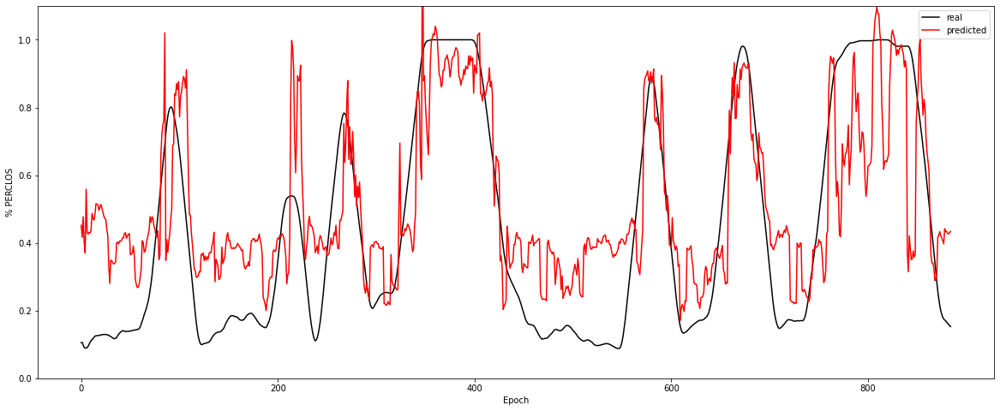

Experiment: 5_20151012_night
	RMSE: 0.2610
	r^2: 0.0625


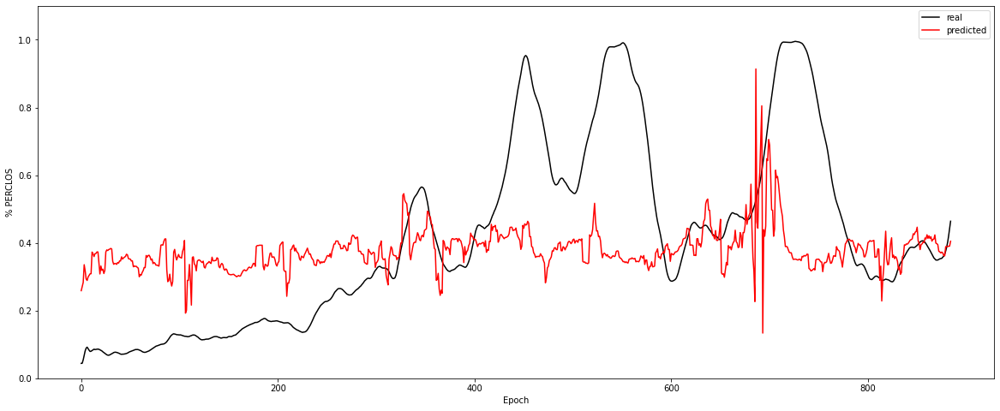

Experiment: 6_20151121_noon
	RMSE: 0.1539
	r^2: -0.4856


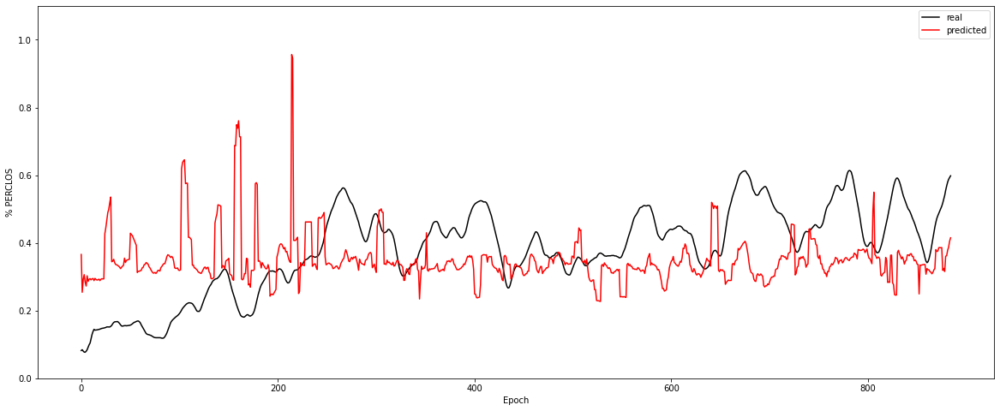

Experiment: 7_20151015_night
	RMSE: 0.0929
	r^2: 0.3458


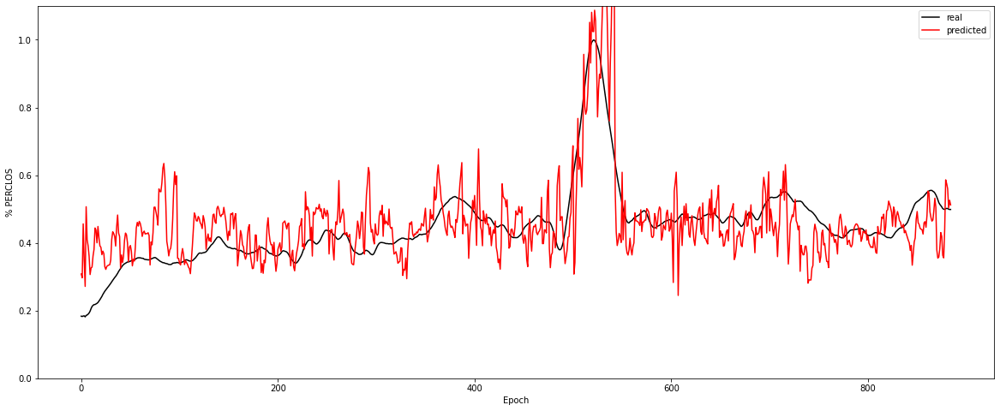

Experiment: 8_20151022_noon
	RMSE: 0.2432
	r^2: -0.0282


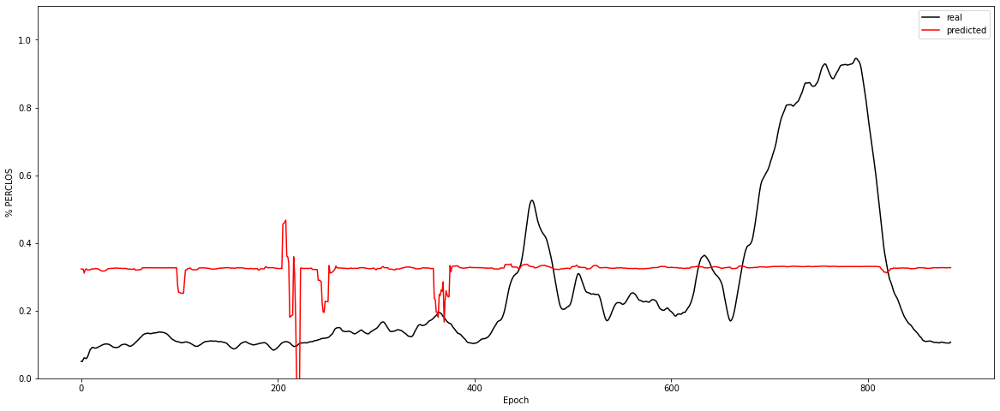

Experiment: 9_20151017_night
	RMSE: 0.1143
	r^2: 0.1251


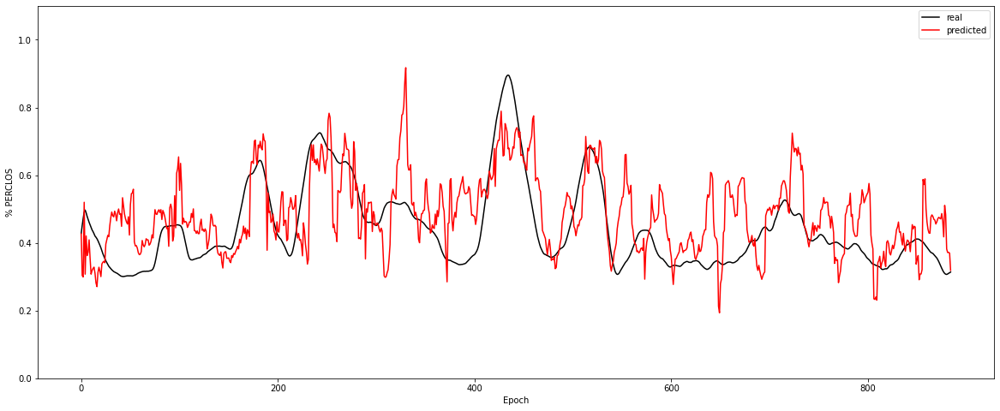

Experiment: 10_20151125_noon
	RMSE: 0.1583
	r^2: -0.1831


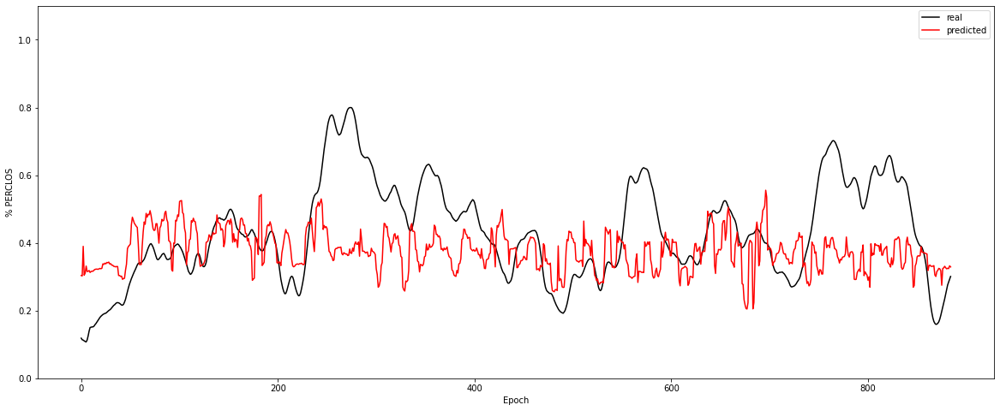

Experiment: 11_20151024_night
	RMSE: 0.0995
	r^2: 0.4300


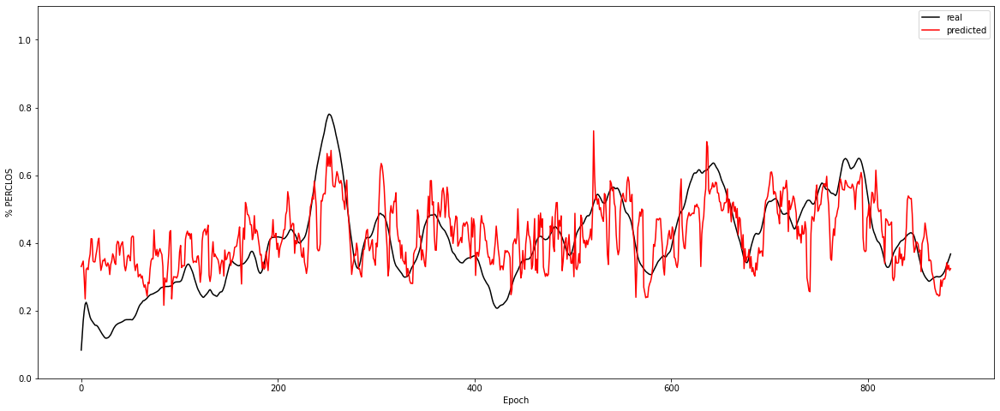

Experiment: 12_20150928_noon
	RMSE: 0.1661
	r^2: 0.8058


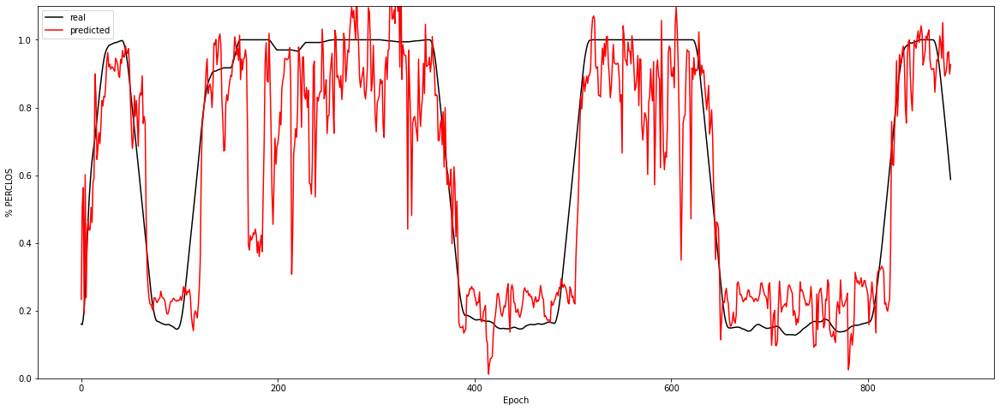

Experiment: 13_20150929_noon
	RMSE: 0.1808
	r^2: 0.1878


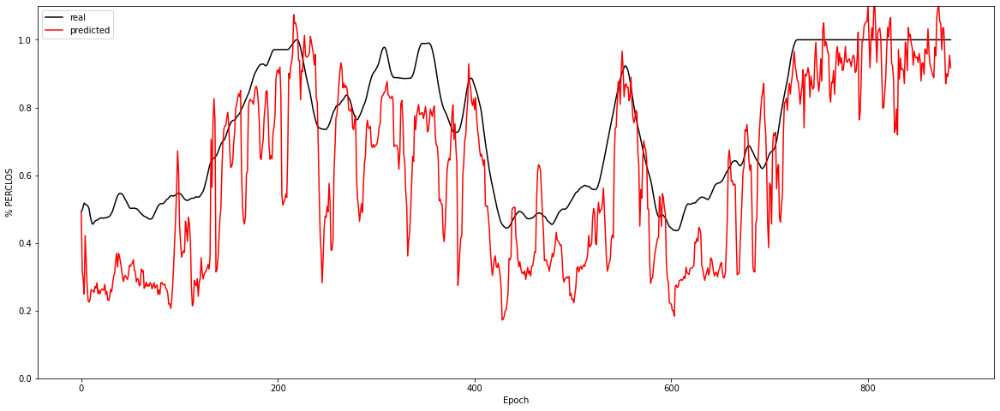

Experiment: 14_20151014_night
	RMSE: 0.1632
	r^2: 0.4883


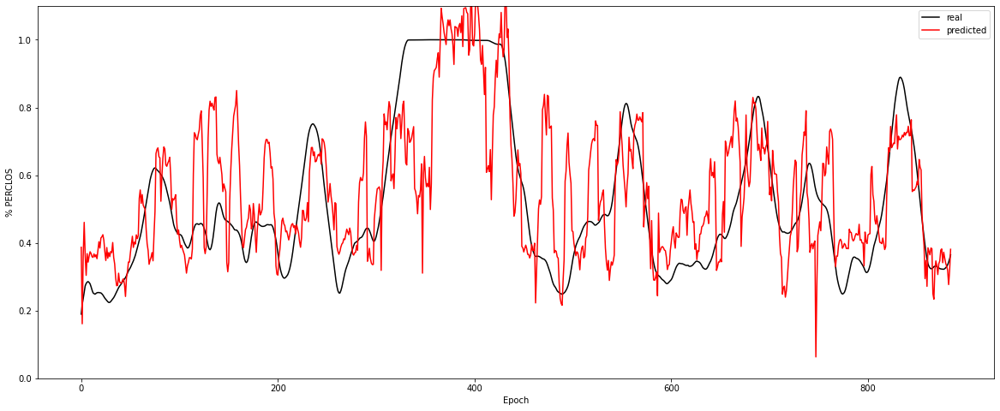

Experiment: 15_20151126_night
	RMSE: 0.1643
	r^2: -0.0095


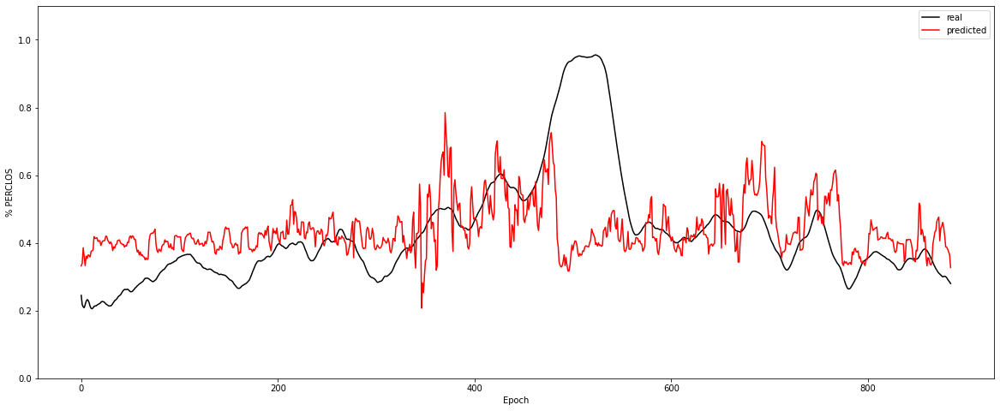

Experiment: 16_20151128_night
	RMSE: 0.4312
	r^2: -0.7788


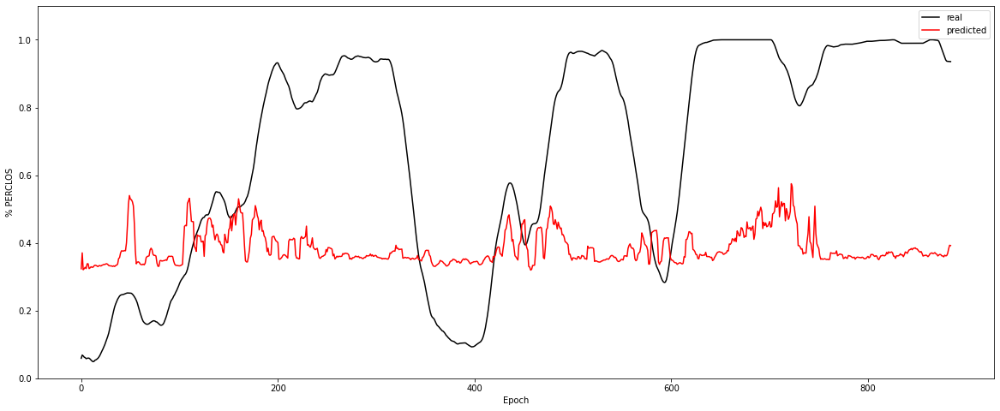

Experiment: 17_20150925_noon
	RMSE: 0.0999
	r^2: 0.7493


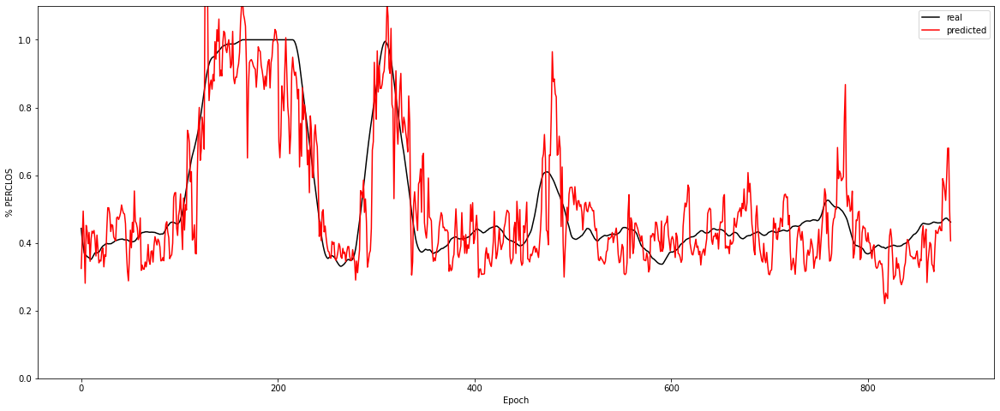

Experiment: 18_20150926_noon
	RMSE: 0.2219
	r^2: 0.5732


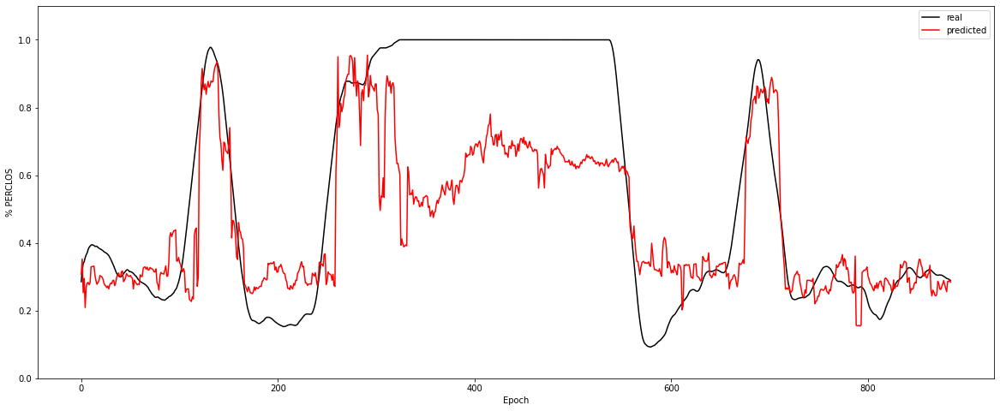

Experiment: 19_20151114_noon
	RMSE: 0.1169
	r^2: 0.0130


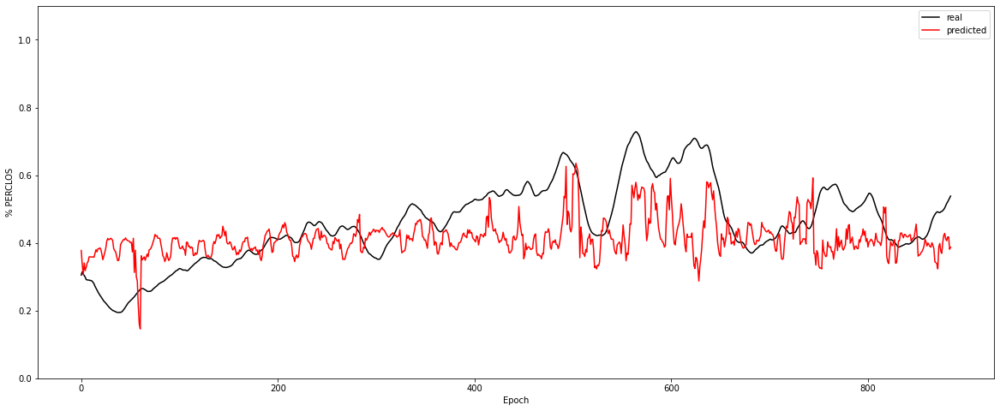

Experiment: 20_20151129_night
	RMSE: 0.3332
	r^2: 0.1397


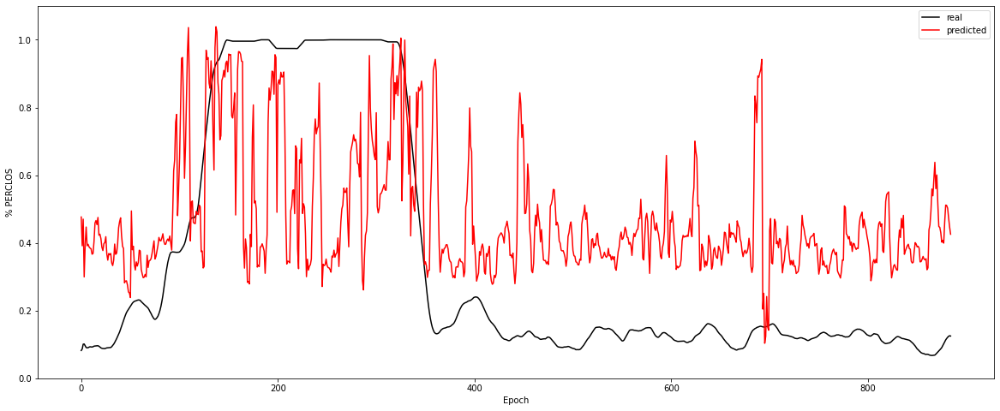

Experiment: 21_20151016_noon
	RMSE: 0.2071
	r^2: 0.5943


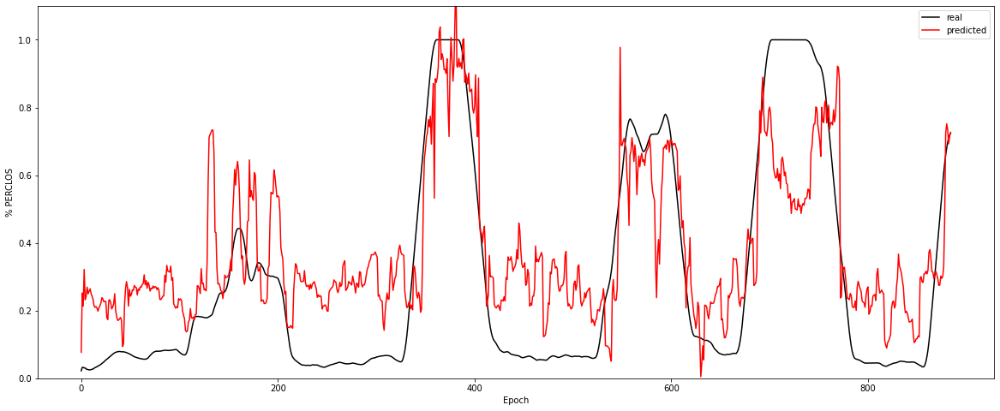

In [73]:
for key in X_all:
    data = X_all[key]
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### SMV-r PSD + EOG

In [74]:
print(f"Experiment: Modelo General SVM-r PSD + EOG")
model = SVR()

space = dict()

space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['tol'] = uniform(1e-5, 1e-1)
space['C'] = randint(1, 500)
space['epsilon'] = uniform(0.01, 0.5)
space['shrinking'] = [True, False]

general_model, rmse, r2 = find_and_test_best_model_reg(X_eog, y, model, space, cv=10,  n_iter=10)

Experiment: Modelo General SVM-r PSD + EOG
Best Model:
	Score: 0.5409
	Hyperparameters: {'C': 100, 'epsilon': 0.08143340896097039, 'gamma': 'scale', 'kernel': 'rbf', 'shrinking': True, 'tol': 0.09700098521619943}

Results with X_test:
	RMSE: 0.1807
	r^2: 0.5579


Experiment: 1_20151124_noon_2
	RMSE: 0.1206
	r^2: 0.8240


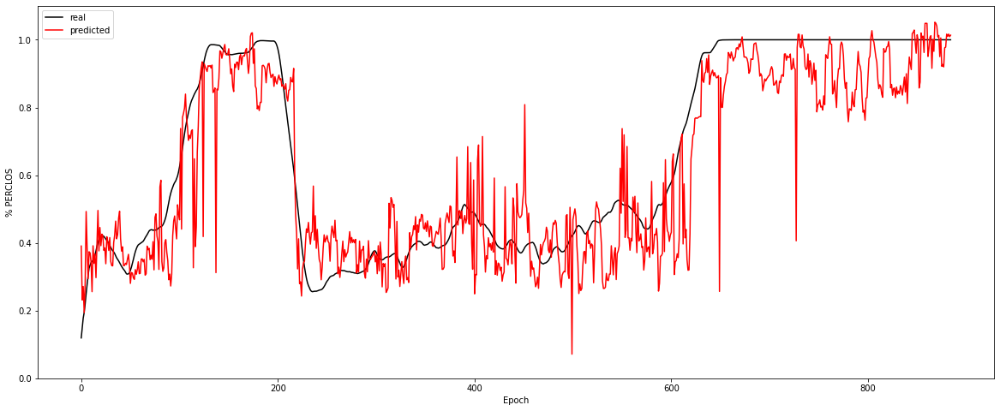

Experiment: 2_20151106_noon
	RMSE: 0.1360
	r^2: 0.3093


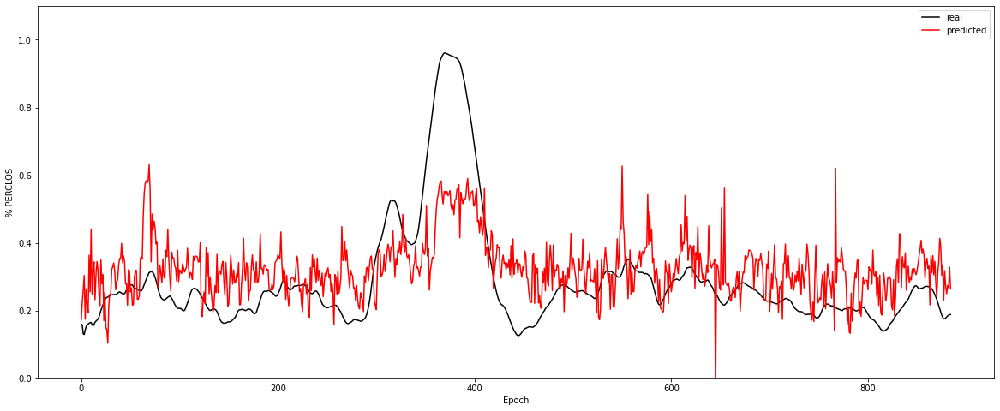

Experiment: 3_20151024_noon
	RMSE: 0.1592
	r^2: 0.0456


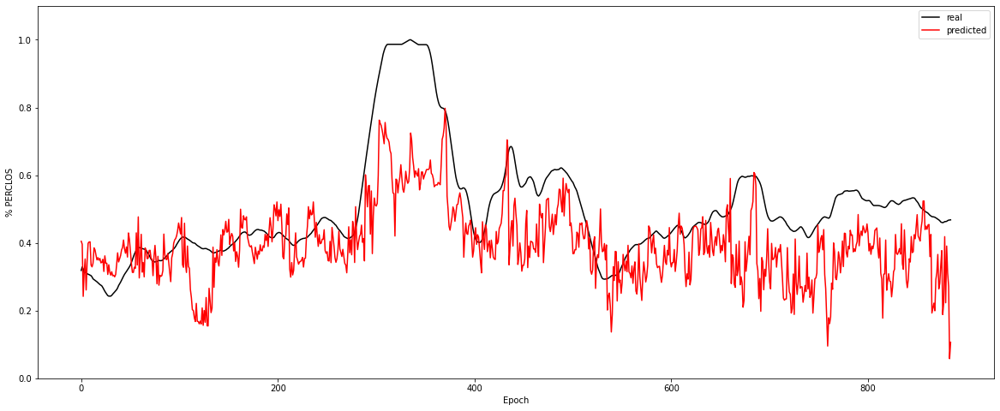

Experiment: 4_20151105_noon
	RMSE: 0.1502
	r^2: 0.3999


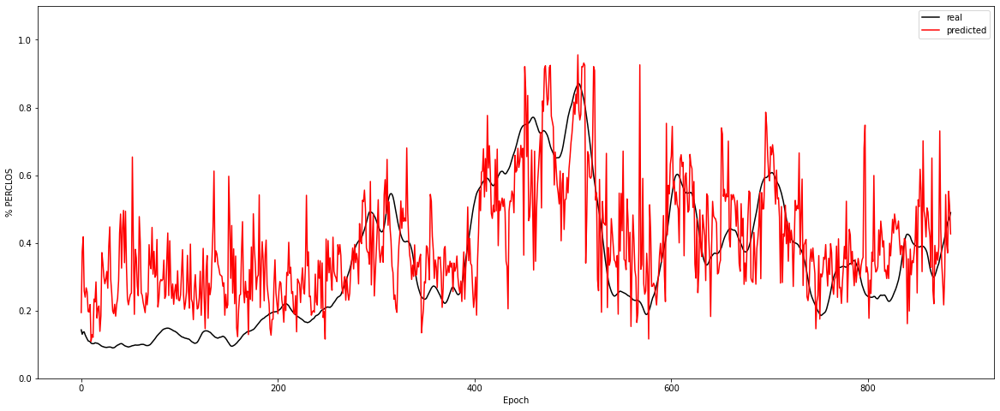

Experiment: 4_20151107_noon
	RMSE: 0.1458
	r^2: 0.6225


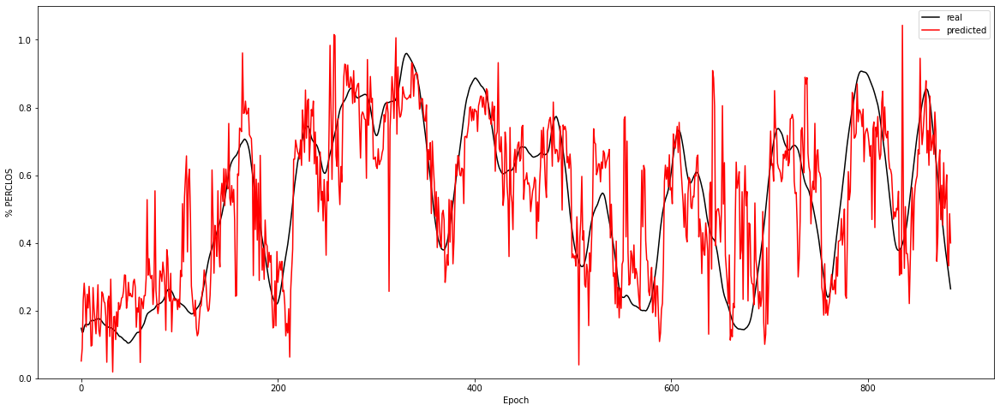

Experiment: 5_20141108_noon
	RMSE: 0.1960
	r^2: 0.6419


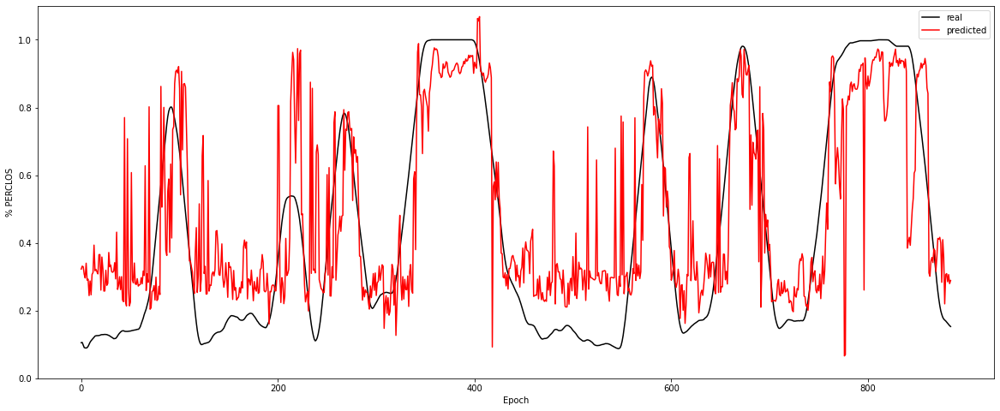

Experiment: 5_20151012_night
	RMSE: 0.2244
	r^2: 0.3069


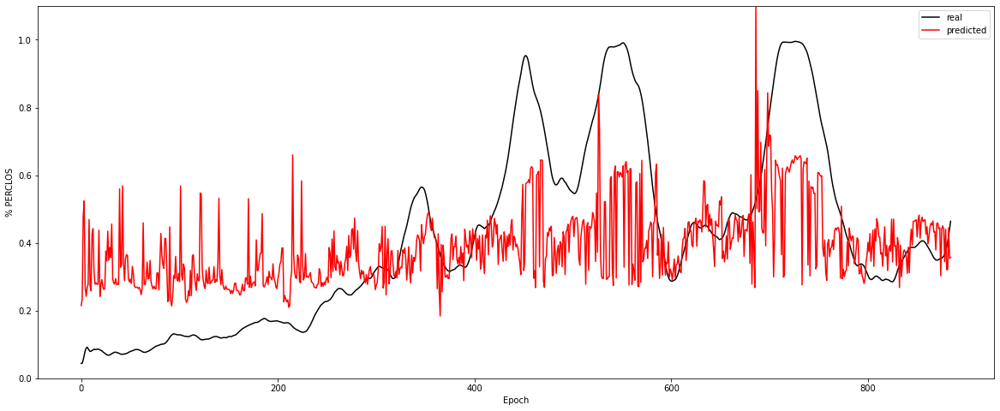

Experiment: 6_20151121_noon
	RMSE: 0.1785
	r^2: -0.9988


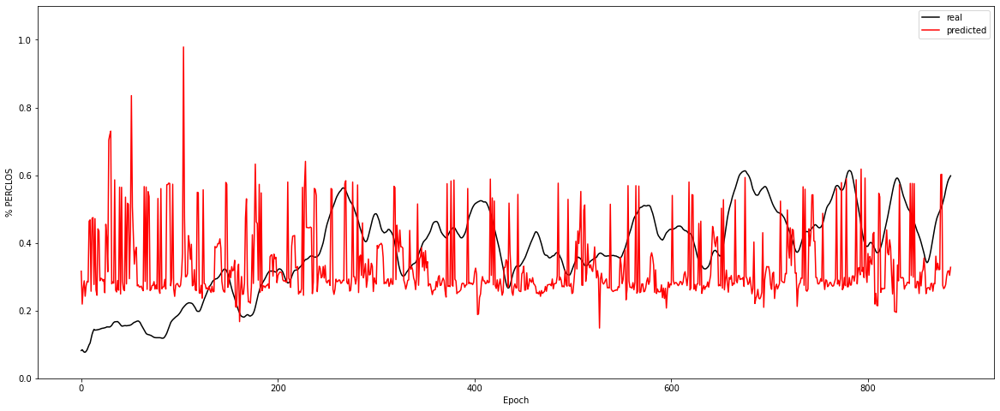

Experiment: 7_20151015_night
	RMSE: 0.0885
	r^2: 0.4064


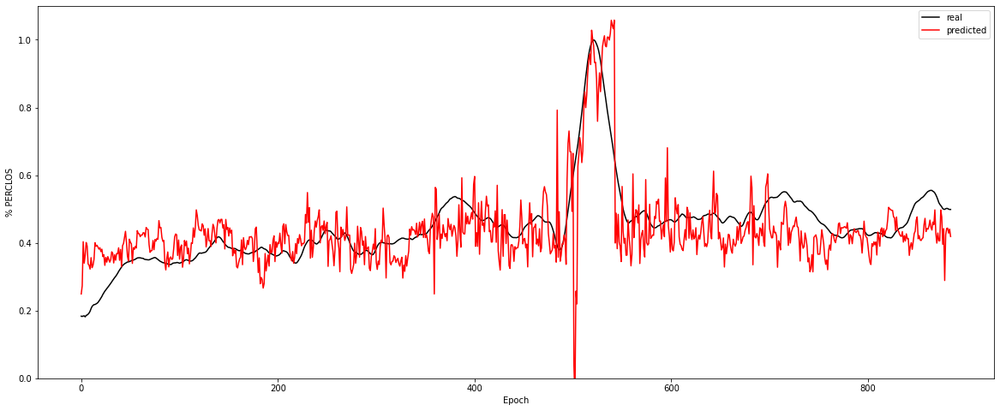

Experiment: 8_20151022_noon
	RMSE: 0.1966
	r^2: 0.3277


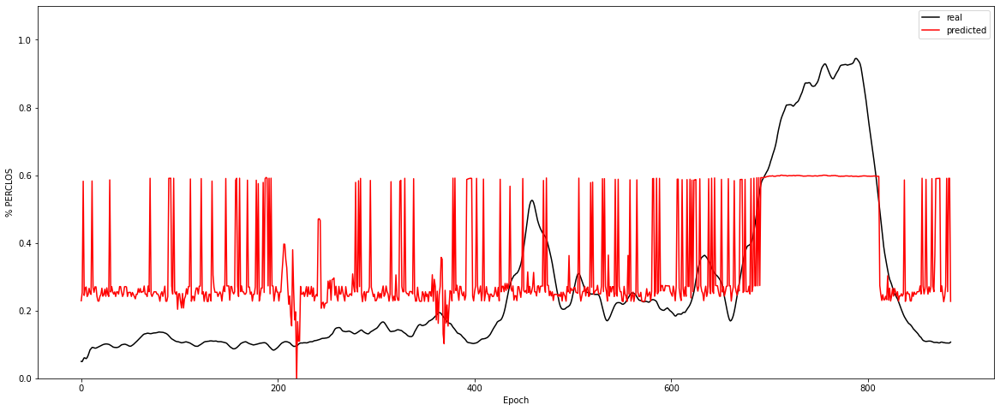

Experiment: 9_20151017_night
	RMSE: 0.1144
	r^2: 0.1236


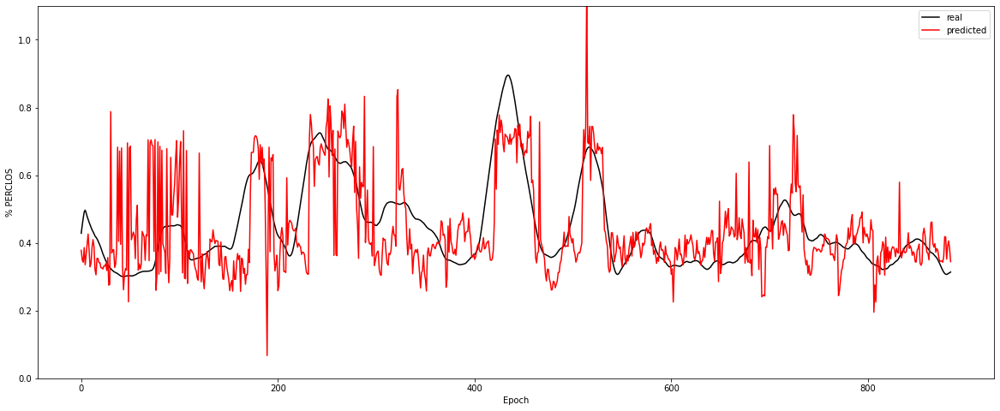

Experiment: 10_20151125_noon
	RMSE: 0.1595
	r^2: -0.2008


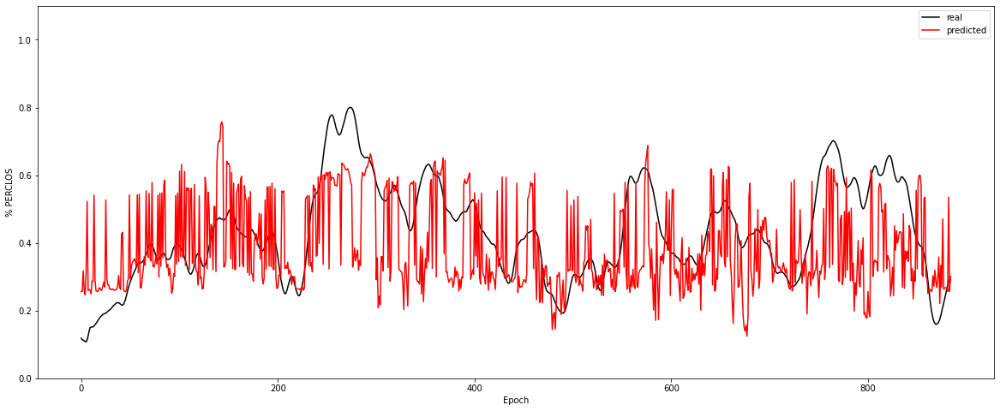

Experiment: 11_20151024_night
	RMSE: 0.1015
	r^2: 0.4071


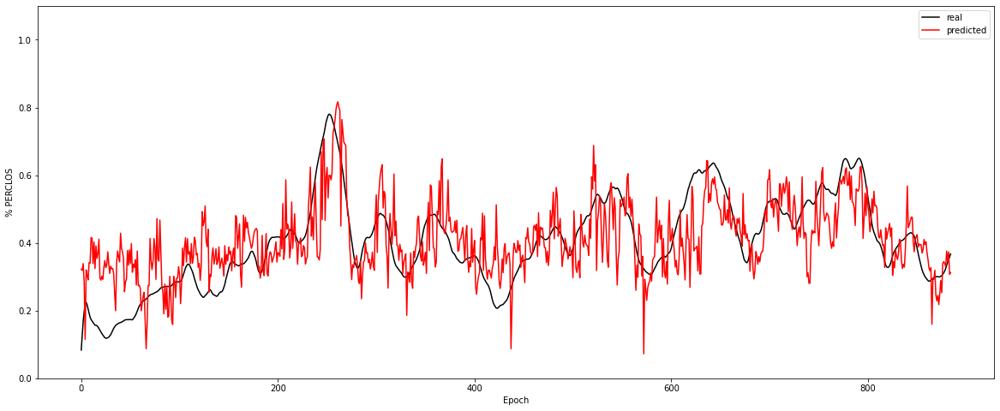

Experiment: 12_20150928_noon
	RMSE: 0.1350
	r^2: 0.8717


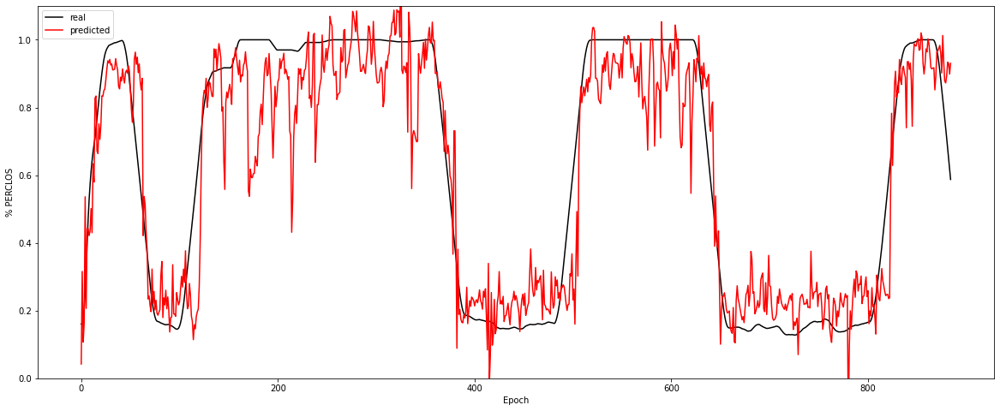

Experiment: 13_20150929_noon
	RMSE: 0.1522
	r^2: 0.4243


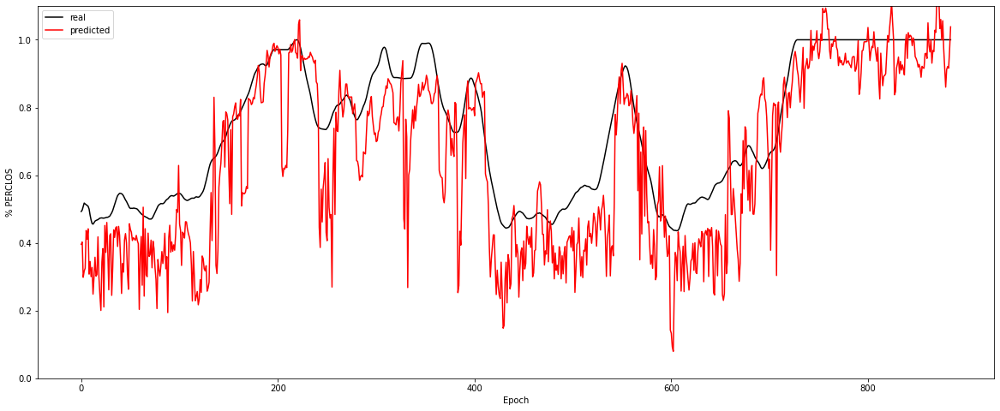

Experiment: 14_20151014_night
	RMSE: 0.1510
	r^2: 0.5620


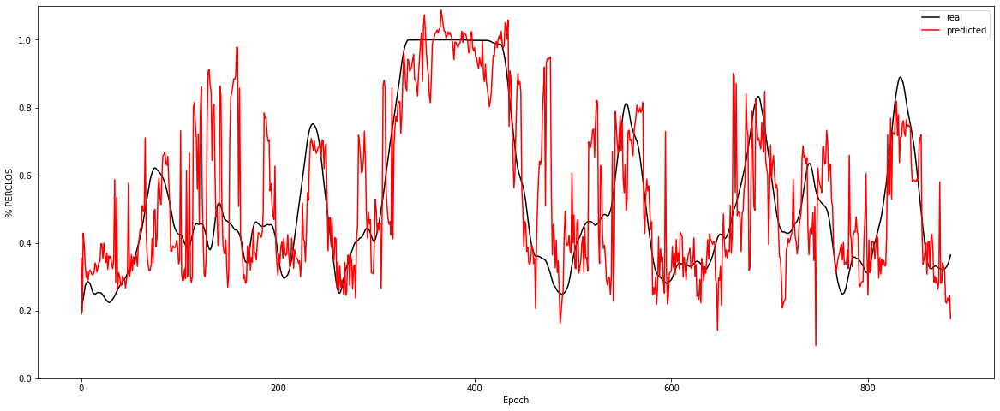

Experiment: 15_20151126_night
	RMSE: 0.1391
	r^2: 0.2760


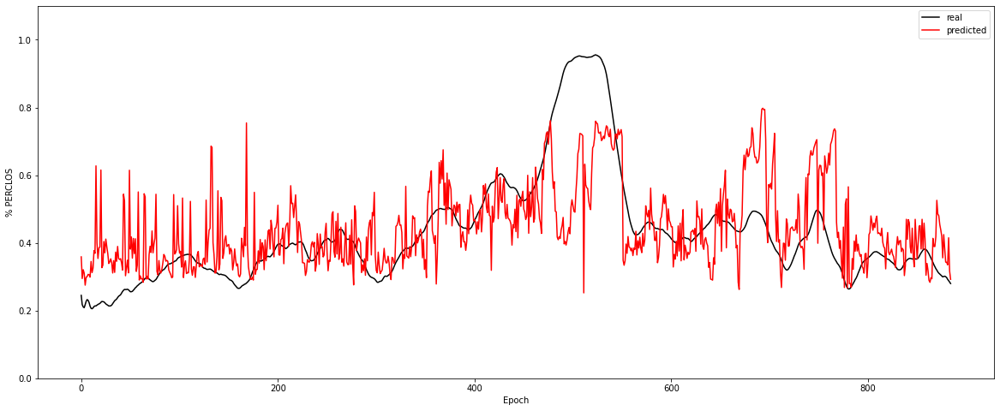

Experiment: 16_20151128_night
	RMSE: 0.3030
	r^2: 0.1215


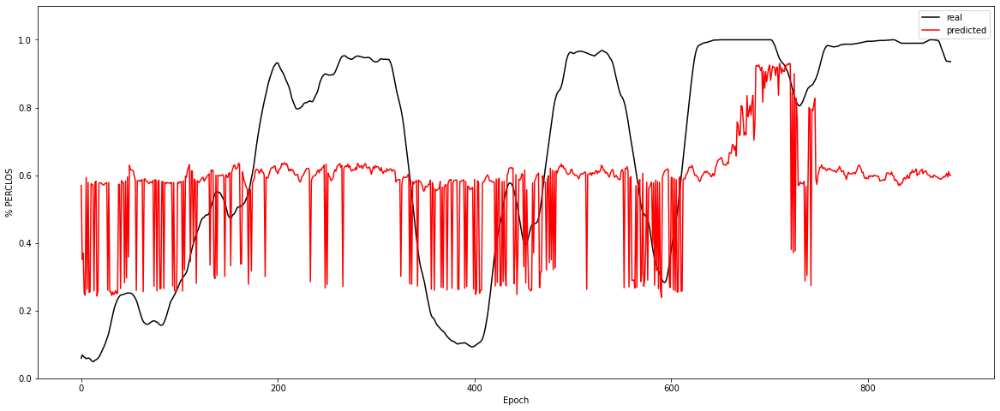

Experiment: 17_20150925_noon
	RMSE: 0.1095
	r^2: 0.6989


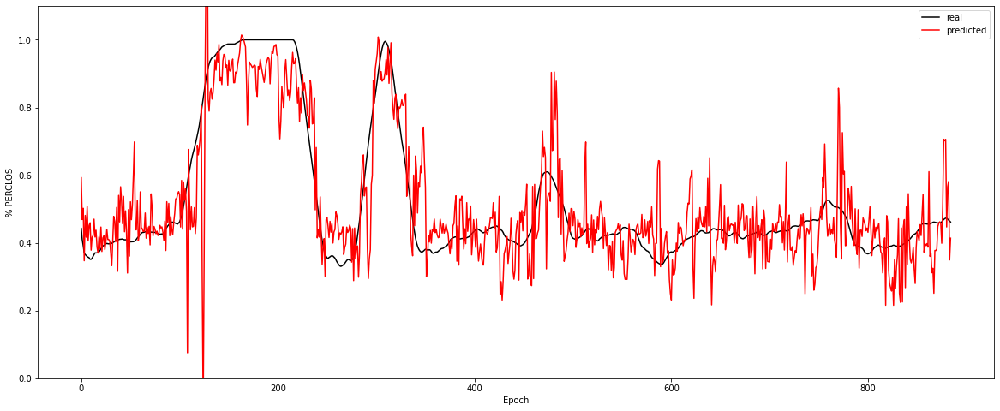

Experiment: 18_20150926_noon
	RMSE: 0.1587
	r^2: 0.7817


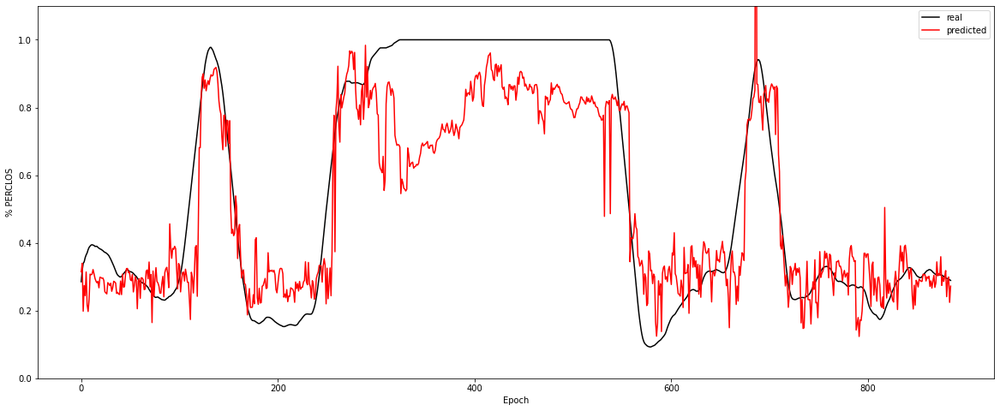

Experiment: 19_20151114_noon
	RMSE: 0.1360
	r^2: -0.3373


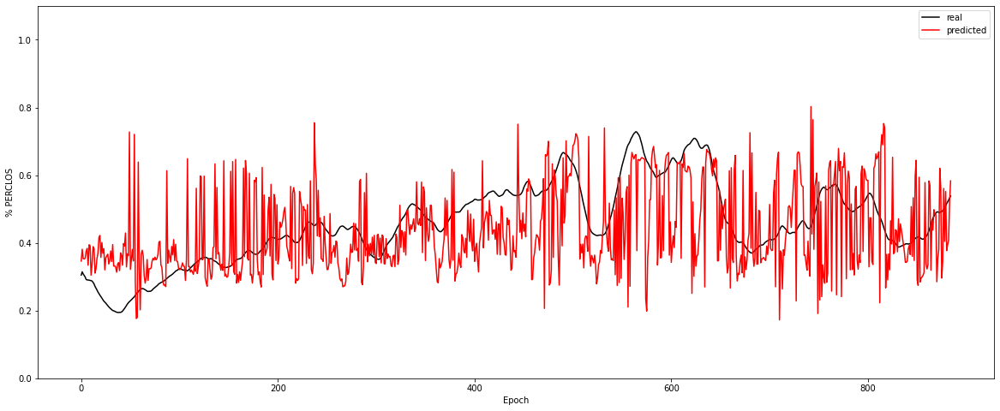

Experiment: 20_20151129_night
	RMSE: 0.3209
	r^2: 0.2018


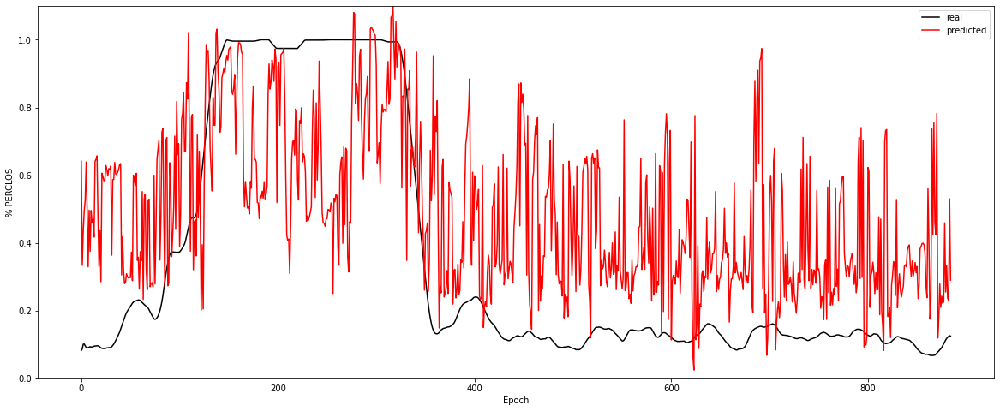

Experiment: 21_20151016_noon
	RMSE: 0.2012
	r^2: 0.6173


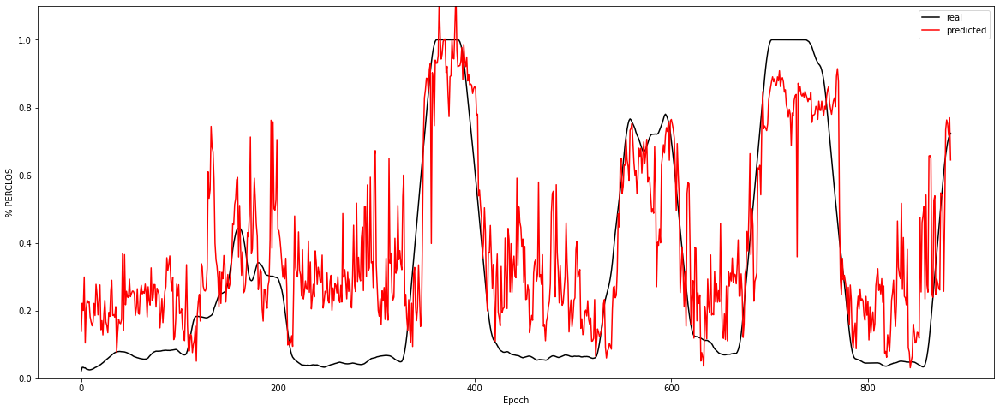

In [75]:
for key in X_all:
    data = X_all_eog[key]
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

## KNN

In [76]:
from sklearn.neighbors import KNeighborsRegressor

### KNN PSD

In [ ]:
print(f"Experiment: Modelo General KNN EEG")
model = KNeighborsRegressor(n_jobs=-1)

space = dict()
space['n_neighbors'] = randint(3, 25)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15, 45)
space['p'] = [1, 2]

general_model, rmse, r2 = find_and_test_best_model_reg(X, y, model, space, cv=10,  n_iter=15)

for key in X_all:   
    data, aux2 = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_minmax = scaler.fit_transform(data_minmax)
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### KNN PSD

In [77]:
print(f"Experiment: Modelo General KNN PSD")
model = KNeighborsRegressor(n_jobs=-1)

space = dict()
space['n_neighbors'] = randint(3, 25)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15, 45)
space['p'] = [1, 2]

general_model, rmse, r2 = find_and_test_best_model_reg(X, y, model, space, cv=10,  n_iter=15)

Experiment: Modelo General KNN PSD
Best Model:
	Score: 0.7397
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 35, 'n_neighbors': 11, 'p': 1, 'weights': 'distance'}

Results with X_test:
	RMSE: 0.1365
	r^2: 0.7477


Experiment: 1_20151124_noon_2
	RMSE: 0.0546
	r^2: 0.9639


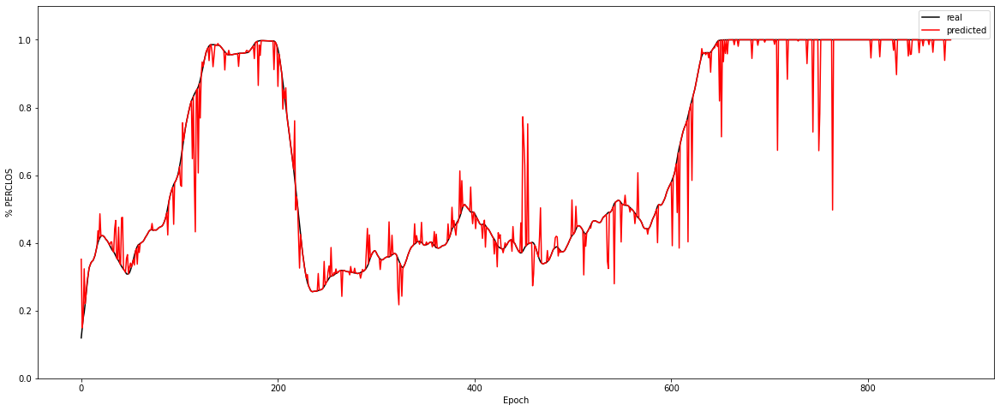

Experiment: 2_20151106_noon
	RMSE: 0.0449
	r^2: 0.9248


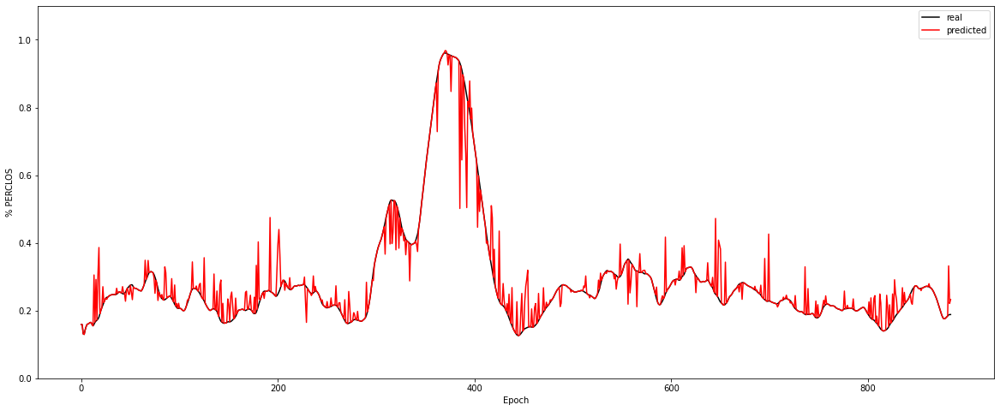

Experiment: 3_20151024_noon
	RMSE: 0.0623
	r^2: 0.8539


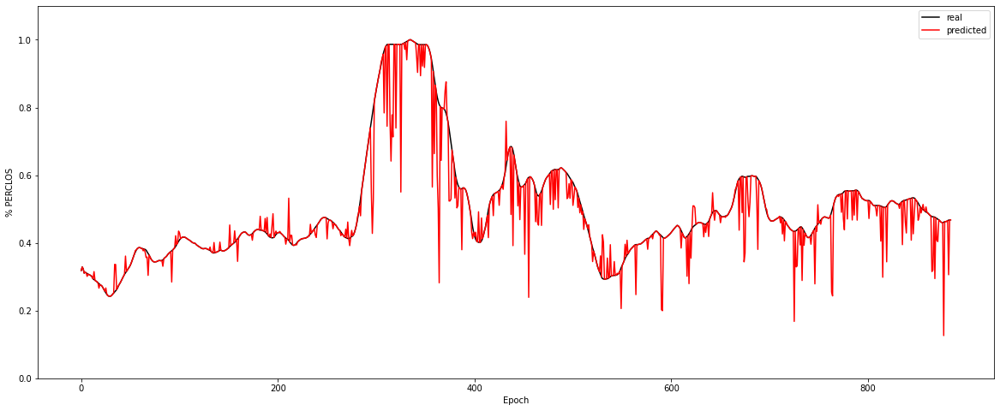

Experiment: 4_20151105_noon
	RMSE: 0.0900
	r^2: 0.7849


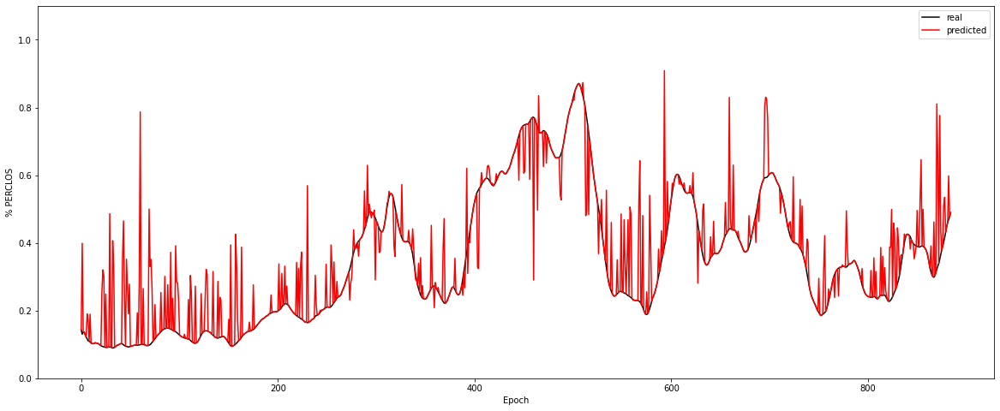

Experiment: 4_20151107_noon
	RMSE: 0.0681
	r^2: 0.9176


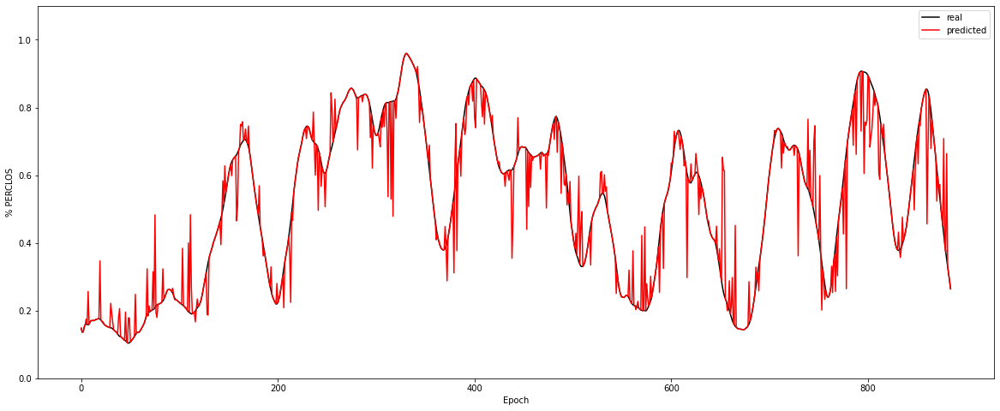

Experiment: 5_20141108_noon
	RMSE: 0.0792
	r^2: 0.9416


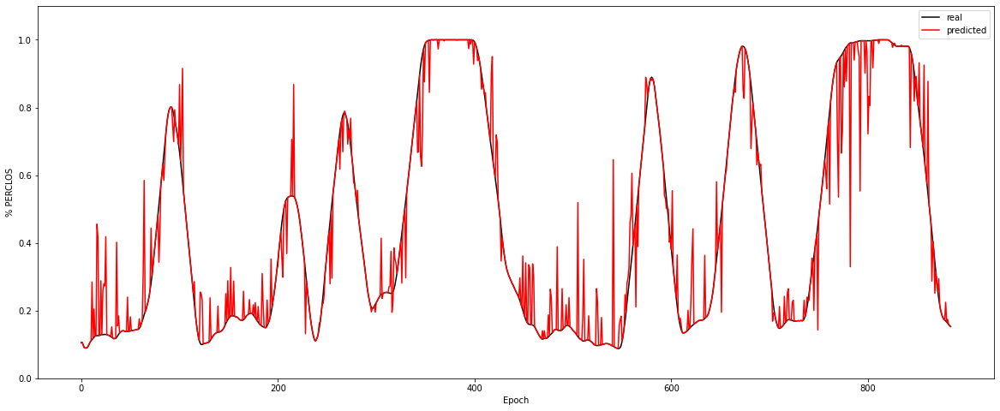

Experiment: 5_20151012_night
	RMSE: 0.0767
	r^2: 0.9191


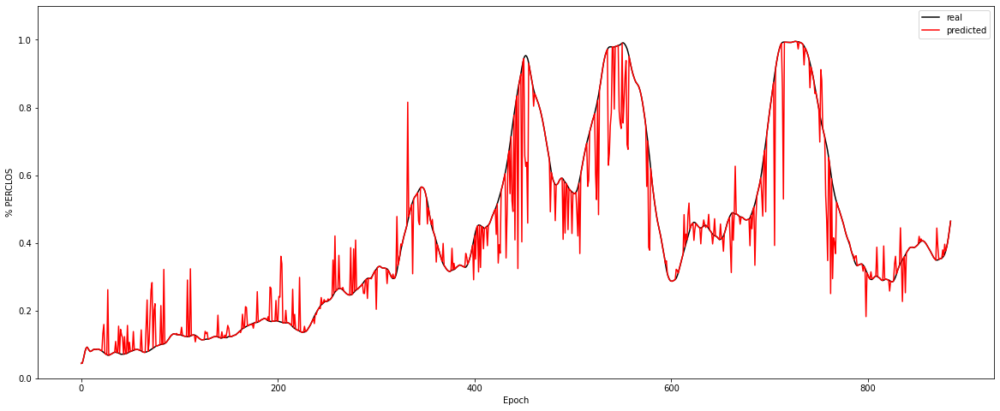

Experiment: 6_20151121_noon
	RMSE: 0.0549
	r^2: 0.8110


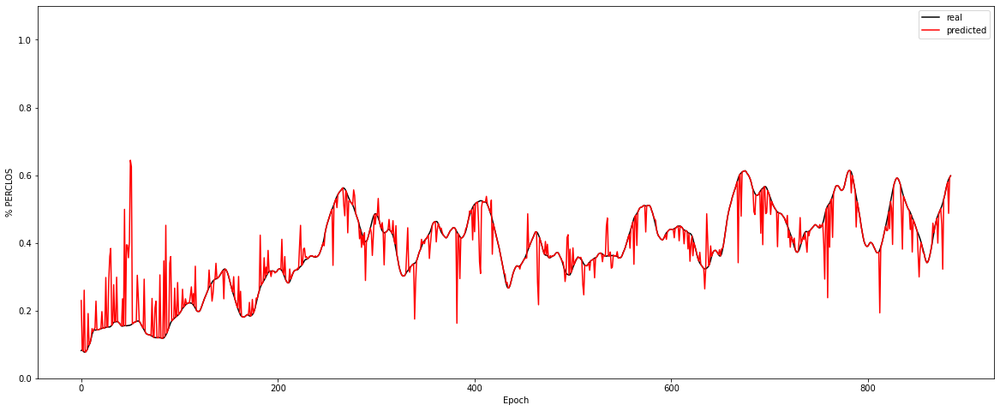

Experiment: 7_20151015_night
	RMSE: 0.0316
	r^2: 0.9244


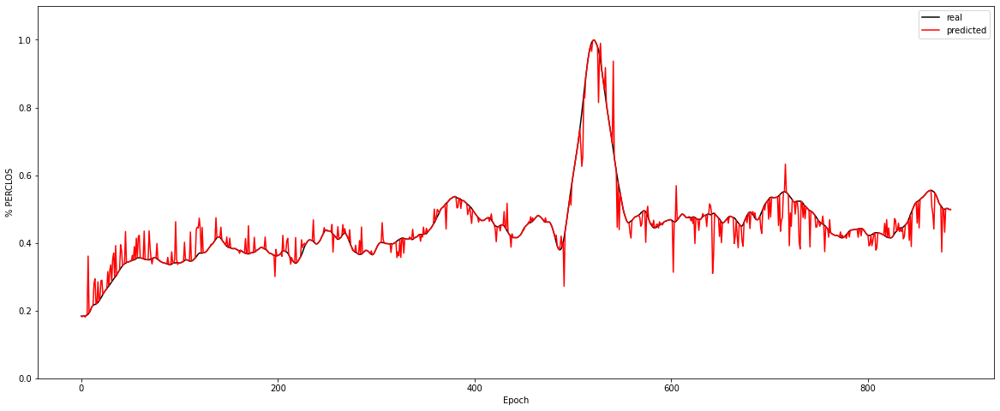

Experiment: 8_20151022_noon
	RMSE: 0.0288
	r^2: 0.9856


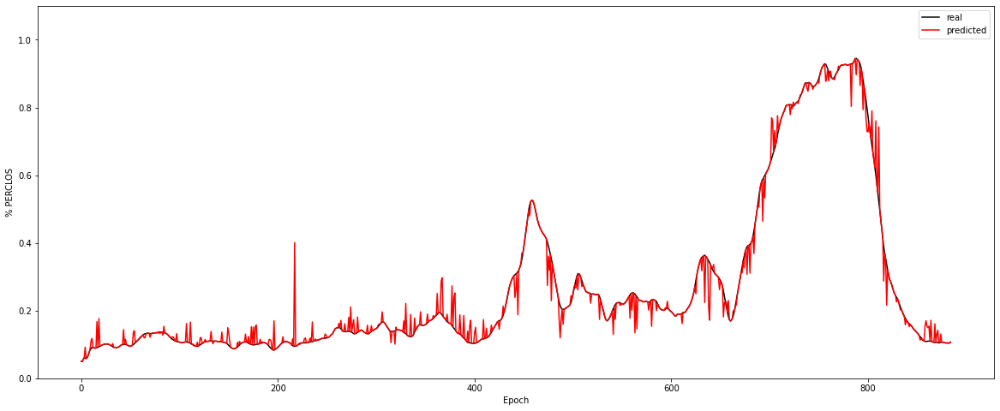

Experiment: 9_20151017_night
	RMSE: 0.0552
	r^2: 0.7961


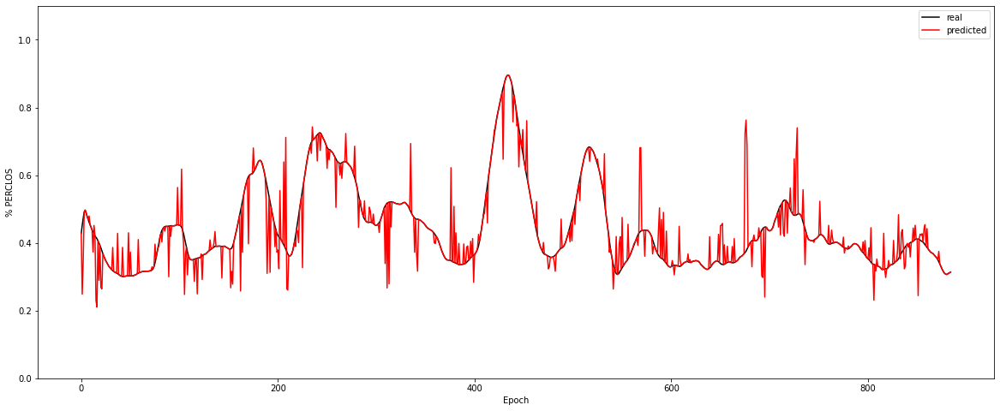

Experiment: 10_20151125_noon
	RMSE: 0.0537
	r^2: 0.8641


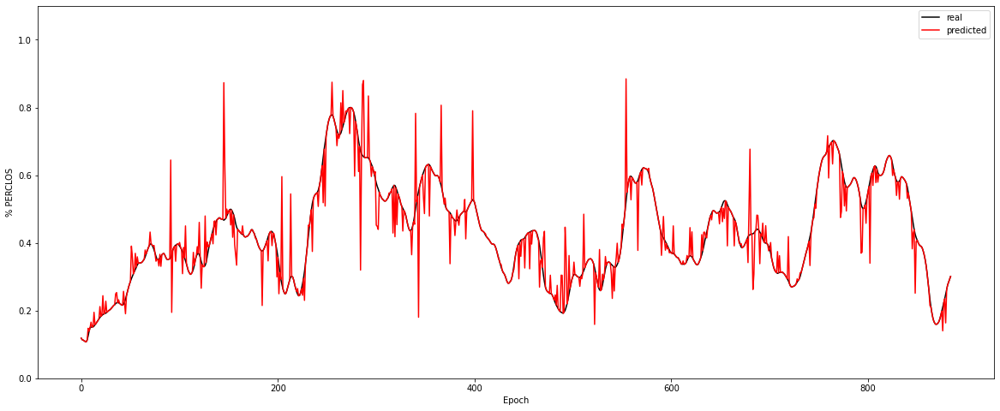

Experiment: 11_20151024_night
	RMSE: 0.0468
	r^2: 0.8740


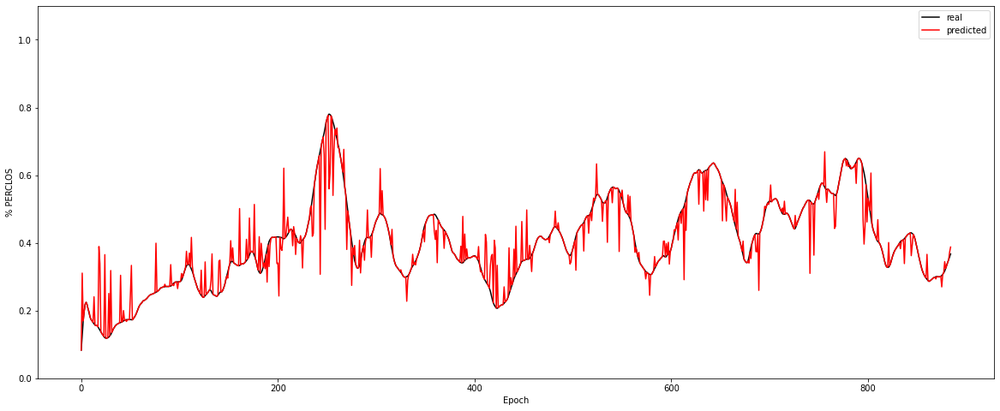

Experiment: 12_20150928_noon
	RMSE: 0.0859
	r^2: 0.9481


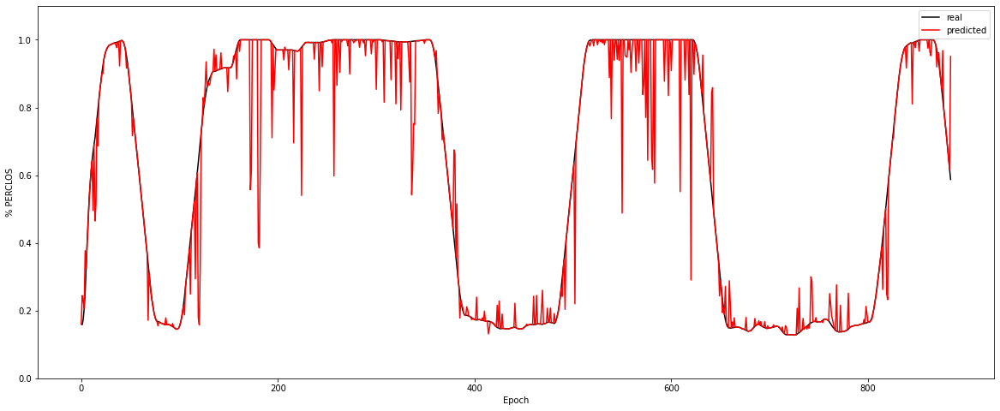

Experiment: 13_20150929_noon
	RMSE: 0.0777
	r^2: 0.8501


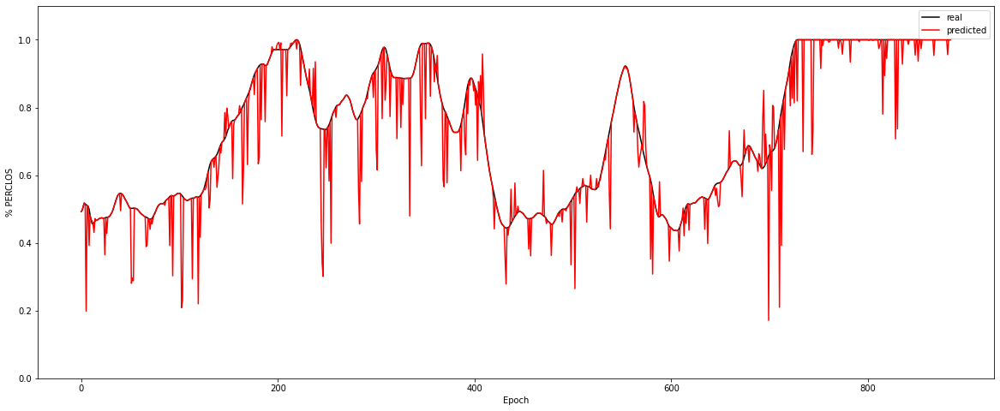

Experiment: 14_20151014_night
	RMSE: 0.0772
	r^2: 0.8854


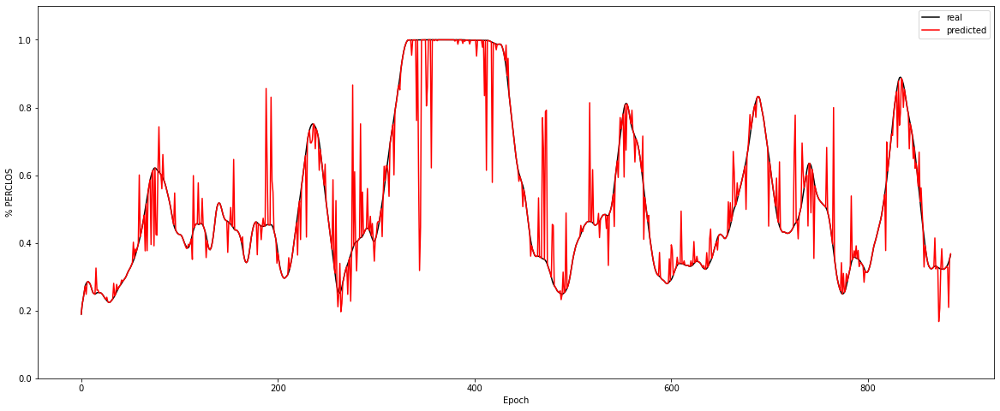

Experiment: 15_20151126_night
	RMSE: 0.0569
	r^2: 0.8790


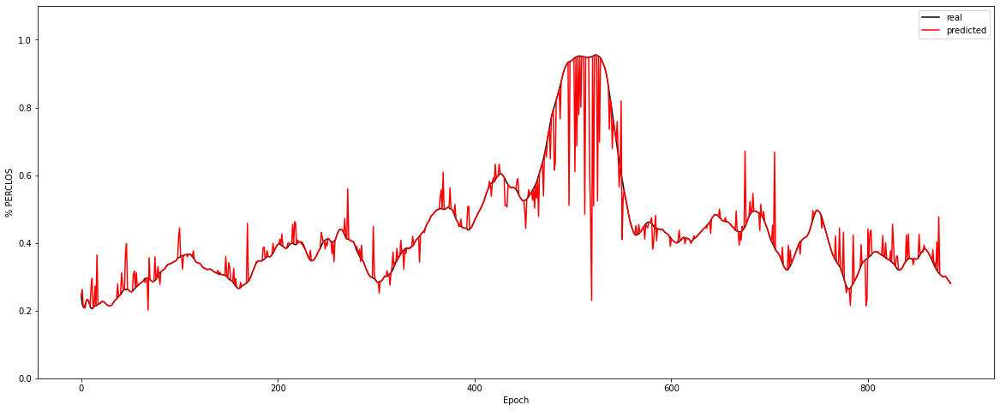

Experiment: 16_20151128_night
	RMSE: 0.0715
	r^2: 0.9511


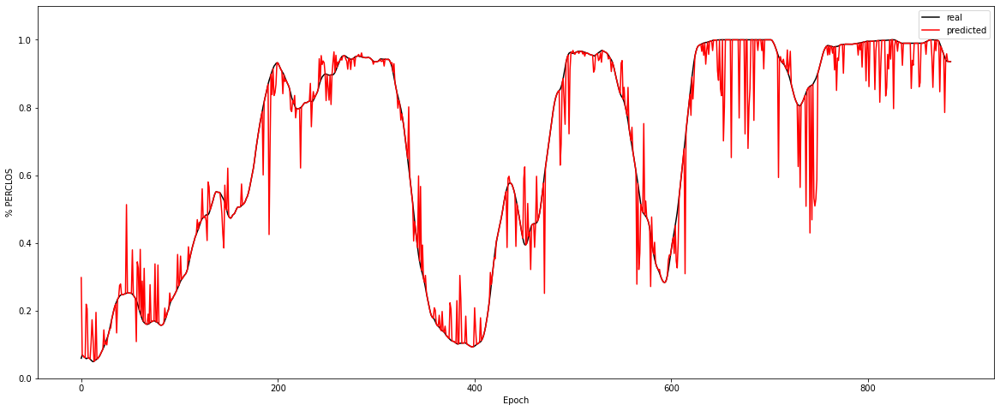

Experiment: 17_20150925_noon
	RMSE: 0.0526
	r^2: 0.9304


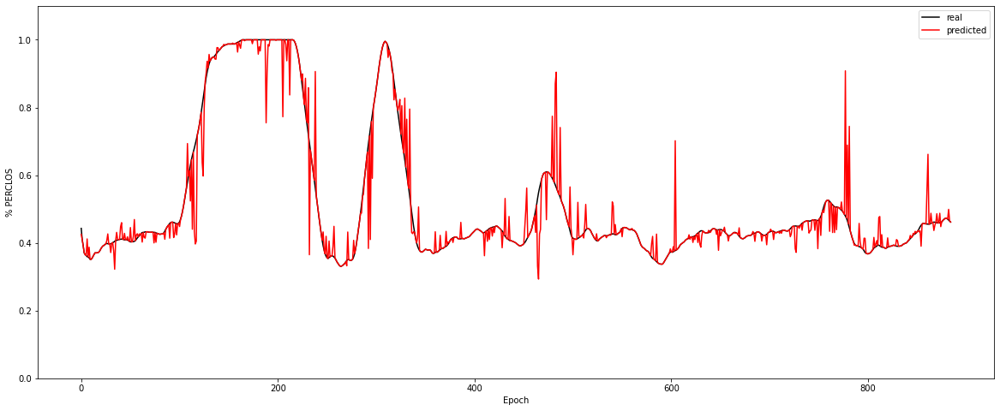

Experiment: 18_20150926_noon
	RMSE: 0.0440
	r^2: 0.9832


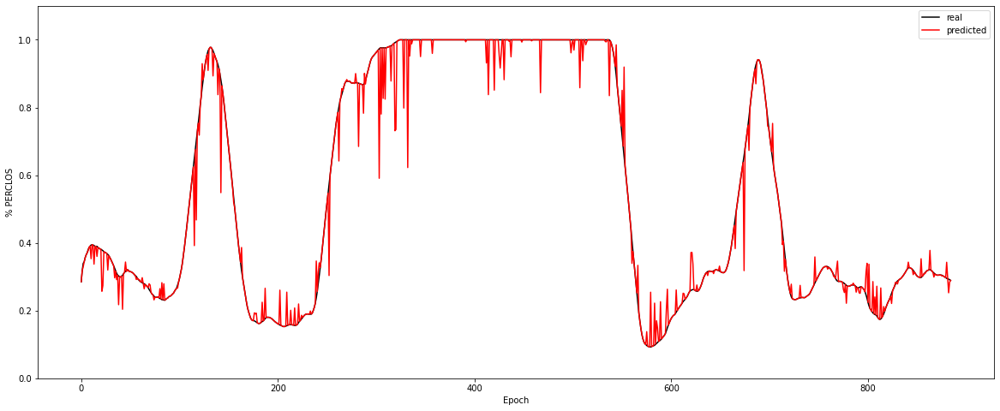

Experiment: 19_20151114_noon
	RMSE: 0.0675
	r^2: 0.6709


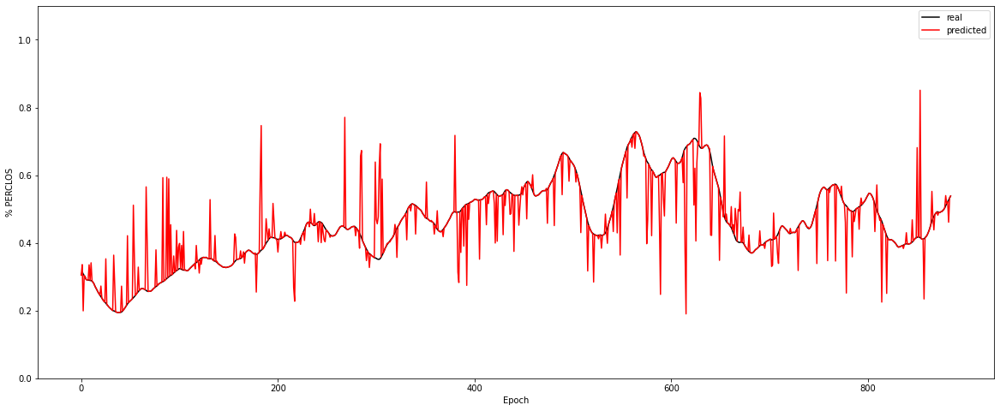

Experiment: 20_20151129_night
	RMSE: 0.1295
	r^2: 0.8701


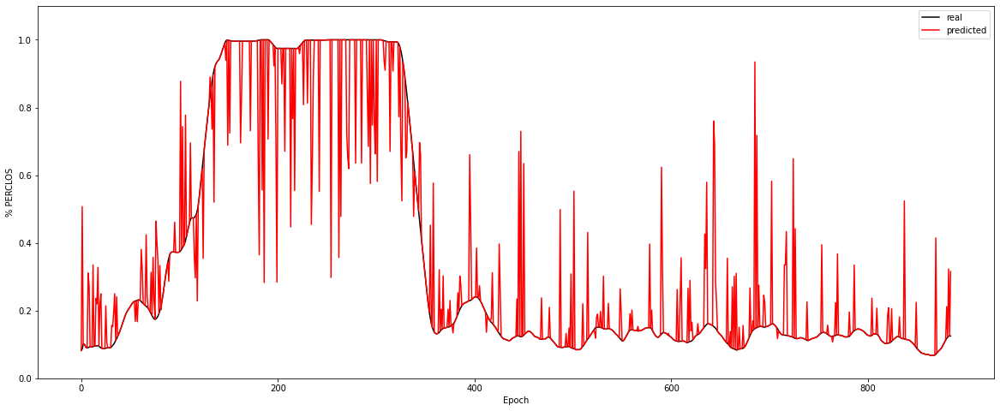

Experiment: 21_20151016_noon
	RMSE: 0.0817
	r^2: 0.9369


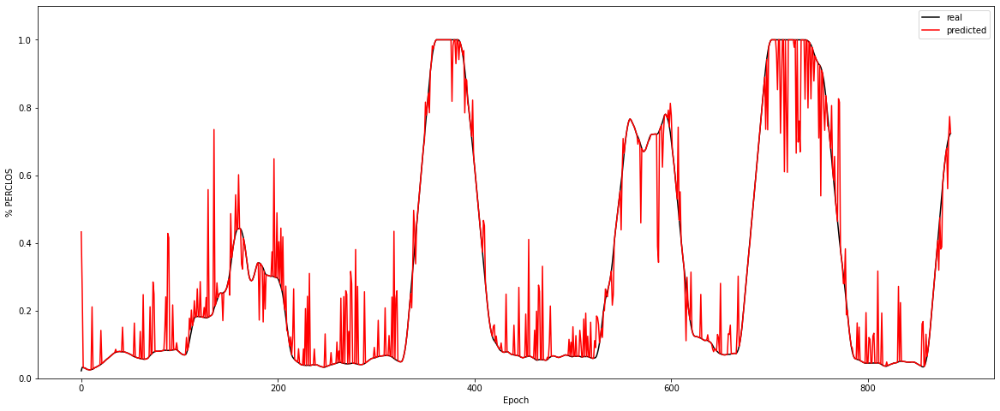

In [78]:
for key in X_all:
    data = X_all[key]
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### KNN PSD + EOG

In [79]:
print(f"Experiment: Modelo General KNN PSD + EOG")
model = KNeighborsRegressor(n_jobs=-1)

space = dict()
space['n_neighbors'] = randint(3, 25)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15, 45)
space['p'] = [1, 2]

general_model, rmse, r2 = find_and_test_best_model_reg(X_eog, y, model, space, cv=10,  n_iter=25)

Experiment: Modelo General KNN PSD + EOG
Best Model:
	Score: 0.7402
	Hyperparameters: {'algorithm': 'brute', 'leaf_size': 39, 'n_neighbors': 10, 'p': 1, 'weights': 'distance'}

Results with X_test:
	RMSE: 0.1354
	r^2: 0.7515


Experiment: 1_20151124_noon_2
	RMSE: 0.0577
	r^2: 0.9597


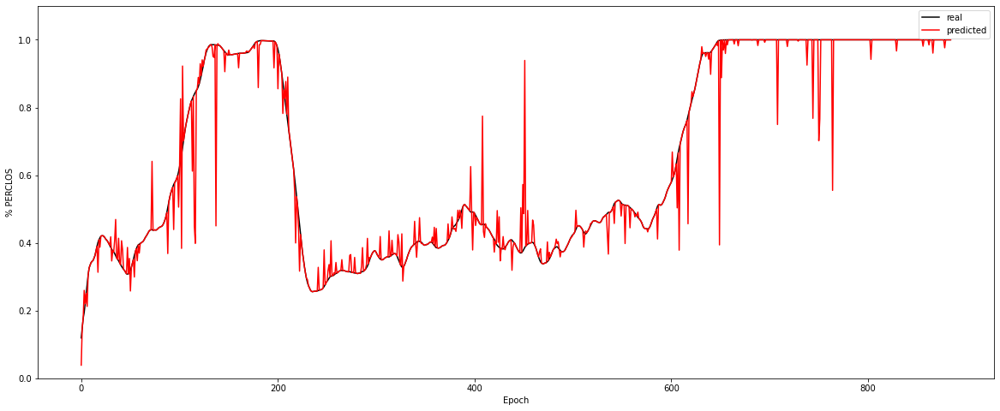

Experiment: 2_20151106_noon
	RMSE: 0.0489
	r^2: 0.9107


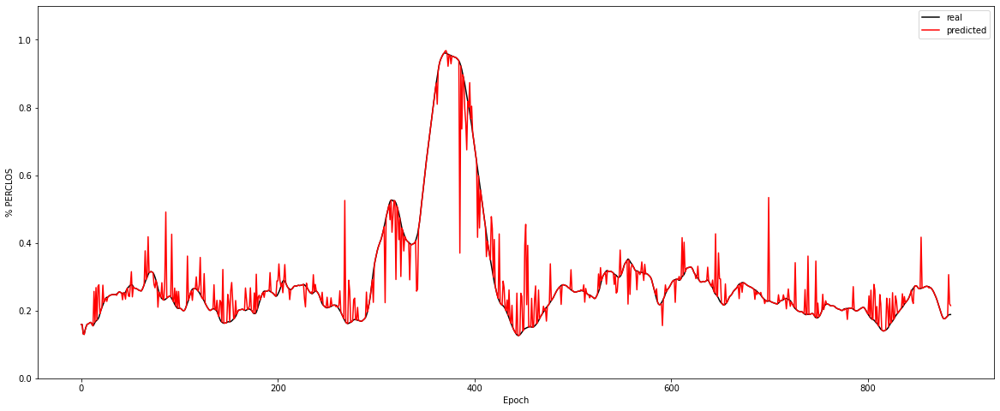

Experiment: 3_20151024_noon
	RMSE: 0.0631
	r^2: 0.8501


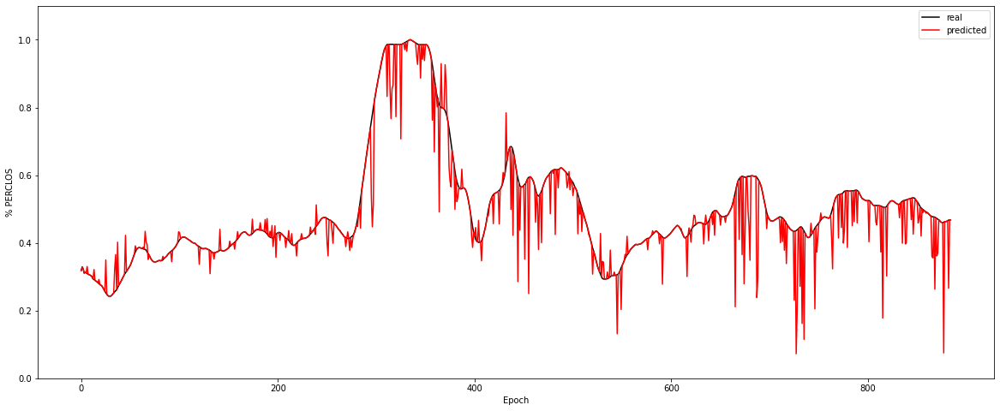

Experiment: 4_20151105_noon
	RMSE: 0.0883
	r^2: 0.7930


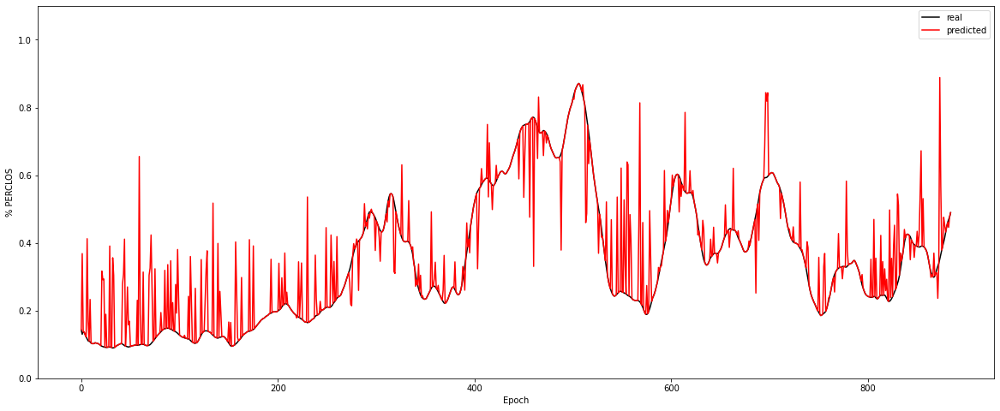

Experiment: 4_20151107_noon
	RMSE: 0.0739
	r^2: 0.9030


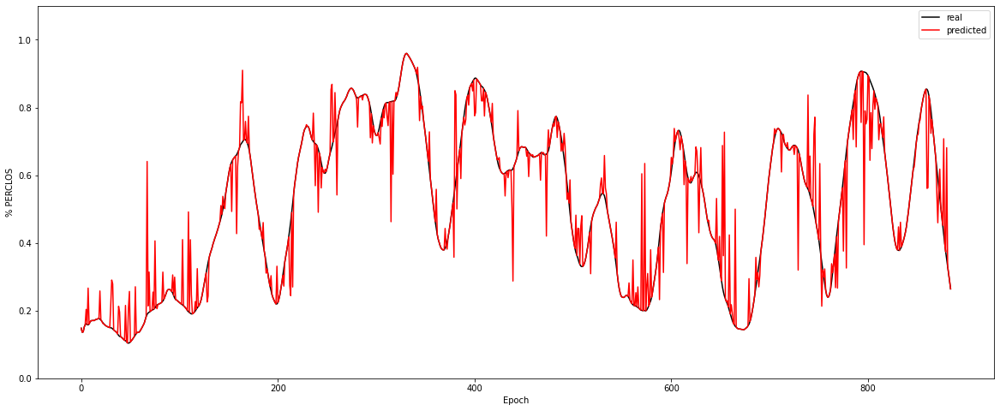

Experiment: 5_20141108_noon
	RMSE: 0.0761
	r^2: 0.9461


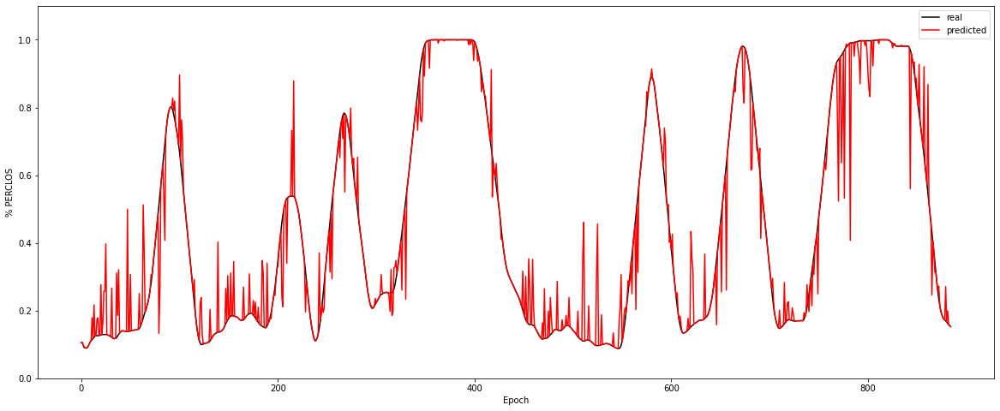

Experiment: 5_20151012_night
	RMSE: 0.0852
	r^2: 0.9000


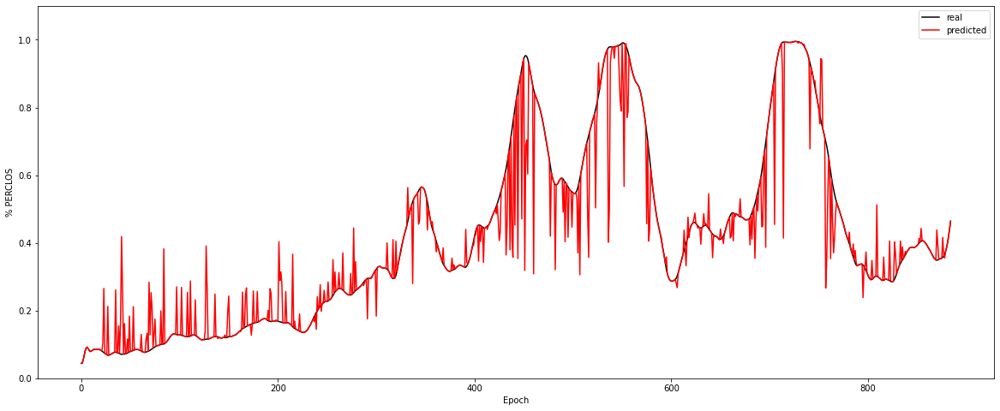

Experiment: 6_20151121_noon
	RMSE: 0.0811
	r^2: 0.5878


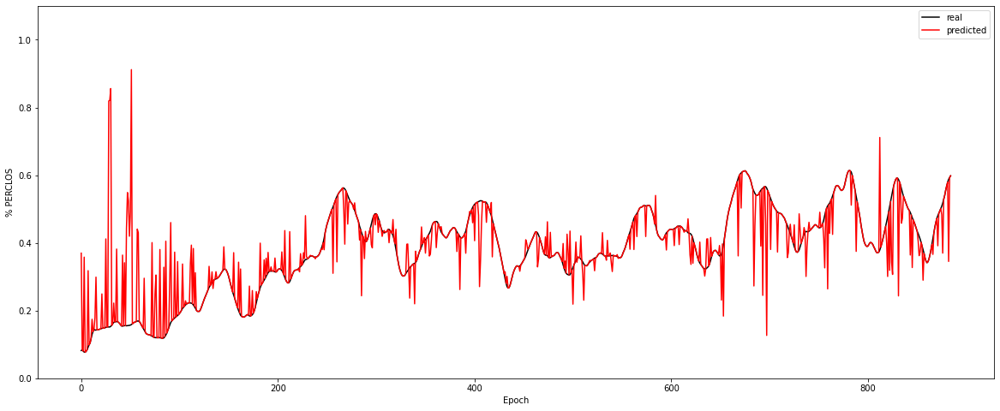

Experiment: 7_20151015_night
	RMSE: 0.0313
	r^2: 0.9256


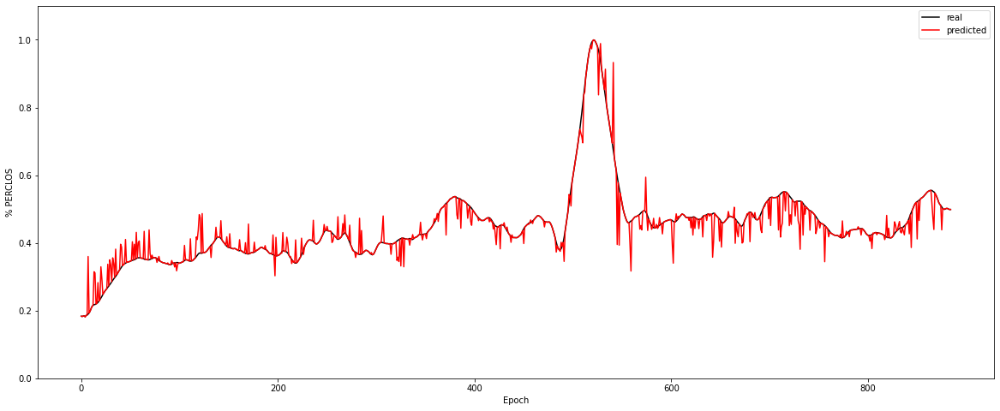

Experiment: 8_20151022_noon
	RMSE: 0.0419
	r^2: 0.9695


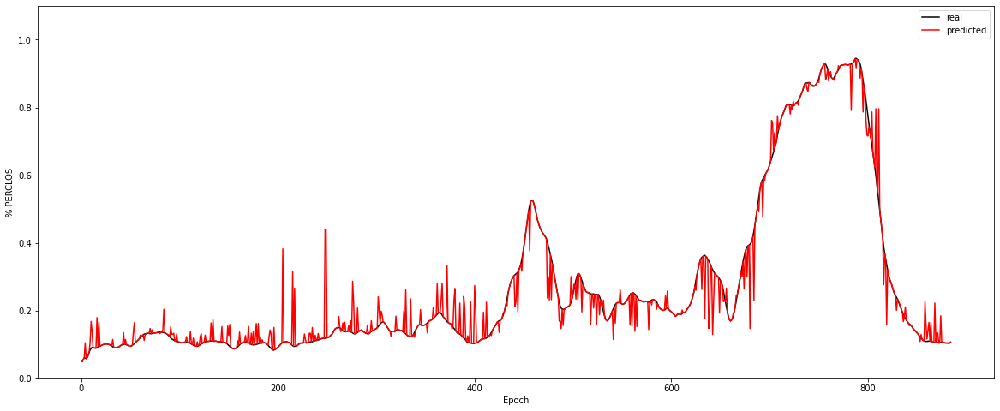

Experiment: 9_20151017_night
	RMSE: 0.0452
	r^2: 0.8630


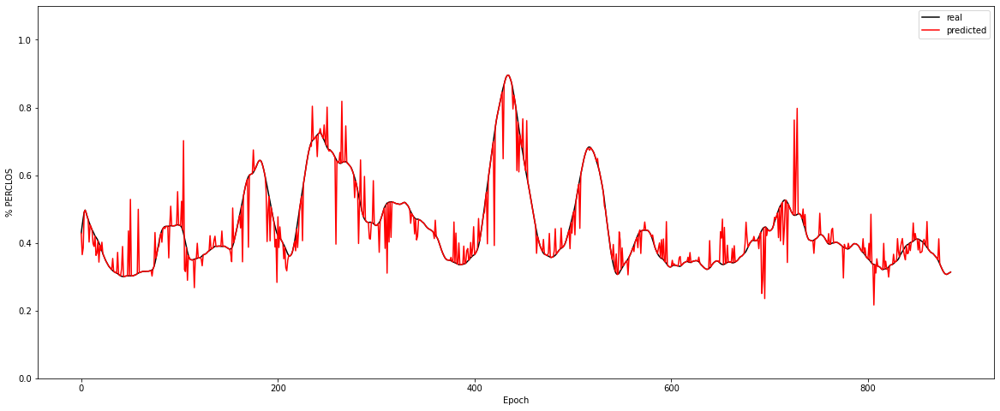

Experiment: 10_20151125_noon
	RMSE: 0.0674
	r^2: 0.7859


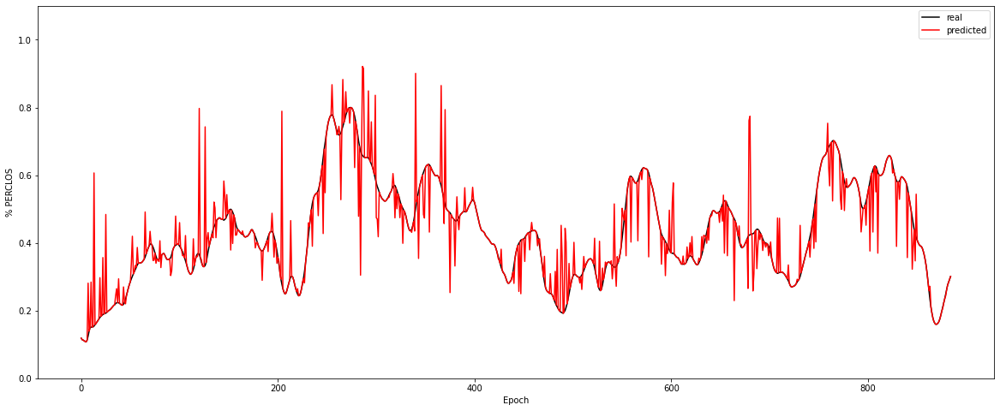

Experiment: 11_20151024_night
	RMSE: 0.0473
	r^2: 0.8713


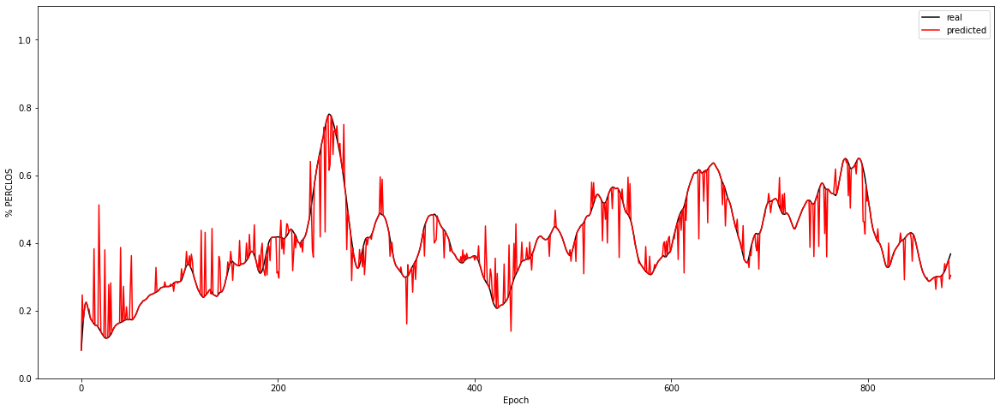

Experiment: 12_20150928_noon
	RMSE: 0.0649
	r^2: 0.9703


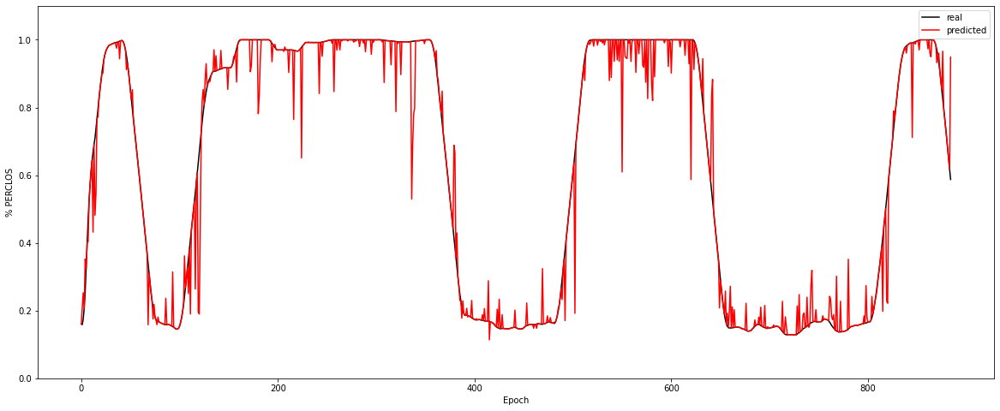

Experiment: 13_20150929_noon
	RMSE: 0.0640
	r^2: 0.8982


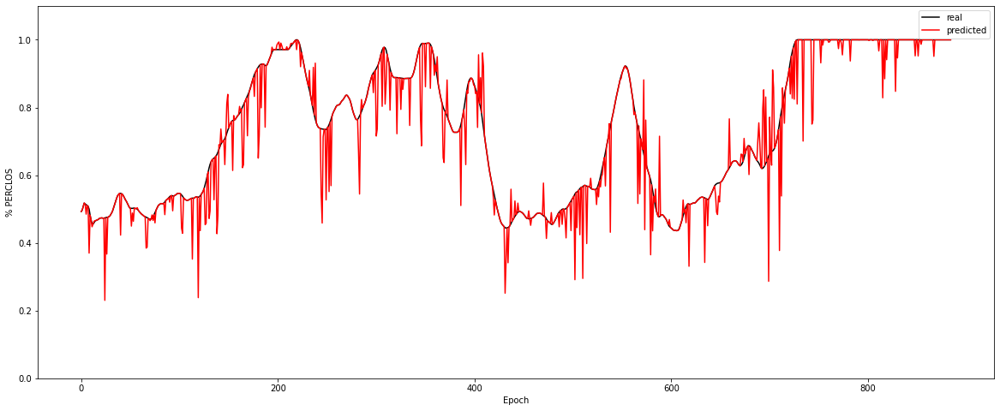

Experiment: 14_20151014_night
	RMSE: 0.0697
	r^2: 0.9067


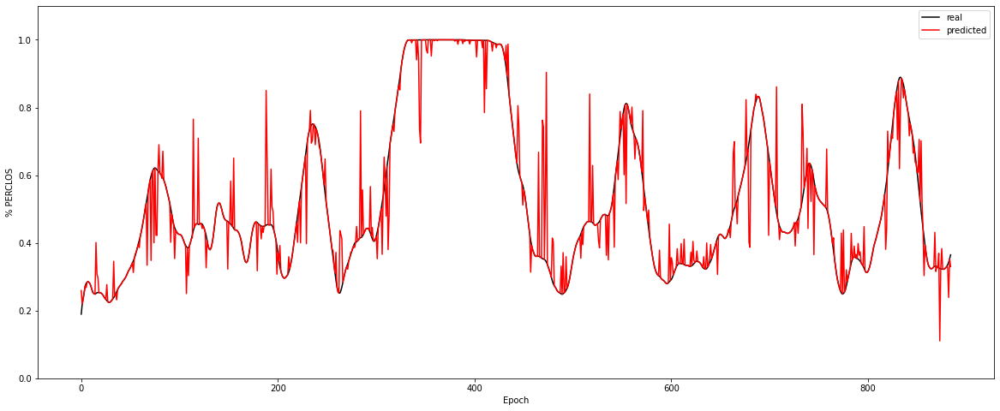

Experiment: 15_20151126_night
	RMSE: 0.0556
	r^2: 0.8843


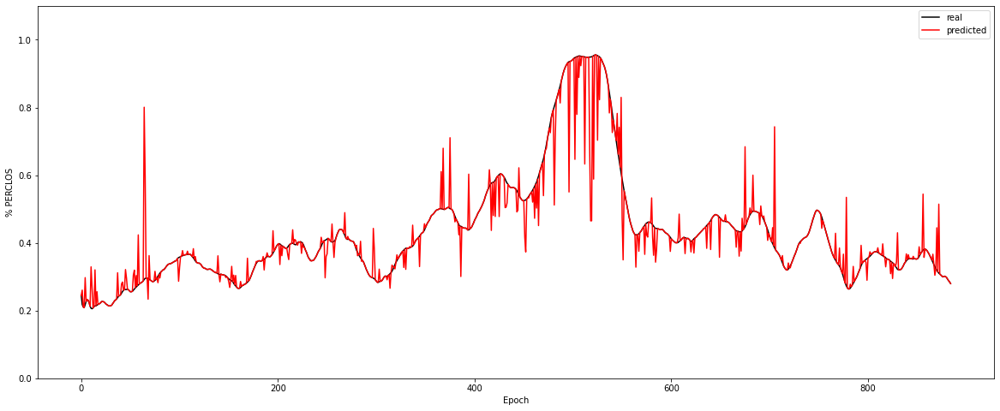

Experiment: 16_20151128_night
	RMSE: 0.0633
	r^2: 0.9617


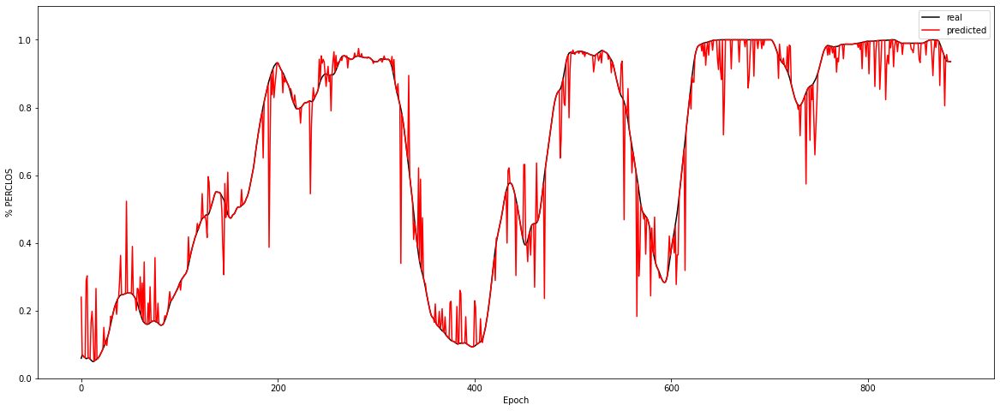

Experiment: 17_20150925_noon
	RMSE: 0.0498
	r^2: 0.9377


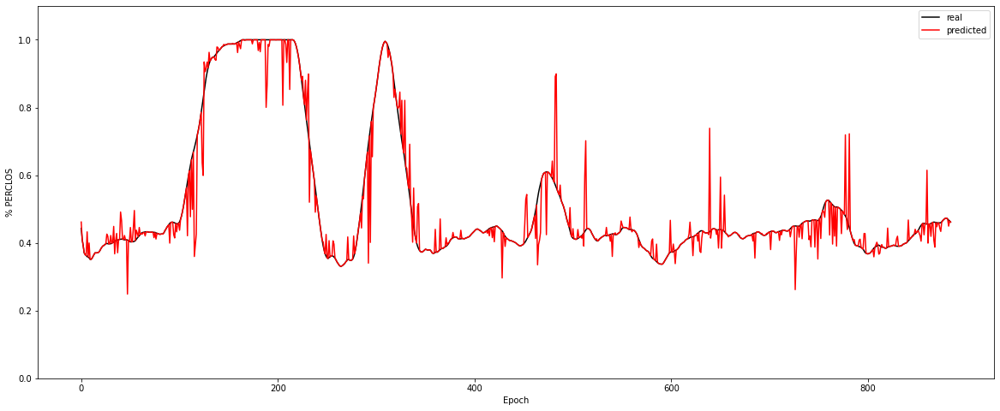

Experiment: 18_20150926_noon
	RMSE: 0.0452
	r^2: 0.9823


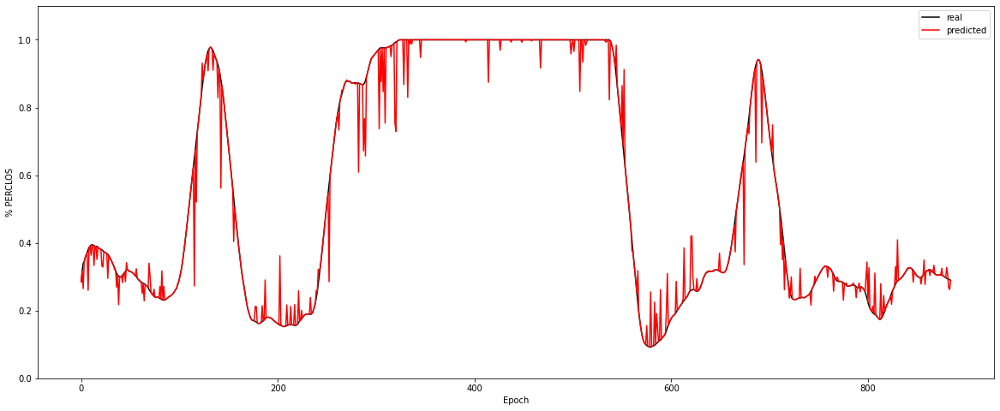

Experiment: 19_20151114_noon
	RMSE: 0.0643
	r^2: 0.7008


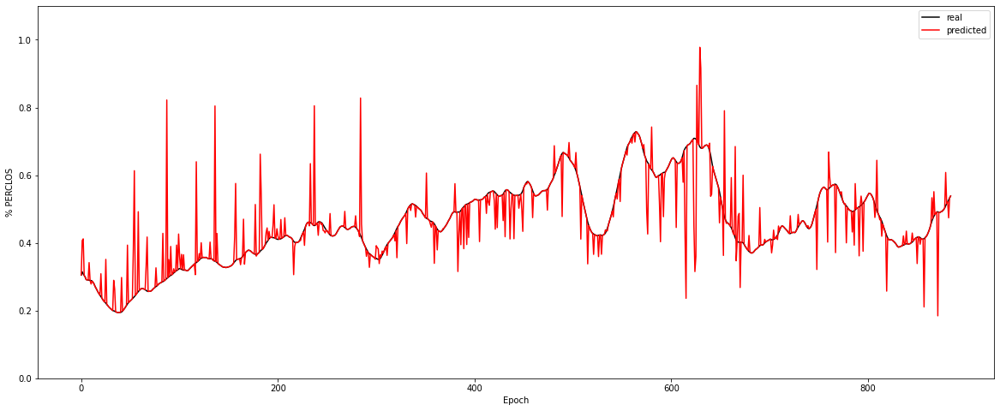

Experiment: 20_20151129_night
	RMSE: 0.1262
	r^2: 0.8766


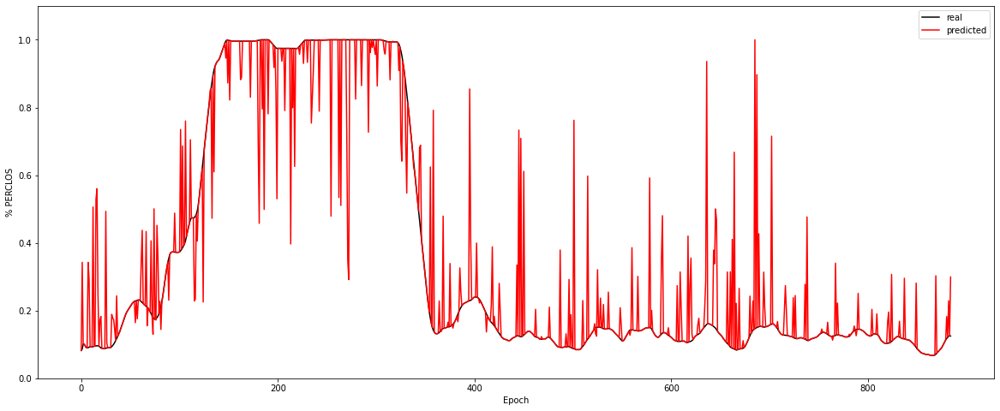

Experiment: 21_20151016_noon
	RMSE: 0.0806
	r^2: 0.9385


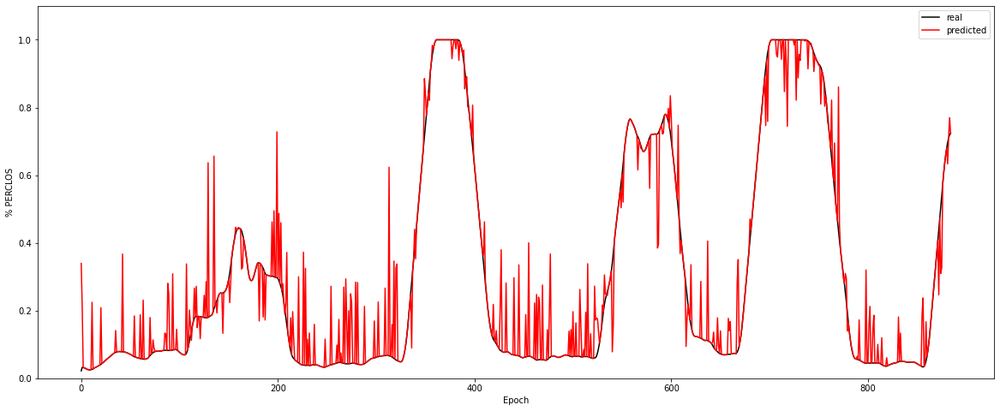

In [80]:
for key in X_all:
    data = X_all_eog[key]
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

## Decision Tree

In [81]:
from sklearn.tree import DecisionTreeRegressor

### Decision tree EEG

In [ ]:
print(f"Experiment: Modelo General Decision Tree EEG")
model = DecisionTreeRegressor(random_state=42)

space = dict()
space['criterion'] = ['mse', 'friedman_mse']
space['splitter'] = ["best", "random"]
space['max_depth'] = [None]
space['min_samples_split'] = [2]
space['min_samples_leaf'] = [1]
space['max_features'] = ["auto", "sqrt", "log2"]

general_model, rmse, r2 = find_and_test_best_model_reg(X, y, model, space, cv=10,  n_iter=100)

attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = general_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

for key in X_all:   
    data, aux2 = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_minmax = scaler.fit_transform(data_minmax)
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### Decision tree PSD

In [82]:
print(f"Experiment: Modelo General Decision Tree PSD")
model = DecisionTreeRegressor(random_state=42)

space = dict()
space['criterion'] = ['mse', 'friedman_mse']
space['splitter'] = ["best", "random"]
space['max_depth'] = [None]
space['min_samples_split'] = [2]
space['min_samples_leaf'] = [1]
space['max_features'] = ["auto", "sqrt", "log2"]

general_model, rmse, r2 = find_and_test_best_model_reg(X, y, model, space, cv=10,  n_iter=100)

Experiment: Modelo General Decision Tree PSD


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:289: UserWarning: The total space of parameters 12 is smaller than n_iter=100. Running 12 iterations. For exhaustive searches, use GridSearchCV.
  % (grid_size, self.n_iter, grid_size), UserWarning)


Best Model:
	Score: 0.5710
	Hyperparameters: {'splitter': 'best', 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'auto', 'max_depth': None, 'criterion': 'mse'}

Results with X_test:
	RMSE: 0.1767
	r^2: 0.5773


In [83]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = general_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_gamma: 0.2904
psd_alpha: 0.2506
psd_theta: 0.1791
psd_delta: 0.1711
psd_betha: 0.1088


Experiment: 1_20151124_noon_2
	RMSE: 0.0754
	r^2: 0.9311


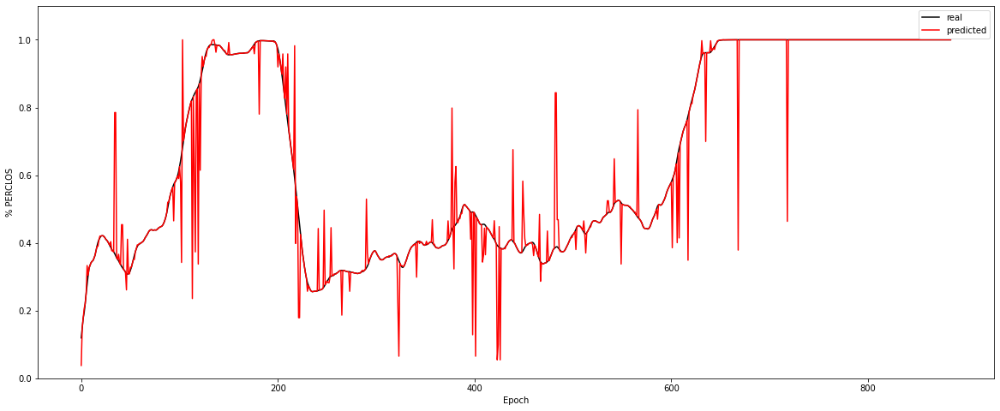

Experiment: 2_20151106_noon
	RMSE: 0.0758
	r^2: 0.7854


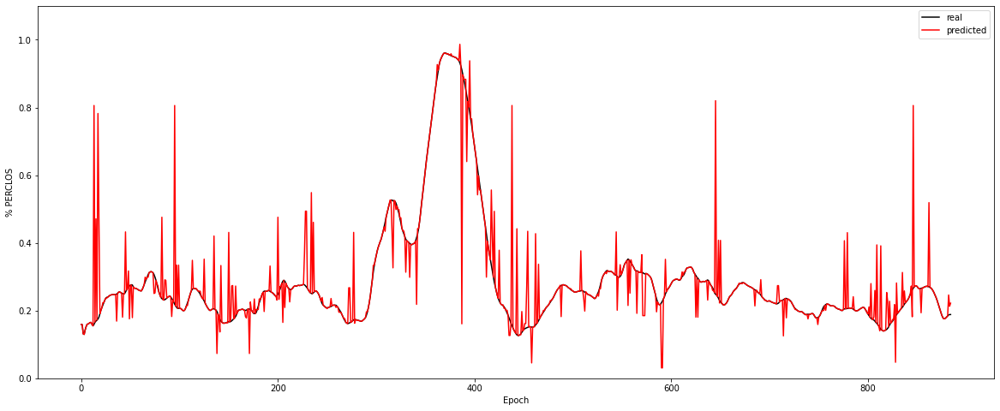

Experiment: 3_20151024_noon
	RMSE: 0.0835
	r^2: 0.7372


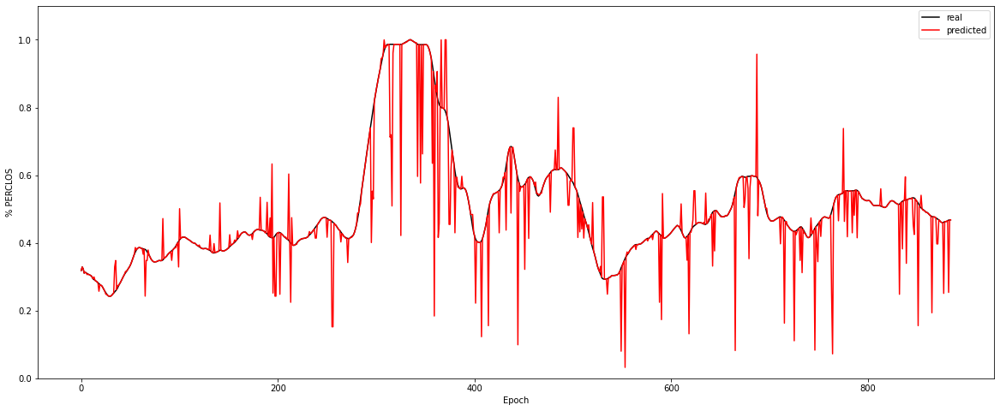

Experiment: 4_20151105_noon
	RMSE: 0.1090
	r^2: 0.6844


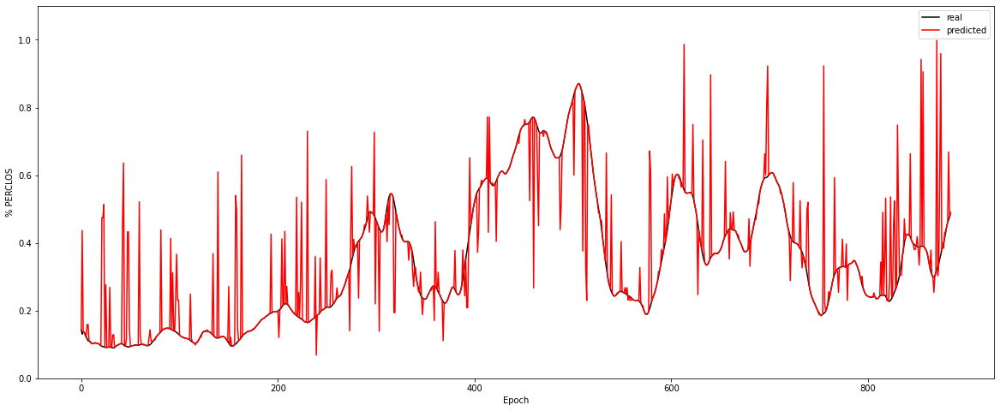

Experiment: 4_20151107_noon
	RMSE: 0.0913
	r^2: 0.8521


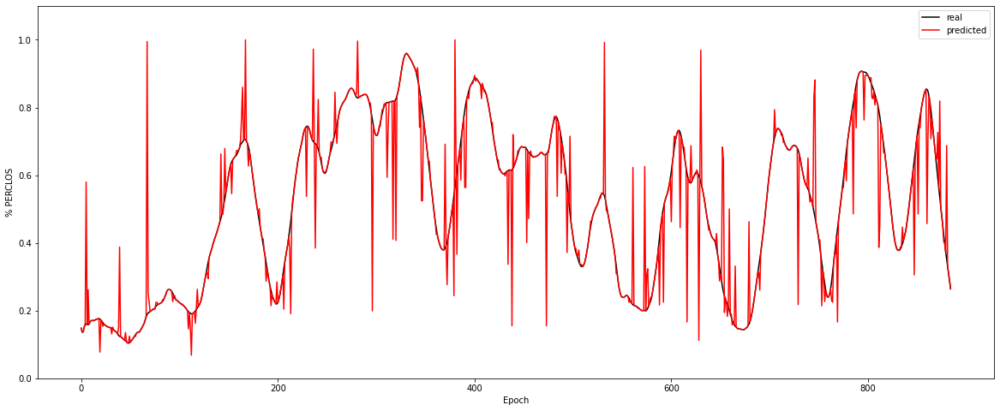

Experiment: 5_20141108_noon
	RMSE: 0.1092
	r^2: 0.8889


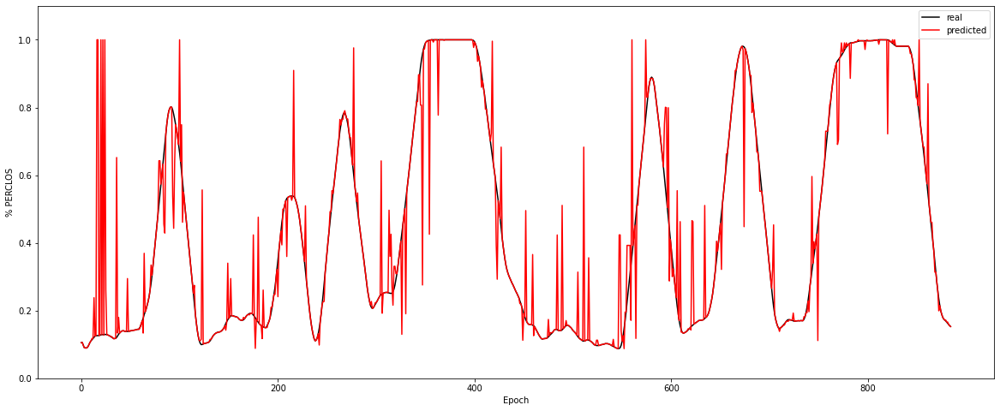

Experiment: 5_20151012_night
	RMSE: 0.0938
	r^2: 0.8789


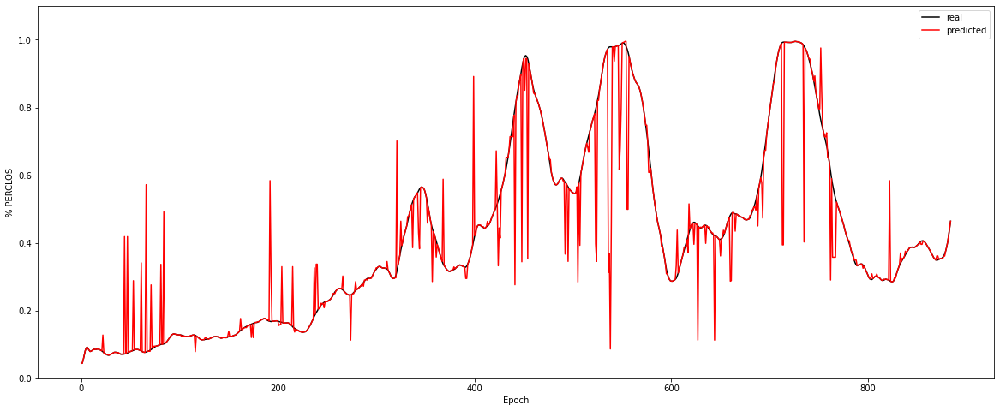

Experiment: 6_20151121_noon
	RMSE: 0.0748
	r^2: 0.6495


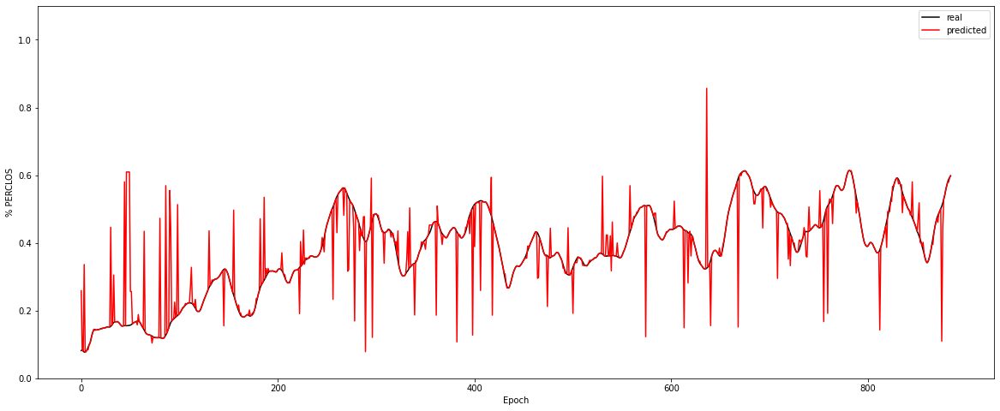

Experiment: 7_20151015_night
	RMSE: 0.0549
	r^2: 0.7713


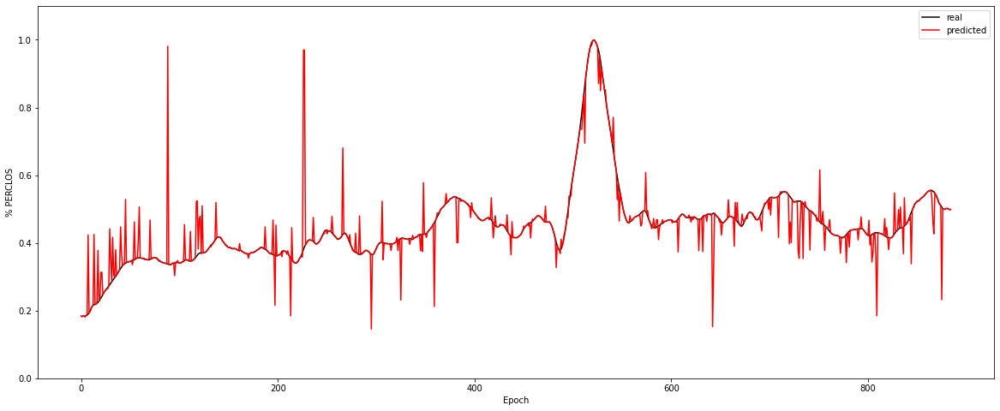

Experiment: 8_20151022_noon
	RMSE: 0.0368
	r^2: 0.9764


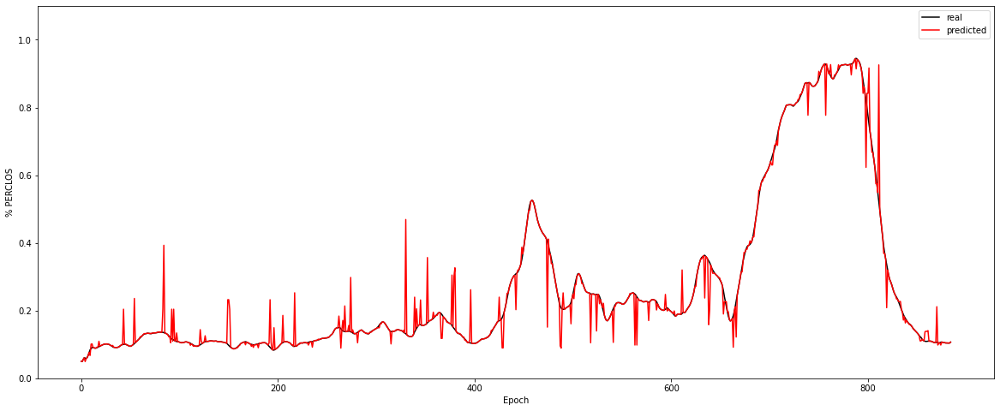

Experiment: 9_20151017_night
	RMSE: 0.0823
	r^2: 0.5466


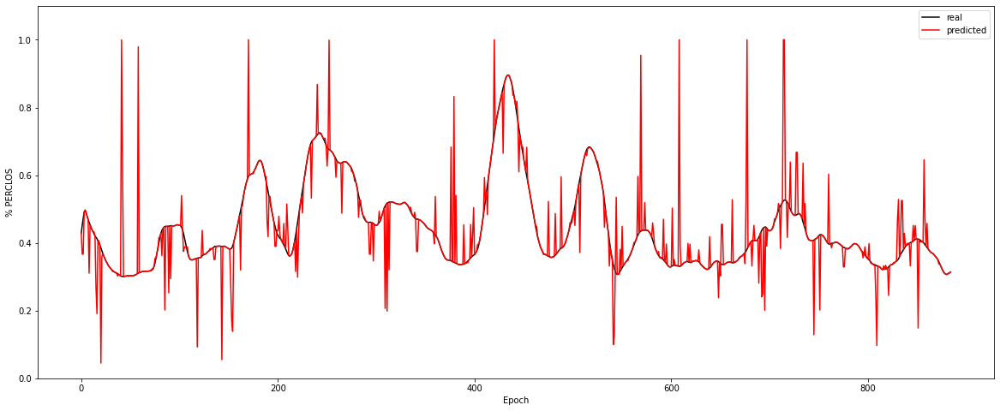

Experiment: 10_20151125_noon
	RMSE: 0.0753
	r^2: 0.7328


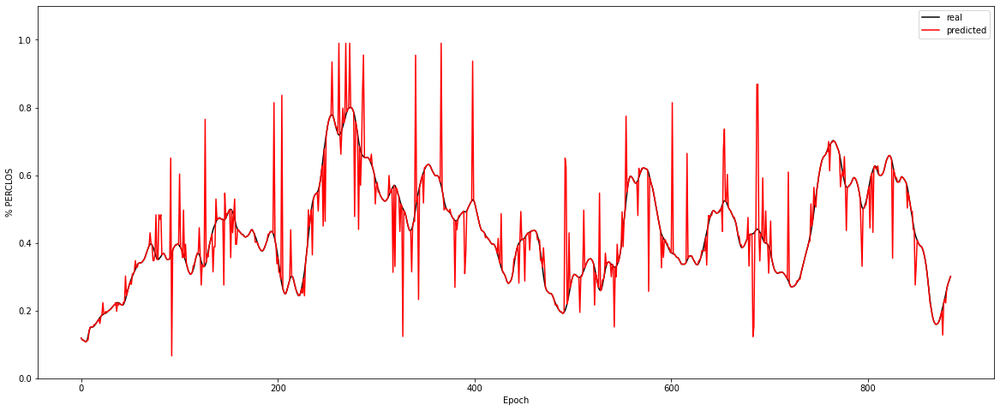

Experiment: 11_20151024_night
	RMSE: 0.0689
	r^2: 0.7264


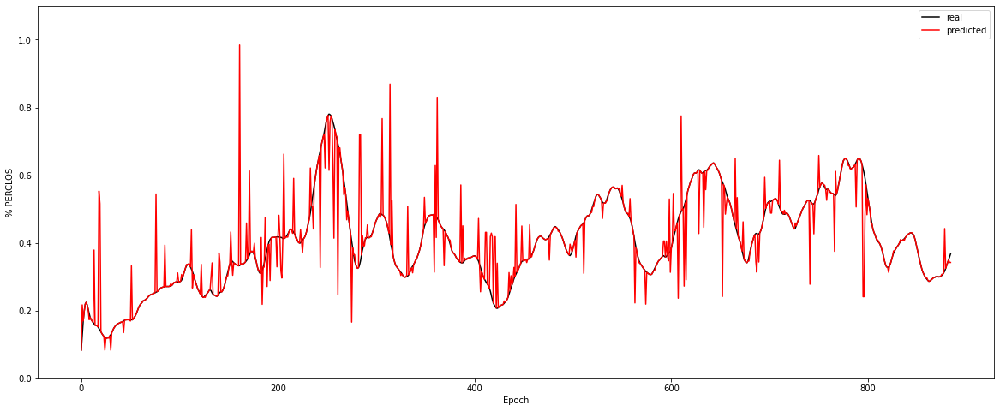

Experiment: 12_20150928_noon
	RMSE: 0.1104
	r^2: 0.9142


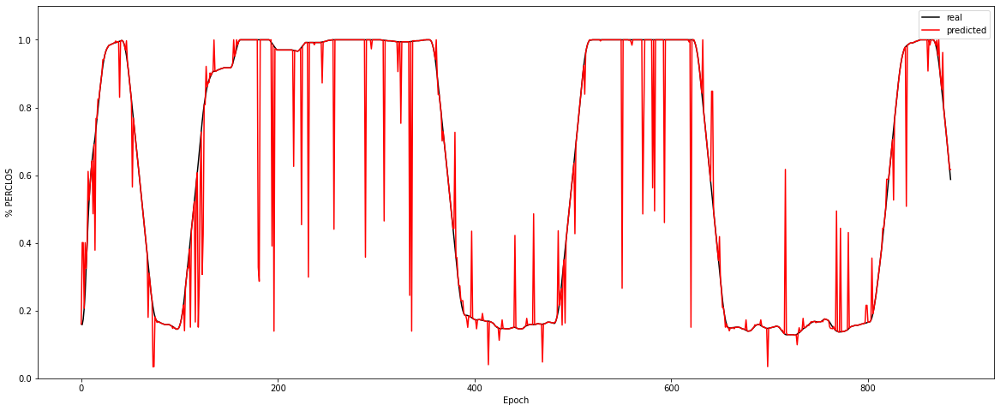

Experiment: 13_20150929_noon
	RMSE: 0.1061
	r^2: 0.7202


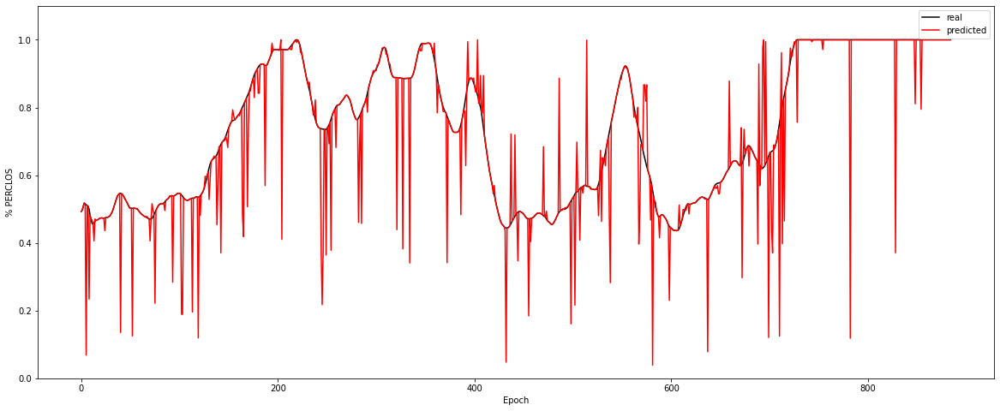

Experiment: 14_20151014_night
	RMSE: 0.1095
	r^2: 0.7695


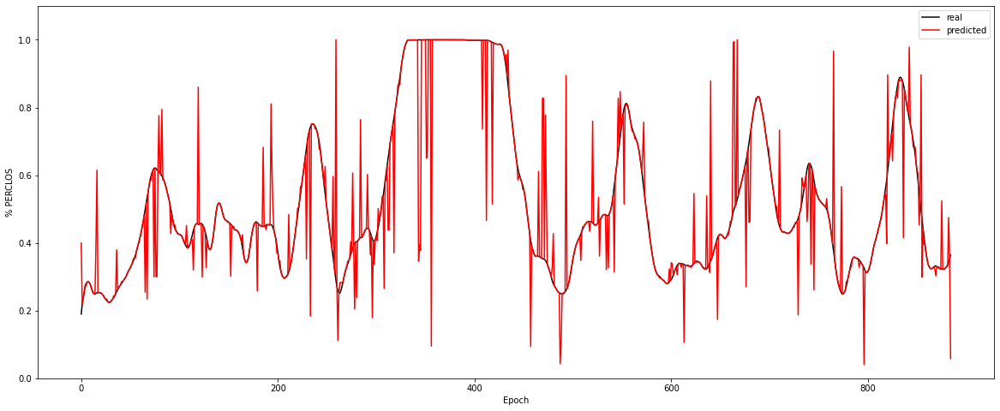

Experiment: 15_20151126_night
	RMSE: 0.0736
	r^2: 0.7973


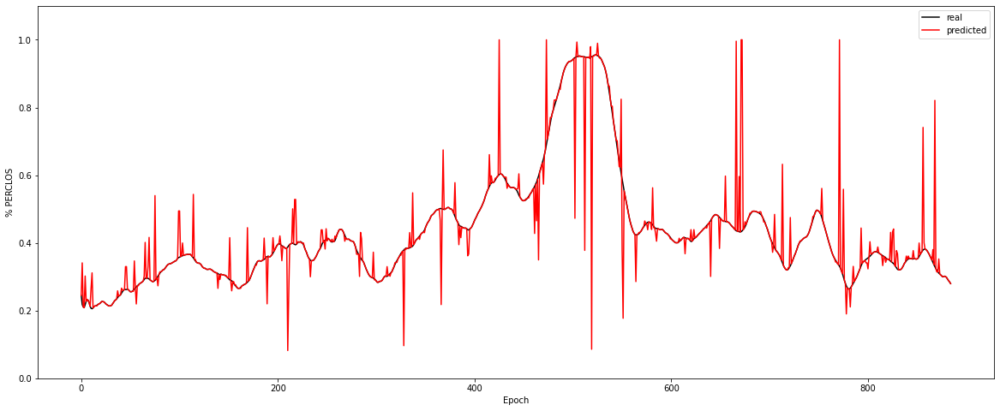

Experiment: 16_20151128_night
	RMSE: 0.0846
	r^2: 0.9315


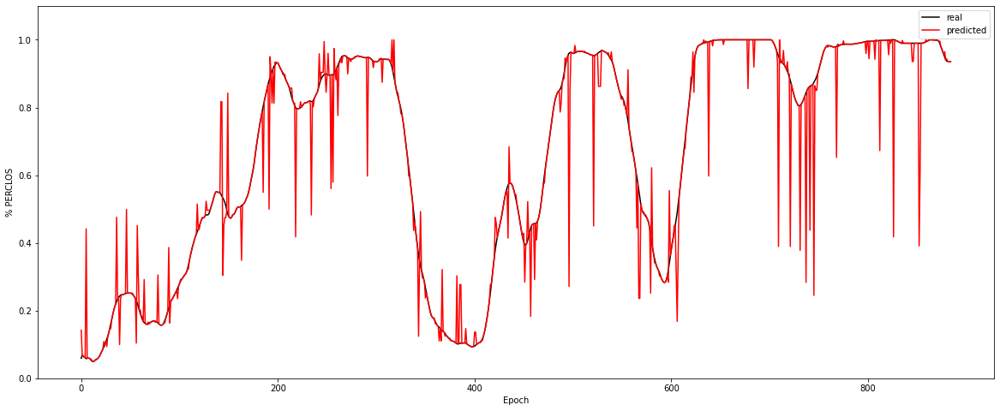

Experiment: 17_20150925_noon
	RMSE: 0.0730
	r^2: 0.8660


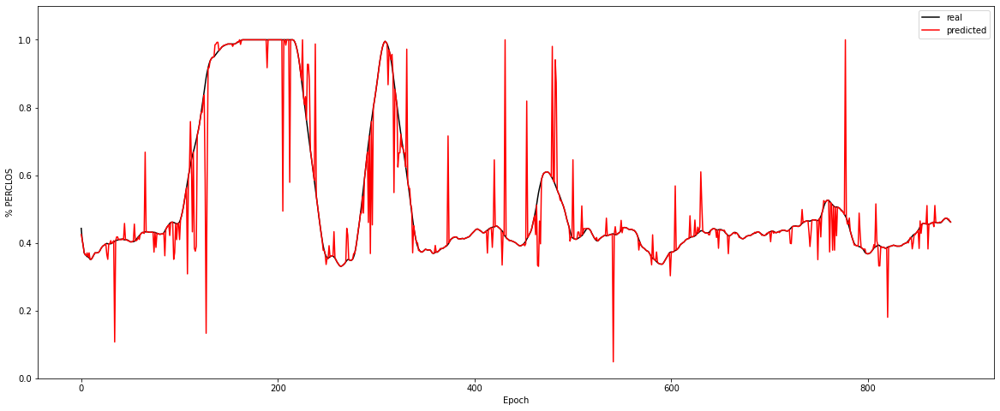

Experiment: 18_20150926_noon
	RMSE: 0.0586
	r^2: 0.9703


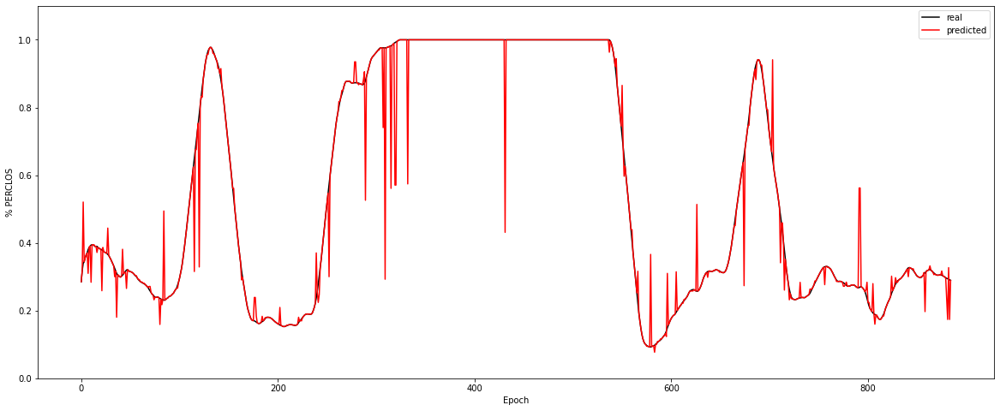

Experiment: 19_20151114_noon
	RMSE: 0.0625
	r^2: 0.7174


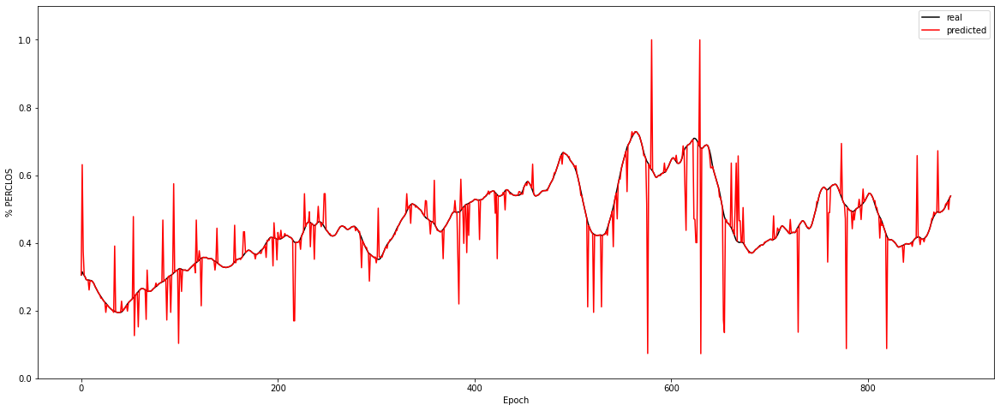

Experiment: 20_20151129_night
	RMSE: 0.1467
	r^2: 0.8332


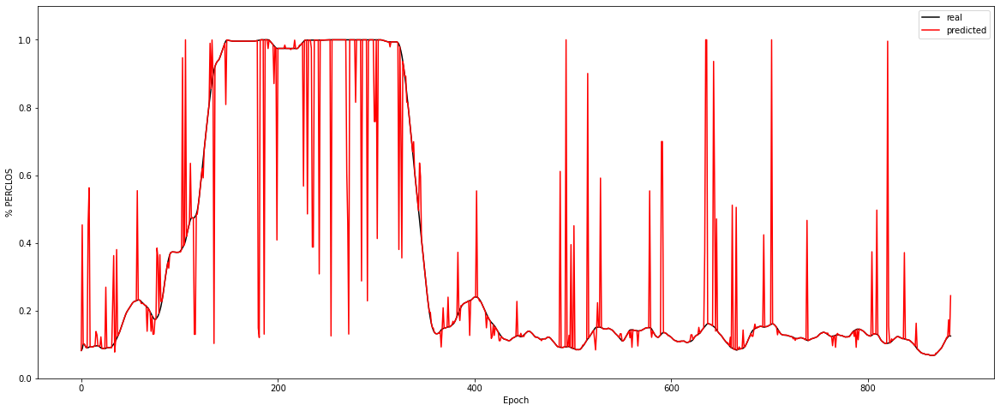

Experiment: 21_20151016_noon
	RMSE: 0.1038
	r^2: 0.8981


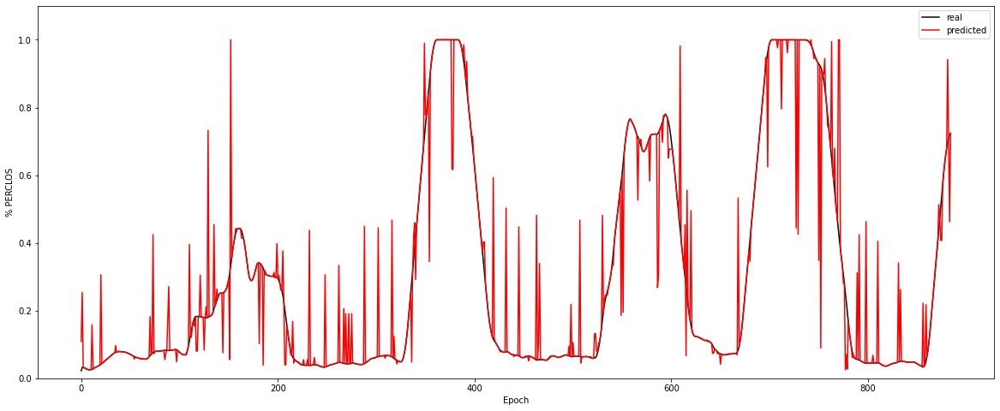

In [84]:
for key in X_all:
    data = X_all[key]
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### Decision Tree PSD + EOG

In [85]:
print(f"Experiment: Modelo General Decision Tree PSD")
model = DecisionTreeRegressor(random_state=42)

space = dict()
space['criterion'] = ['mse', 'friedman_mse']
space['splitter'] = ["best", "random"]
space['max_depth'] = [None]
space['min_samples_split'] = [2]
space['min_samples_leaf'] = [1]
space['max_features'] = ["auto", "sqrt", "log2"]

general_model, rmse, r2 = find_and_test_best_model_reg(X_eog, y, model, space, cv=10,  n_iter=100)

Experiment: Modelo General Decision Tree PSD


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:289: UserWarning: The total space of parameters 12 is smaller than n_iter=100. Running 12 iterations. For exhaustive searches, use GridSearchCV.
  % (grid_size, self.n_iter, grid_size), UserWarning)


Best Model:
	Score: 0.5856
	Hyperparameters: {'splitter': 'best', 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'auto', 'max_depth': None, 'criterion': 'mse'}

Results with X_test:
	RMSE: 0.1667
	r^2: 0.6237


In [86]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = general_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

n_parpadeos: 0.3577
psd_theta: 0.1527
psd_alpha: 0.1506
psd_gamma: 0.1436
psd_delta: 0.1196
psd_betha: 0.0758


Experiment: 1_20151124_noon_2
	RMSE: 0.0786
	r^2: 0.9252


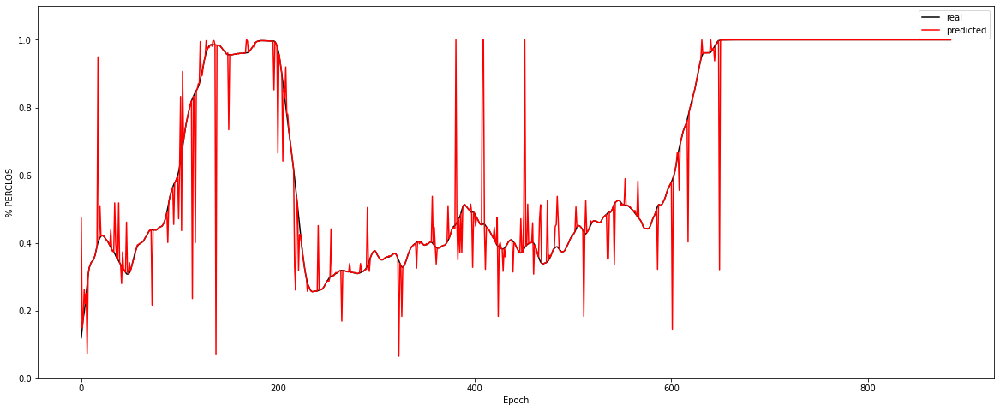

Experiment: 2_20151106_noon
	RMSE: 0.0753
	r^2: 0.7883


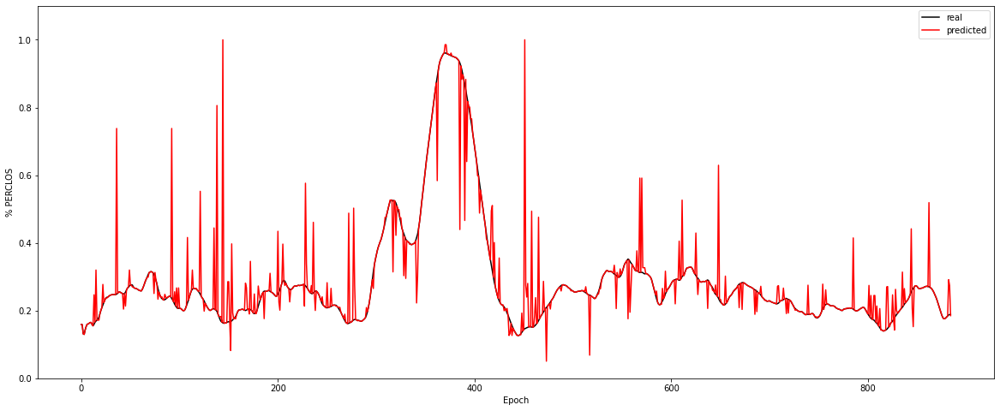

Experiment: 3_20151024_noon
	RMSE: 0.0817
	r^2: 0.7487


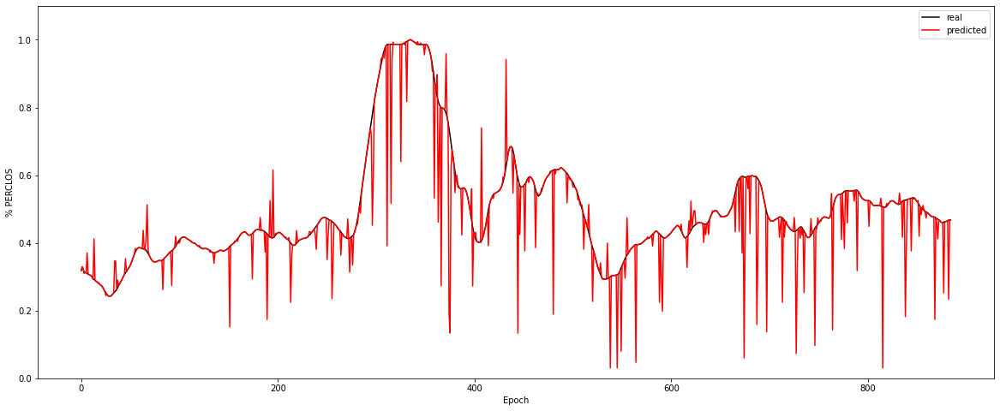

Experiment: 4_20151105_noon
	RMSE: 0.1079
	r^2: 0.6905


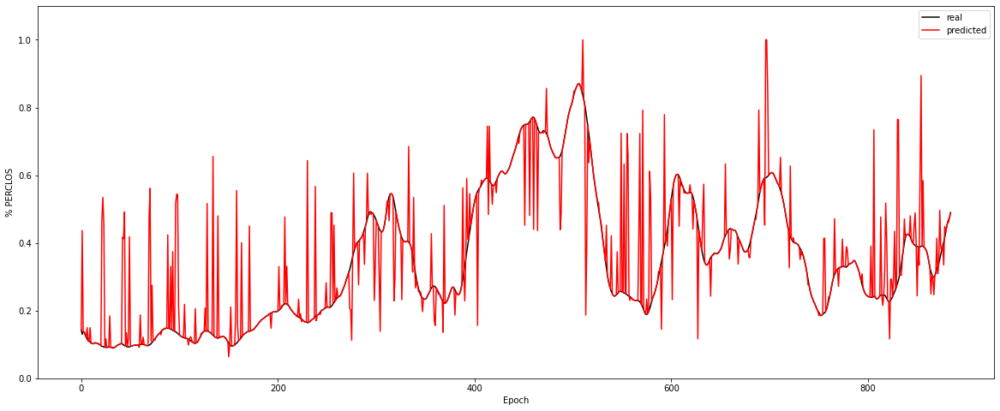

Experiment: 4_20151107_noon
	RMSE: 0.1132
	r^2: 0.7724


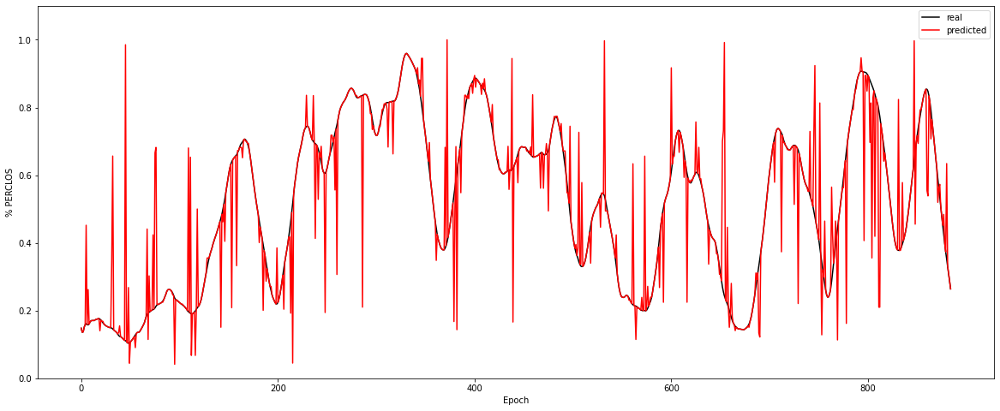

Experiment: 5_20141108_noon
	RMSE: 0.0971
	r^2: 0.9121


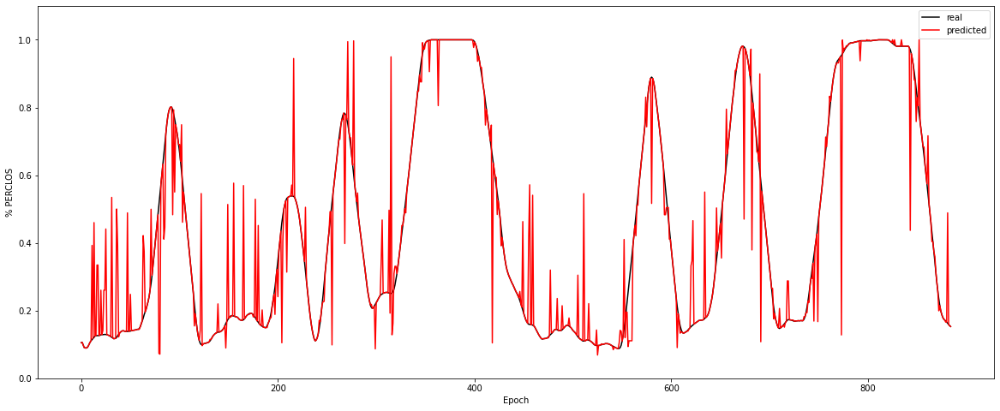

Experiment: 5_20151012_night
	RMSE: 0.0892
	r^2: 0.8904


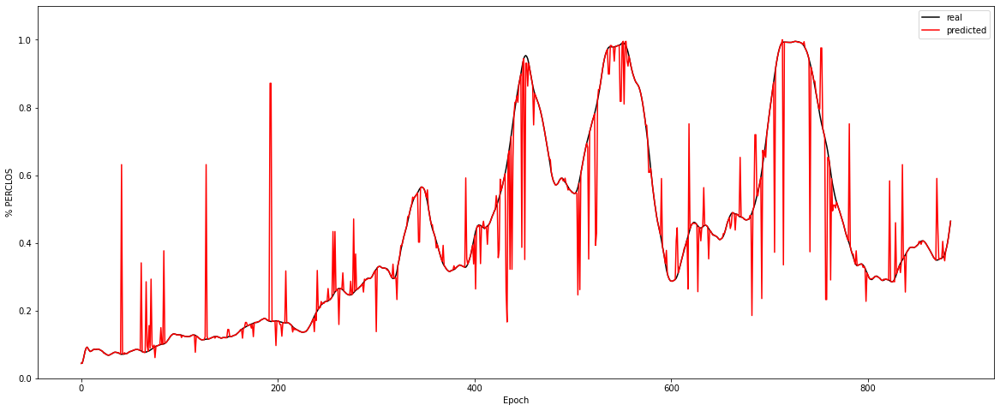

Experiment: 6_20151121_noon
	RMSE: 0.0841
	r^2: 0.5565


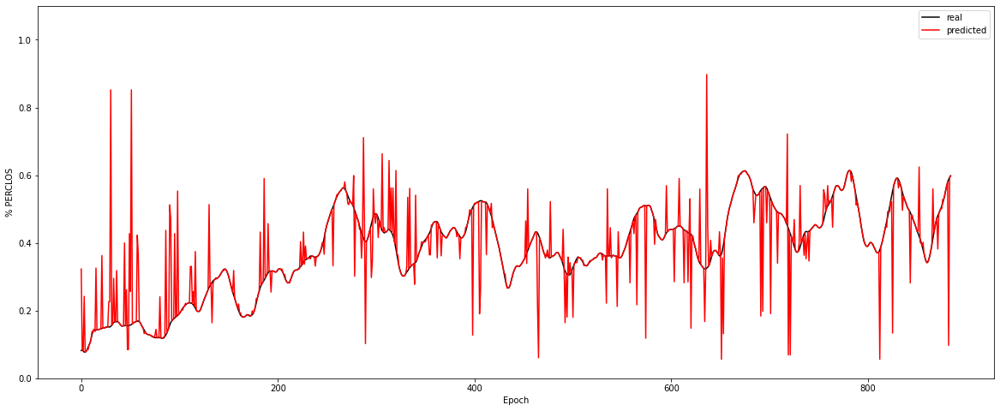

Experiment: 7_20151015_night
	RMSE: 0.0435
	r^2: 0.8567


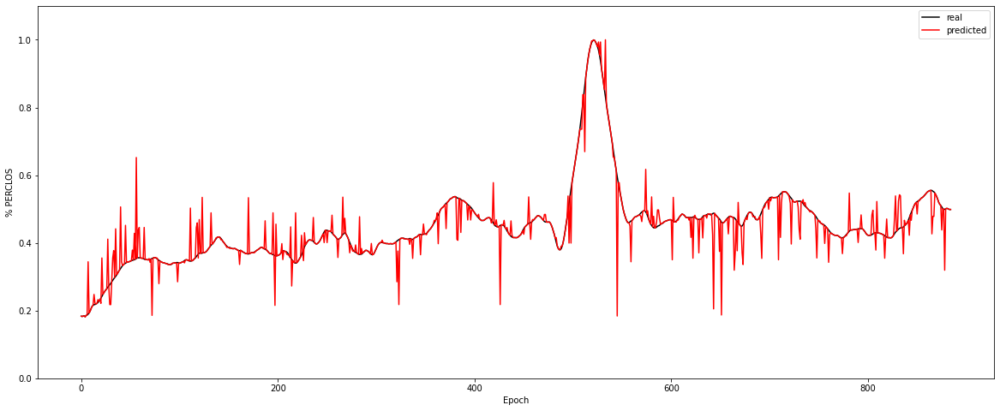

Experiment: 8_20151022_noon
	RMSE: 0.0503
	r^2: 0.9560


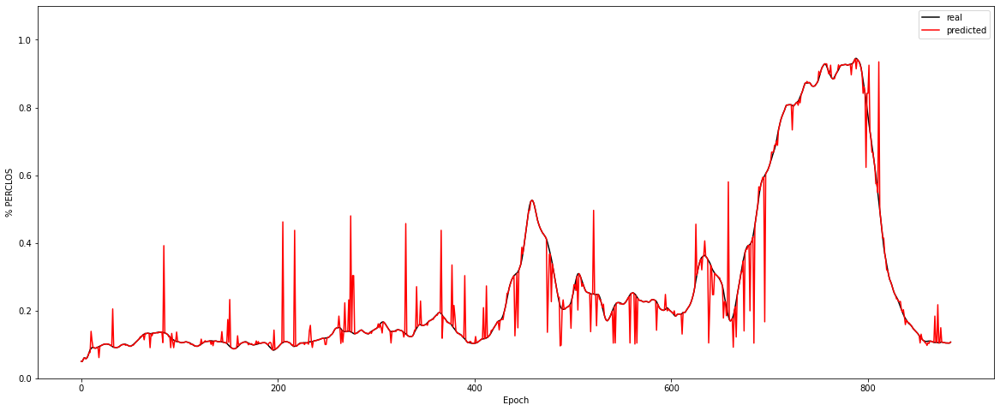

Experiment: 9_20151017_night
	RMSE: 0.0690
	r^2: 0.6813


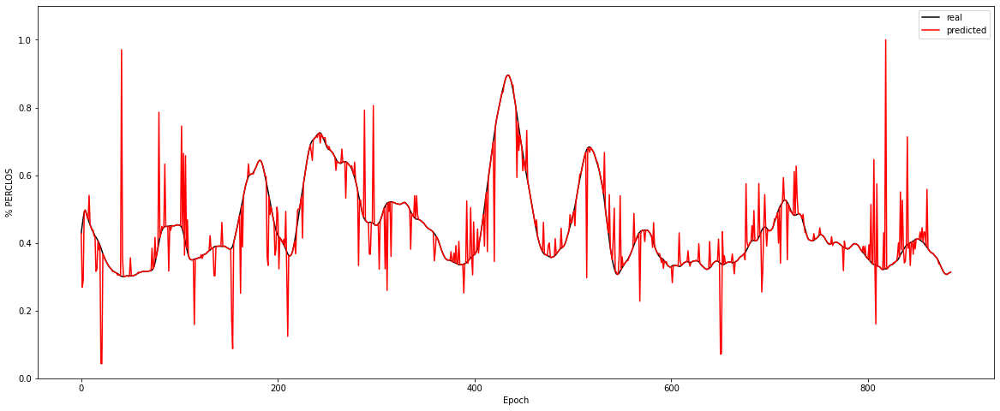

Experiment: 10_20151125_noon
	RMSE: 0.0791
	r^2: 0.7047


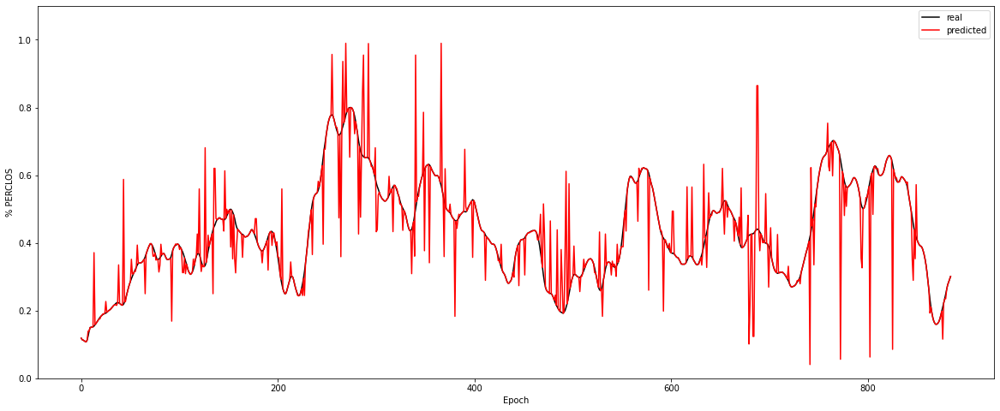

Experiment: 11_20151024_night
	RMSE: 0.0630
	r^2: 0.7715


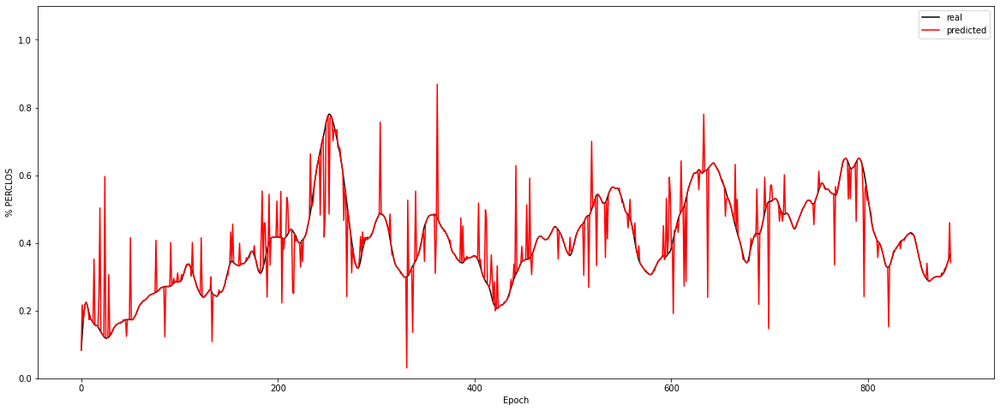

Experiment: 12_20150928_noon
	RMSE: 0.1077
	r^2: 0.9183


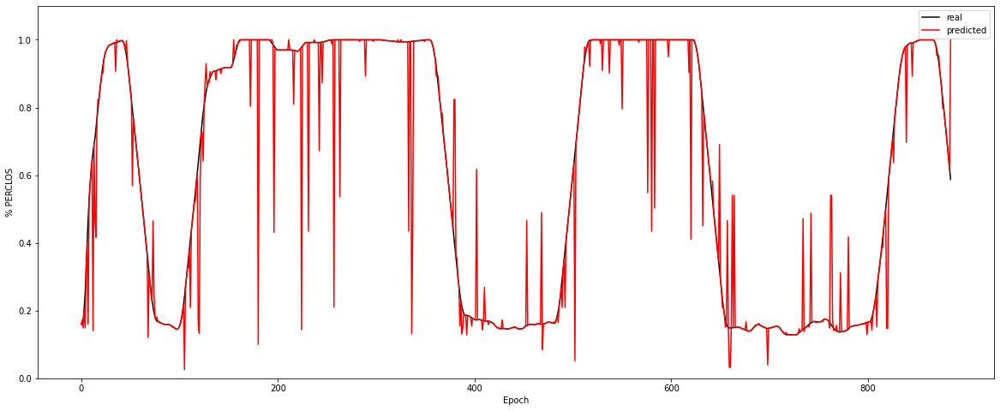

Experiment: 13_20150929_noon
	RMSE: 0.0834
	r^2: 0.8273


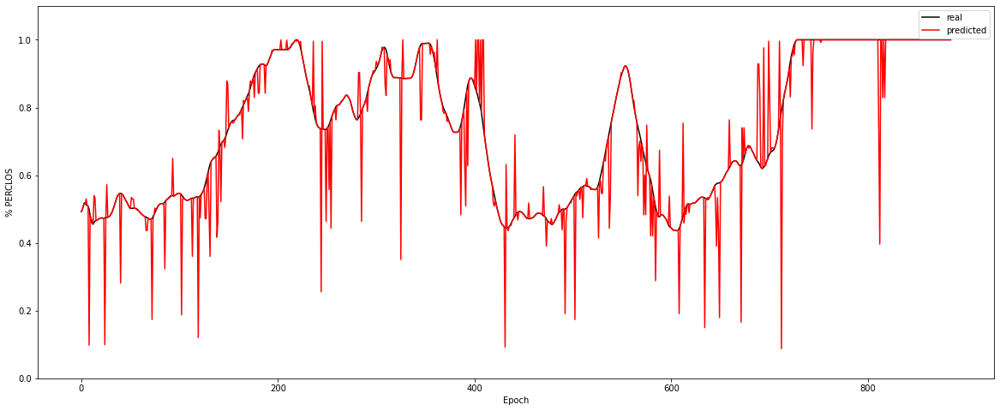

Experiment: 14_20151014_night
	RMSE: 0.0912
	r^2: 0.8403


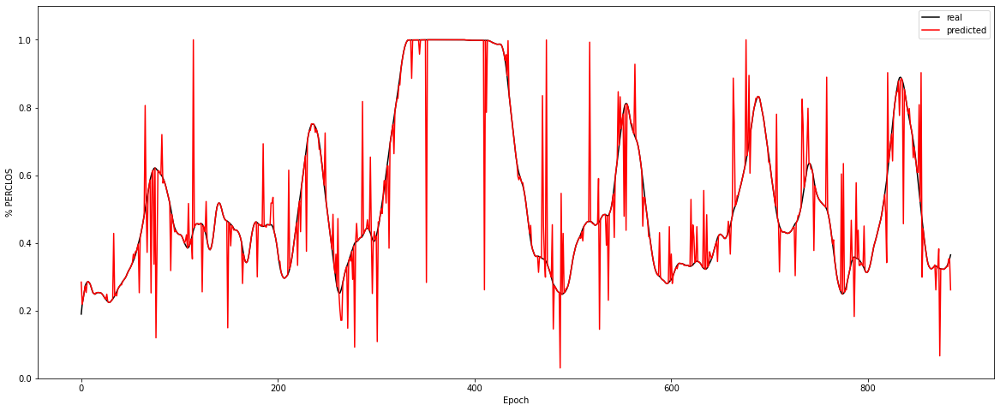

Experiment: 15_20151126_night
	RMSE: 0.0710
	r^2: 0.8115


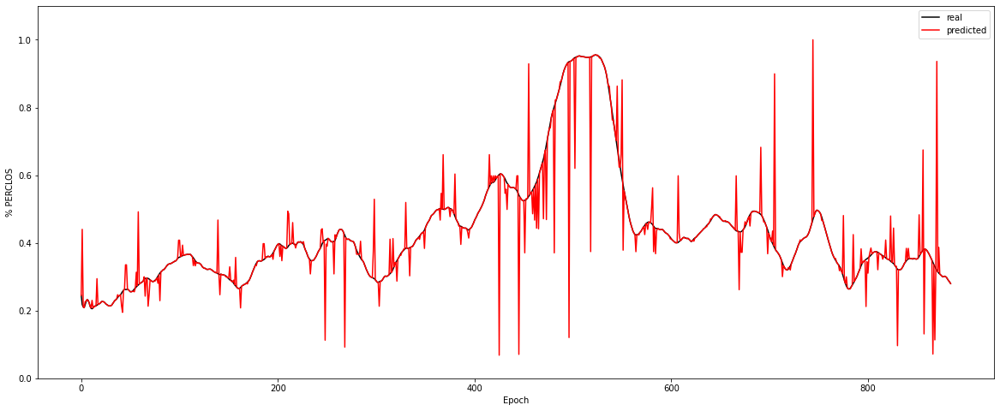

Experiment: 16_20151128_night
	RMSE: 0.0776
	r^2: 0.9424


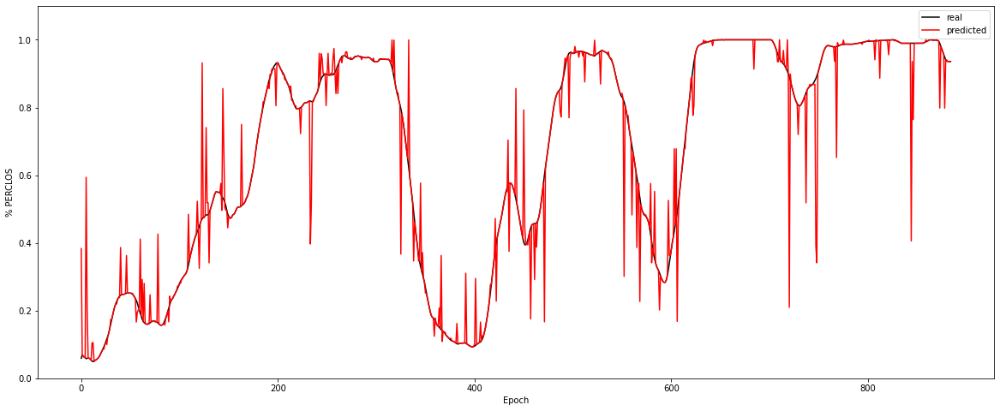

Experiment: 17_20150925_noon
	RMSE: 0.0594
	r^2: 0.9112


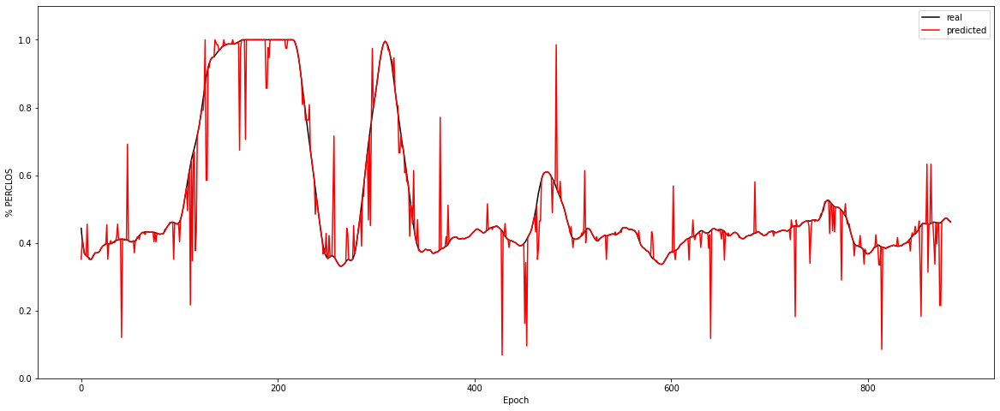

Experiment: 18_20150926_noon
	RMSE: 0.0629
	r^2: 0.9658


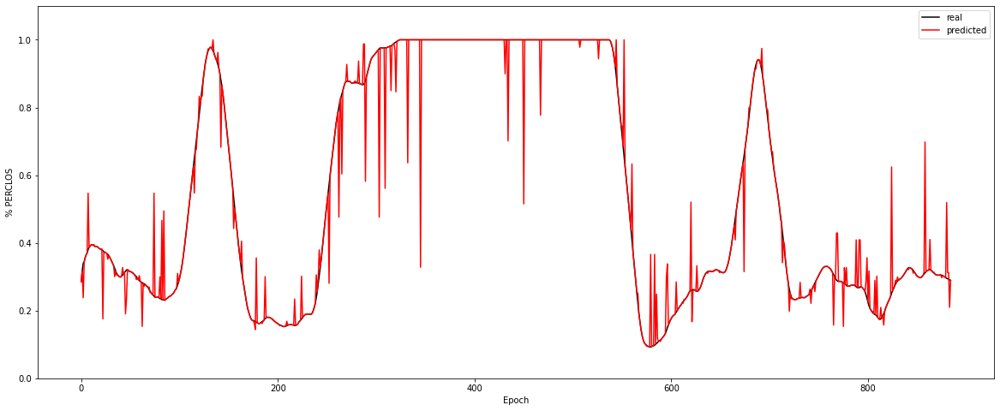

Experiment: 19_20151114_noon
	RMSE: 0.0713
	r^2: 0.6328


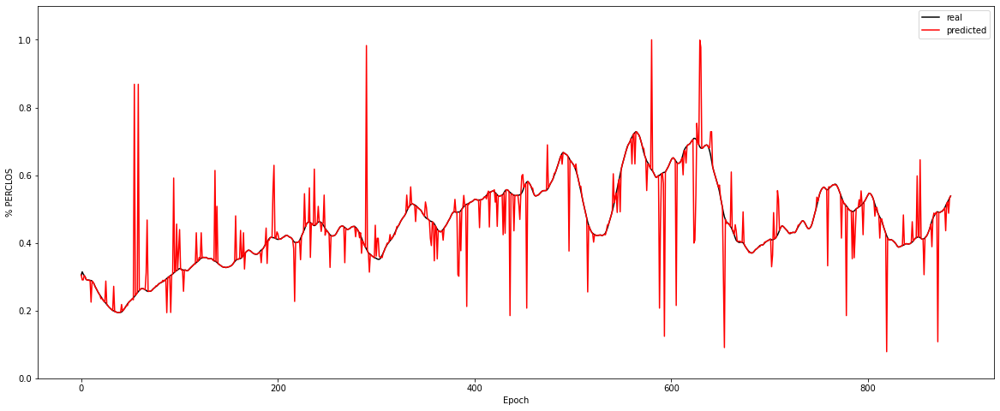

Experiment: 20_20151129_night
	RMSE: 0.1136
	r^2: 0.9000


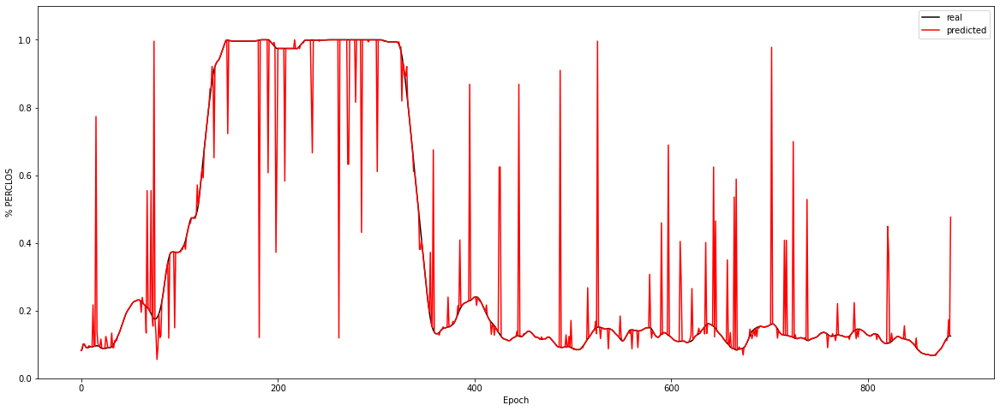

Experiment: 21_20151016_noon
	RMSE: 0.0975
	r^2: 0.9100


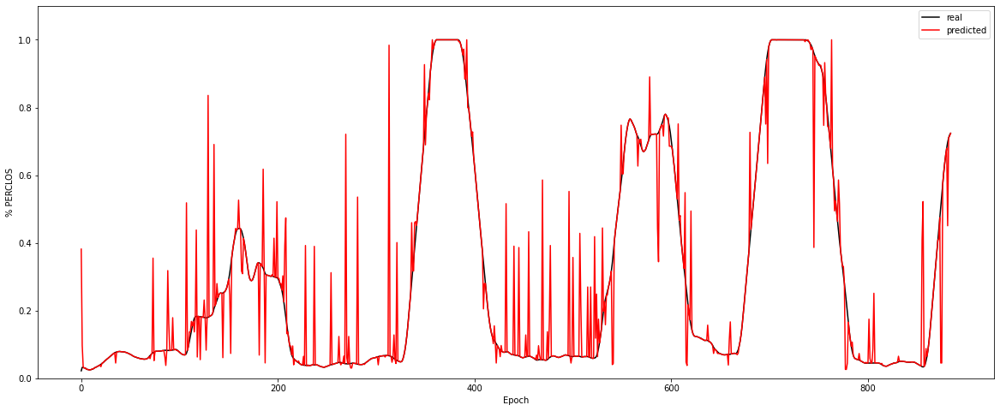

In [87]:
for key in X_all:
    data = X_all_eog[key]
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

## Random Forest

In [88]:
from sklearn.ensemble import RandomForestRegressor

### Random Forest EEG

In [ ]:
print(f"Experiment: Modelo General Random Forest EEG")
model = RandomForestRegressor(random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ['mse']
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'X_all_eogform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

general_model, rmse, r2 = find_and_test_best_model_reg(X, y, model, space, cv=10,  n_iter=25)

attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = general_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

for key in X_all:   
    data, aux2 = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_minmax = scaler.fit_transform(data_minmax)
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### Random Forest PSD

In [89]:
print(f"Experiment: Modelo General Random Forest PSD")
model = RandomForestRegressor(random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ['mse']
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'X_all_eogform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

general_model, rmse, r2 = find_and_test_best_model_reg(X, y, model, space, cv=10,  n_iter=25)

Experiment: Modelo General Random Forest PSD
Best Model:
	Score: 0.7810
	Hyperparameters: {'criterion': 'mse', 'max_depth': 92, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	RMSE: 0.1237
	r^2: 0.7928


In [90]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = general_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2604
psd_gamma: 0.2436
psd_theta: 0.1970
psd_delta: 0.1573
psd_betha: 0.1417


Experiment: 1_20151124_noon_2
	RMSE: 0.0633
	r^2: 0.9514


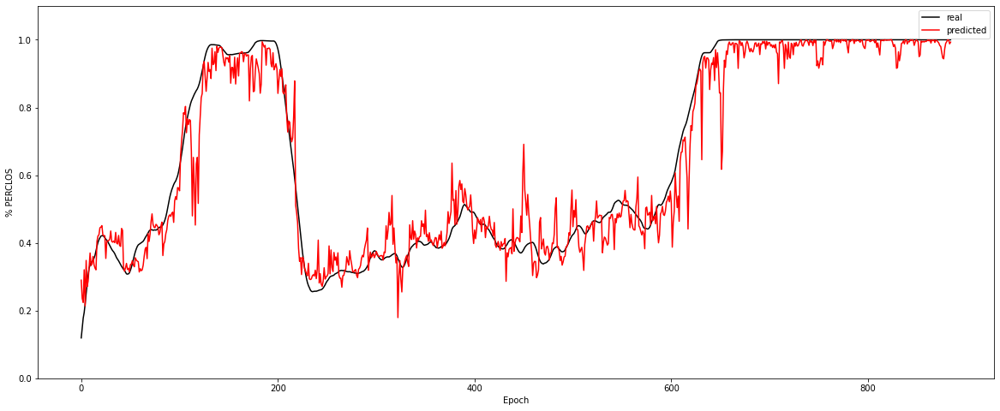

Experiment: 2_20151106_noon
	RMSE: 0.0655
	r^2: 0.8399


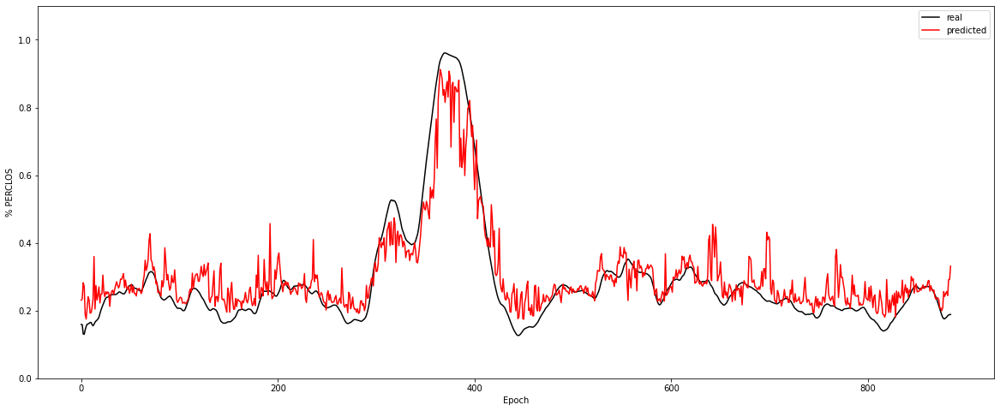

Experiment: 3_20151024_noon
	RMSE: 0.0843
	r^2: 0.7326


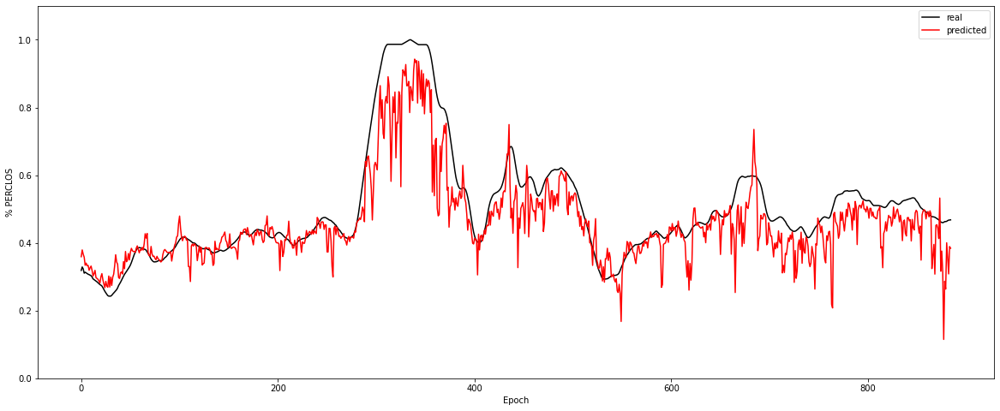

Experiment: 4_20151105_noon
	RMSE: 0.1052
	r^2: 0.7059


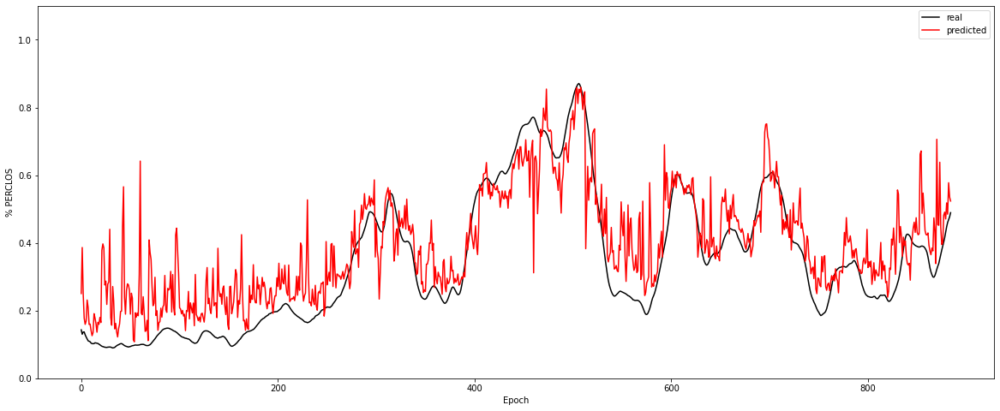

Experiment: 4_20151107_noon
	RMSE: 0.0941
	r^2: 0.8428


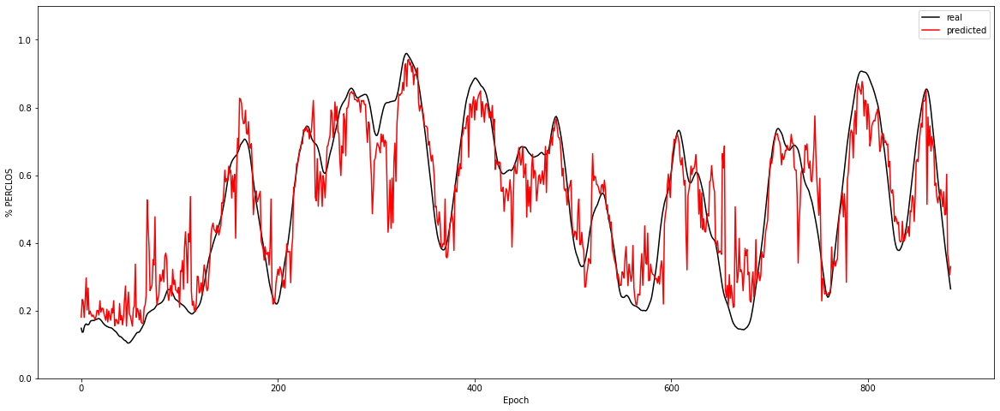

Experiment: 5_20141108_noon
	RMSE: 0.0990
	r^2: 0.9087


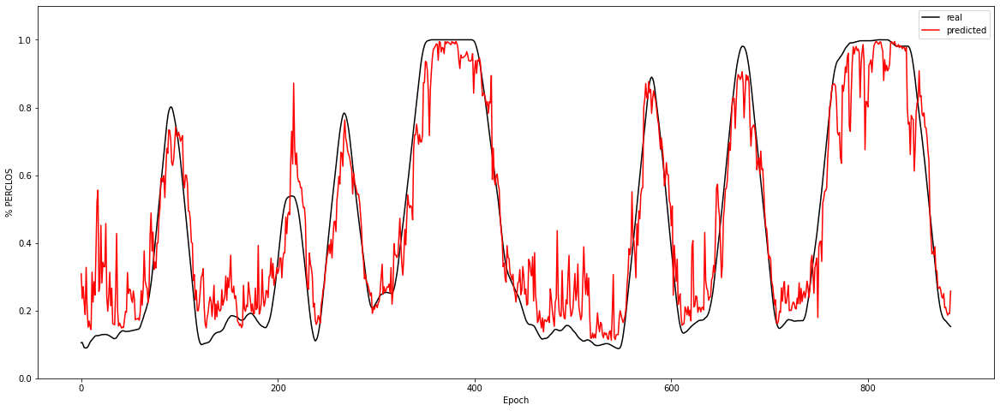

Experiment: 5_20151012_night
	RMSE: 0.0935
	r^2: 0.8797


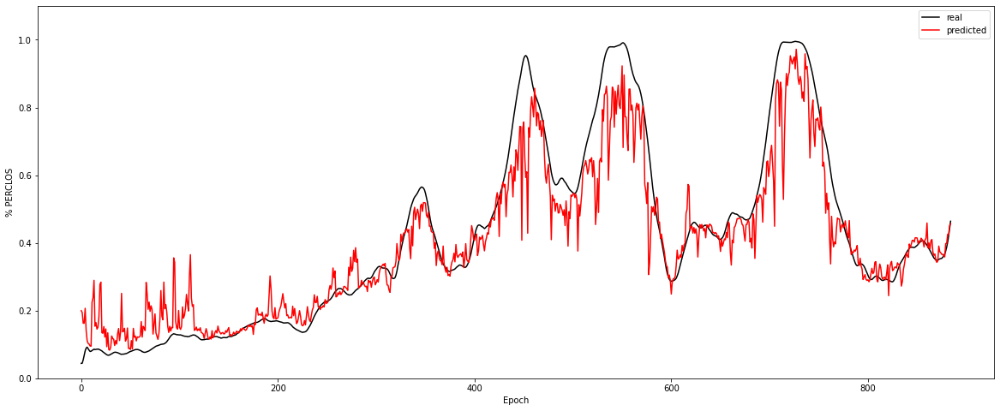

Experiment: 6_20151121_noon
	RMSE: 0.0719
	r^2: 0.6755


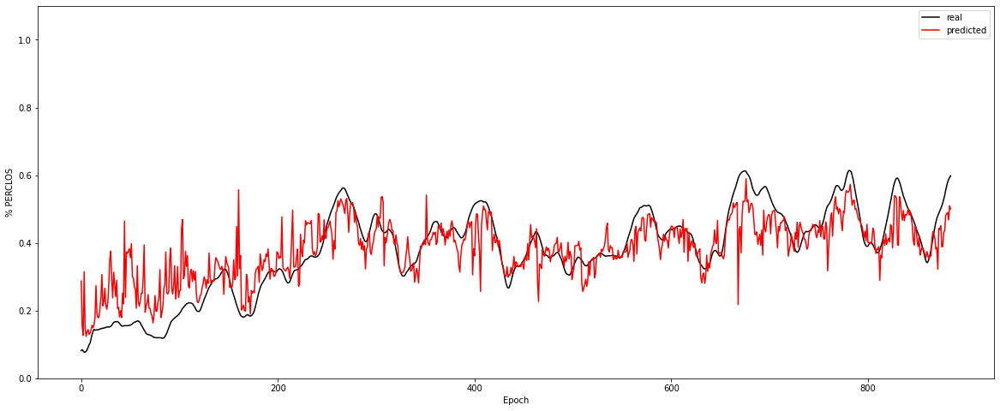

Experiment: 7_20151015_night
	RMSE: 0.0409
	r^2: 0.8732


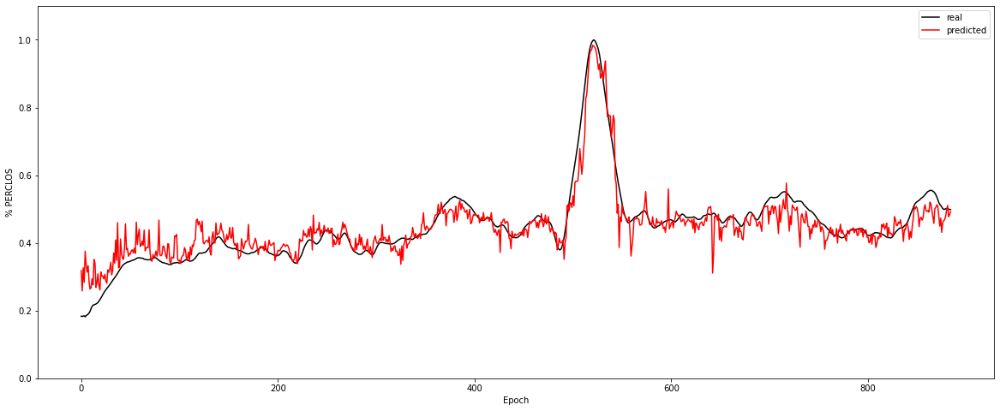

Experiment: 8_20151022_noon
	RMSE: 0.0419
	r^2: 0.9694


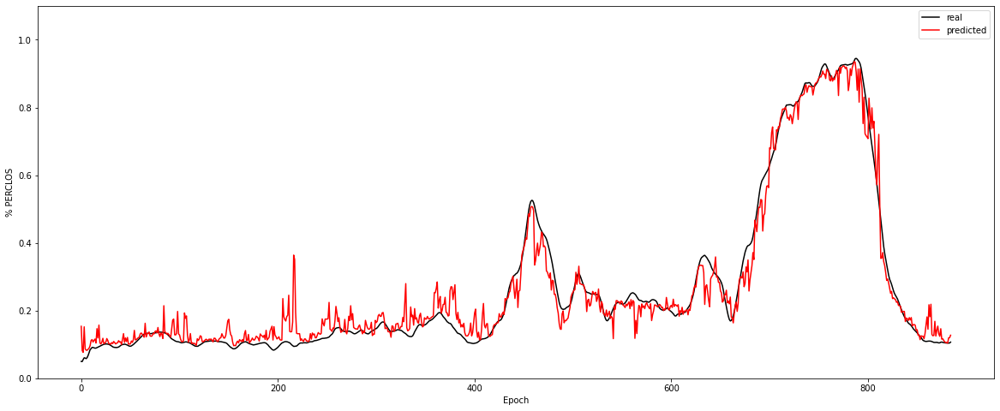

Experiment: 9_20151017_night
	RMSE: 0.0597
	r^2: 0.7610


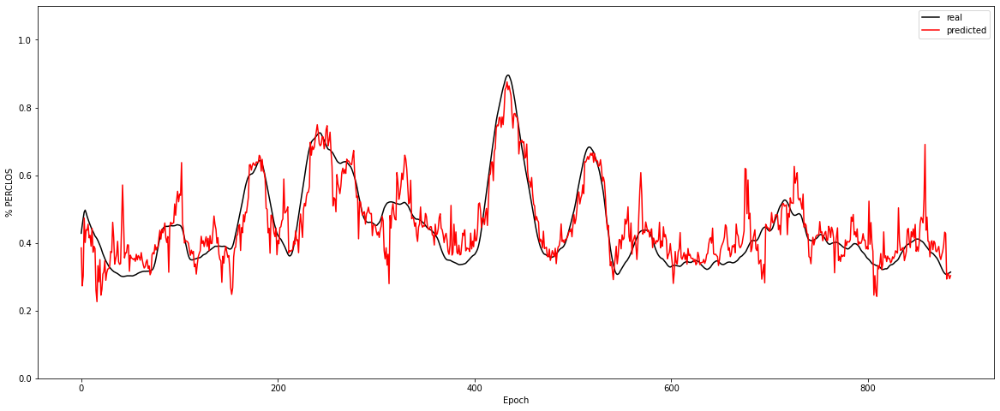

Experiment: 10_20151125_noon
	RMSE: 0.0688
	r^2: 0.7768


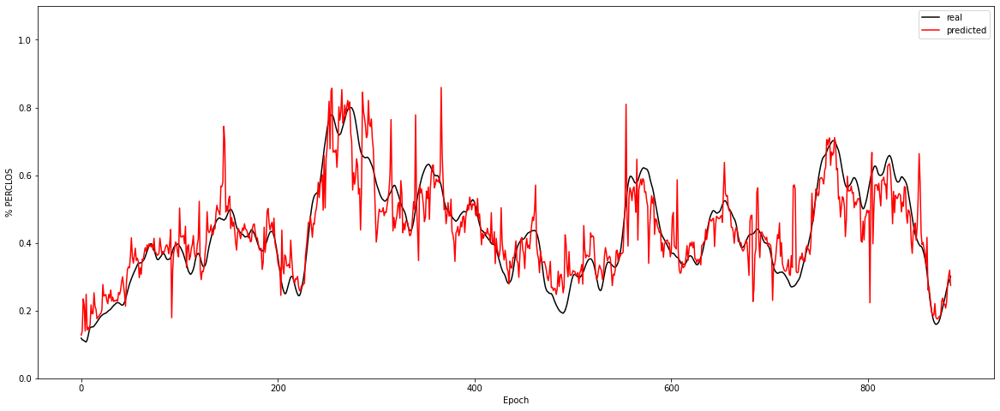

Experiment: 11_20151024_night
	RMSE: 0.0544
	r^2: 0.8297


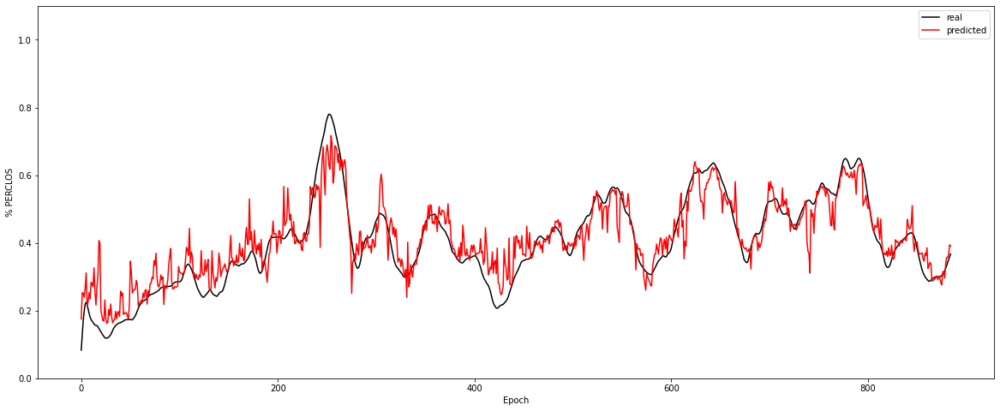

Experiment: 12_20150928_noon
	RMSE: 0.1054
	r^2: 0.9218


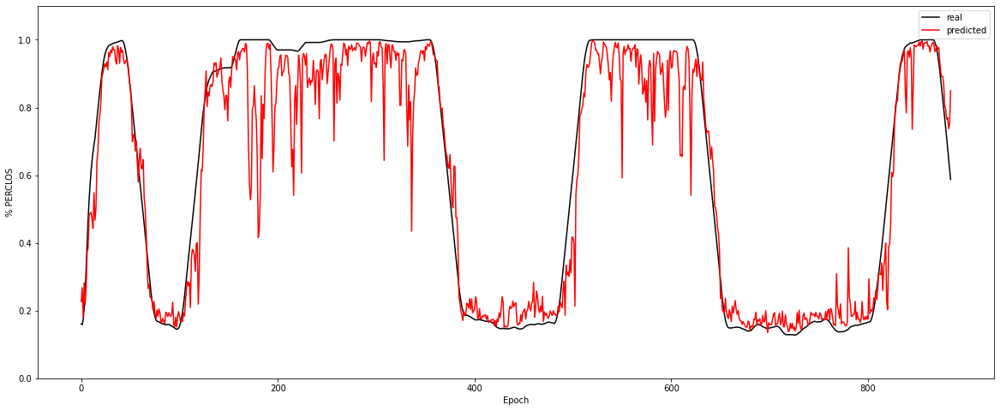

Experiment: 13_20150929_noon
	RMSE: 0.0902
	r^2: 0.7978


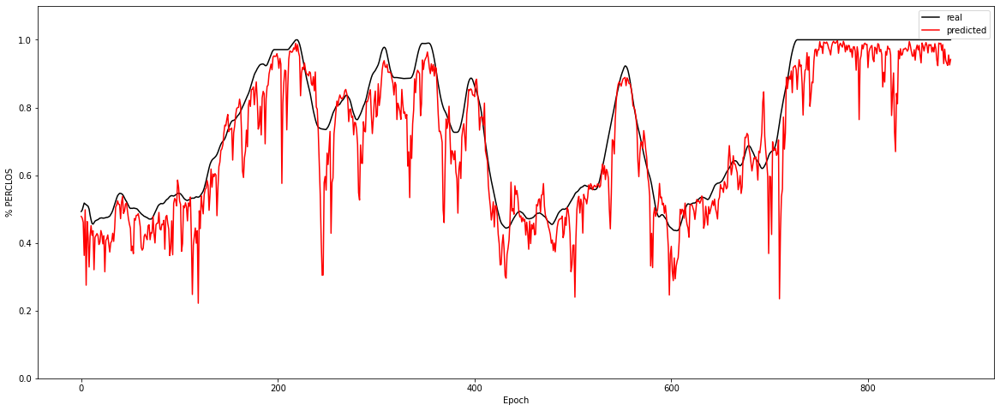

Experiment: 14_20151014_night
	RMSE: 0.0968
	r^2: 0.8200


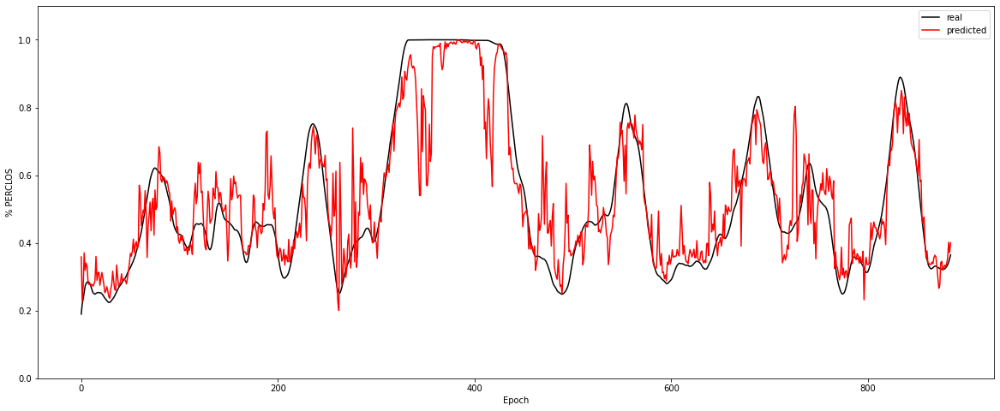

Experiment: 15_20151126_night
	RMSE: 0.0639
	r^2: 0.8473


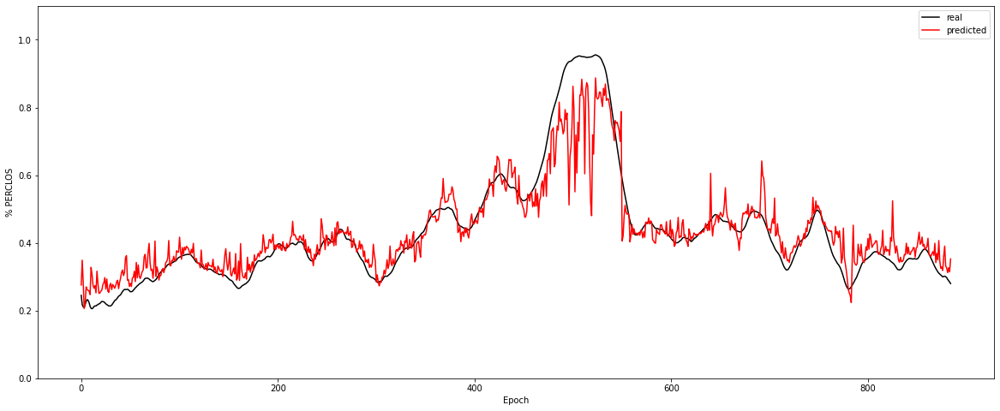

Experiment: 16_20151128_night
	RMSE: 0.0845
	r^2: 0.9317


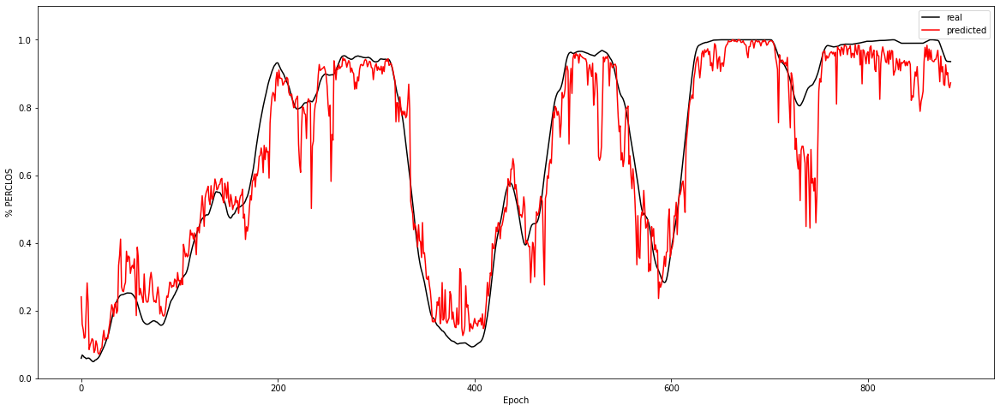

Experiment: 17_20150925_noon
	RMSE: 0.0593
	r^2: 0.9116


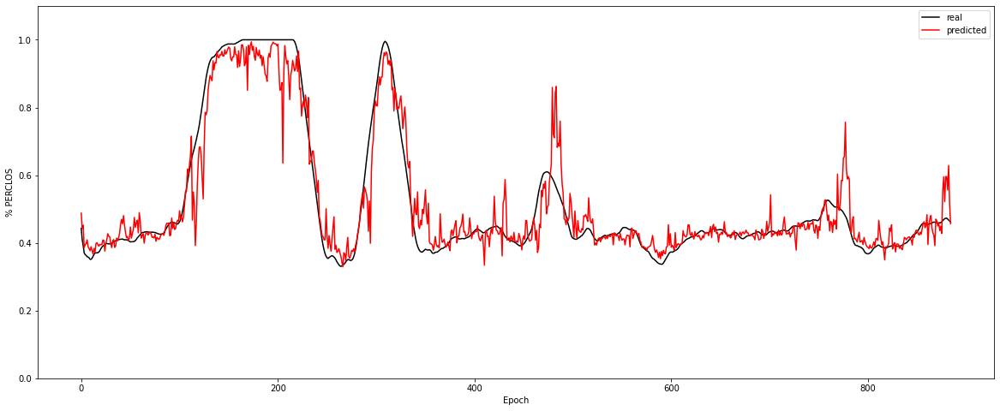

Experiment: 18_20150926_noon
	RMSE: 0.0603
	r^2: 0.9685


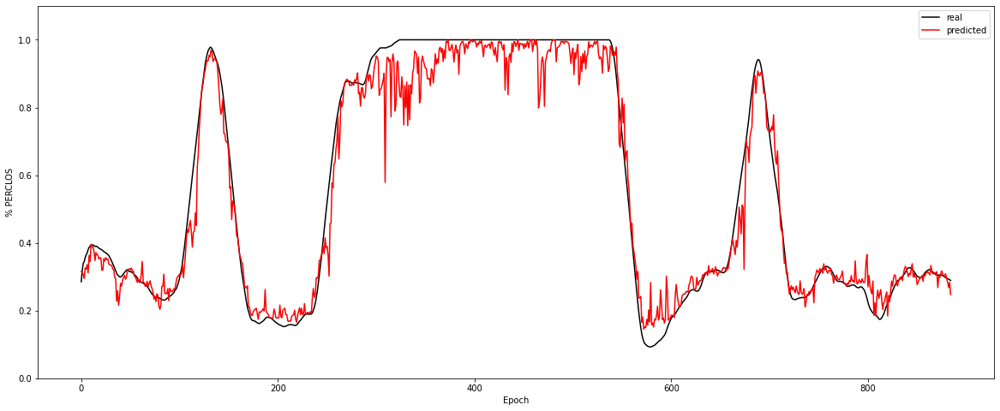

Experiment: 19_20151114_noon
	RMSE: 0.0564
	r^2: 0.7698


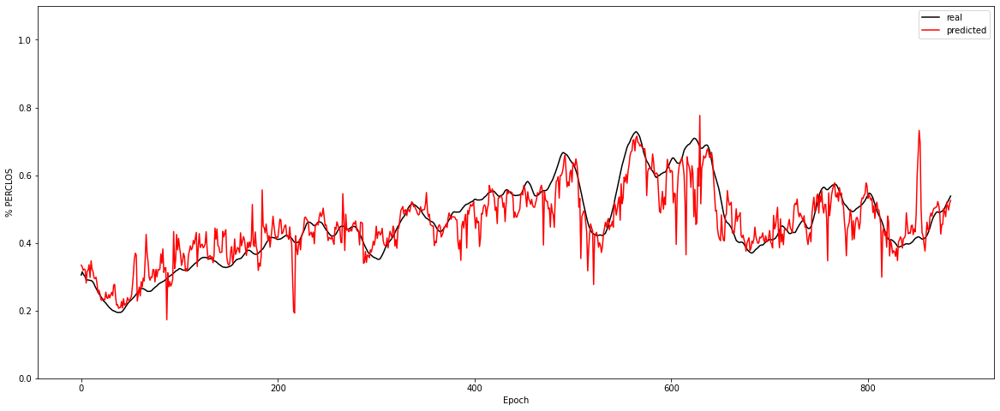

Experiment: 20_20151129_night
	RMSE: 0.1488
	r^2: 0.8285


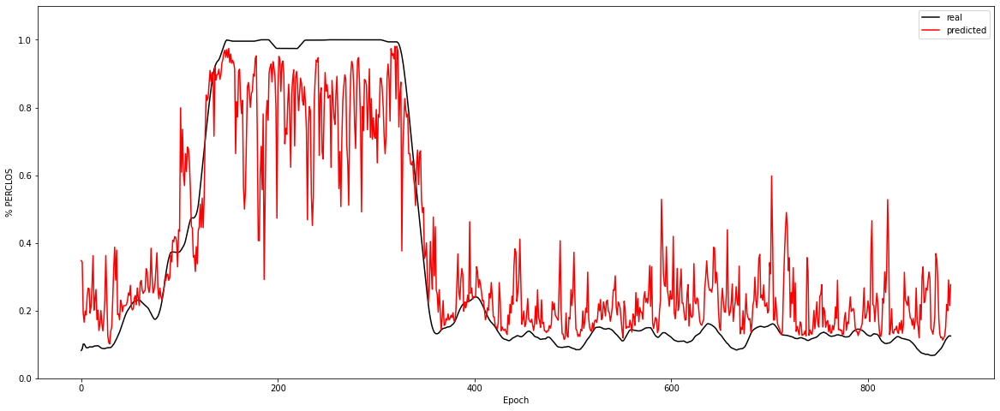

Experiment: 21_20151016_noon
	RMSE: 0.1048
	r^2: 0.8961


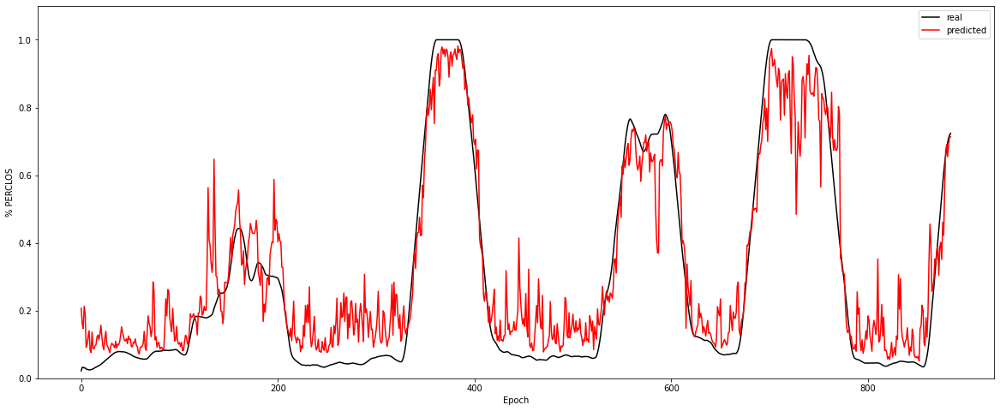

In [91]:
for key in X_all:
    data = X_all[key]
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### Random Forest PSD + EOG

In [92]:
print(f"Experiment: Modelo General Random Forest PSD")
model = RandomForestRegressor(random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ['mse']
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'X_all_eogform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

general_model, rmse, r2 = find_and_test_best_model_reg(X_eog, y, model, space, cv=10,  n_iter=25)

Experiment: Modelo General Random Forest PSD
Best Model:
	Score: 0.7857
	Hyperparameters: {'criterion': 'mse', 'max_depth': 92, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	RMSE: 0.1223
	r^2: 0.7976


In [93]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = general_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

n_parpadeos: 0.2940
psd_alpha: 0.1791
psd_theta: 0.1573
psd_gamma: 0.1503
psd_delta: 0.1126
psd_betha: 0.1066


Experiment: 1_20151124_noon_2
	RMSE: 0.0634
	r^2: 0.9514


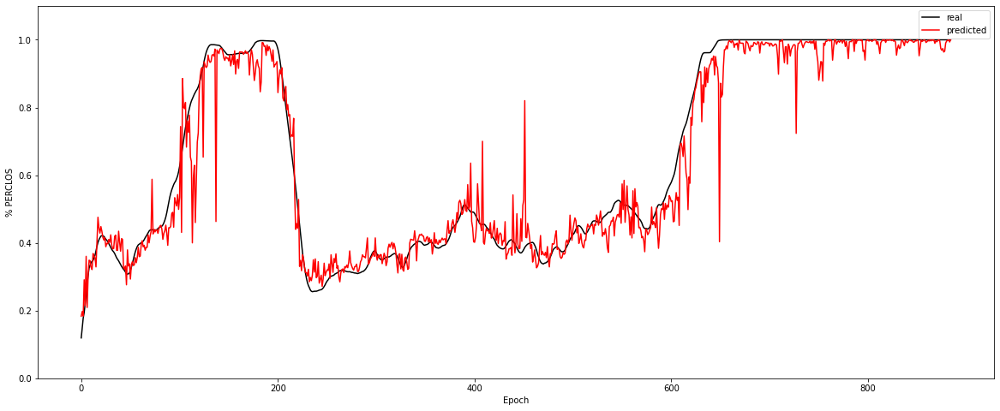

Experiment: 2_20151106_noon
	RMSE: 0.0657
	r^2: 0.8390


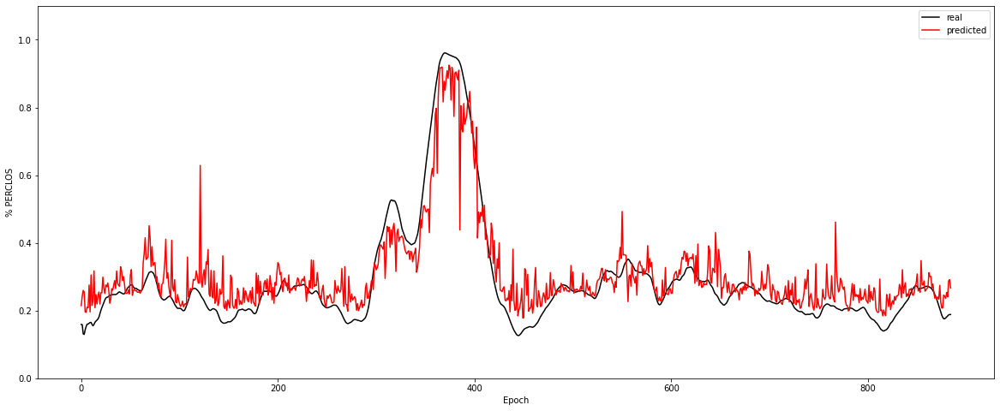

Experiment: 3_20151024_noon
	RMSE: 0.0804
	r^2: 0.7564


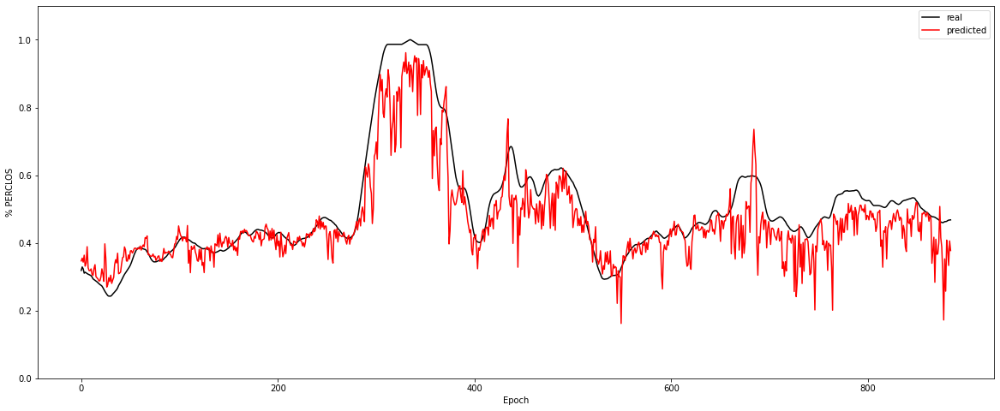

Experiment: 4_20151105_noon
	RMSE: 0.1055
	r^2: 0.7043


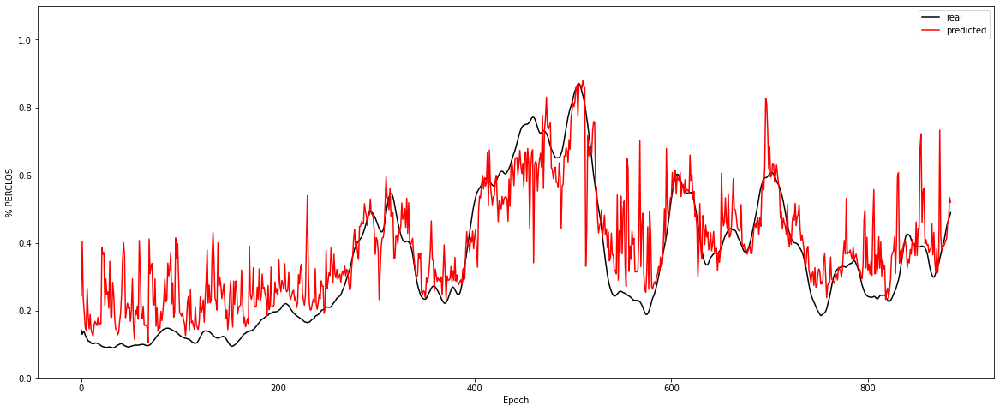

Experiment: 4_20151107_noon
	RMSE: 0.0992
	r^2: 0.8253


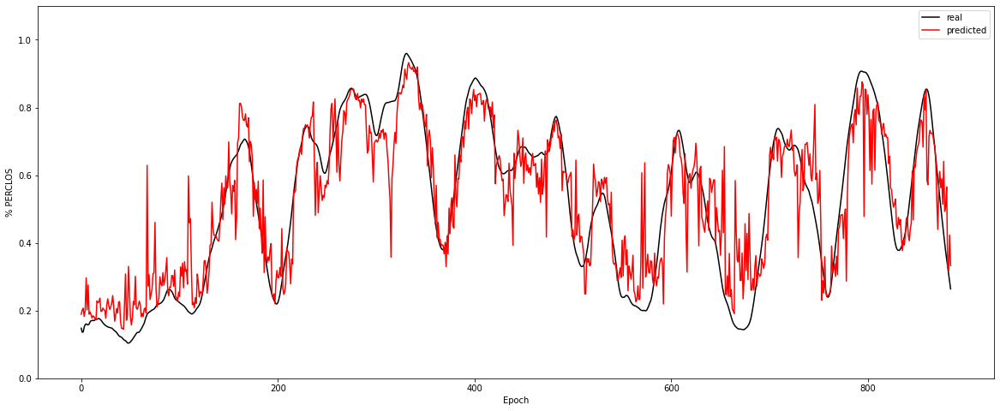

Experiment: 5_20141108_noon
	RMSE: 0.1029
	r^2: 0.9013


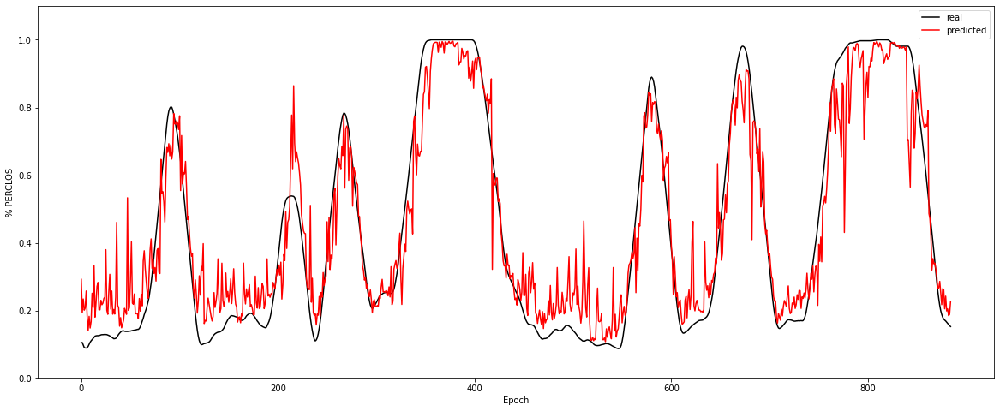

Experiment: 5_20151012_night
	RMSE: 0.1028
	r^2: 0.8545


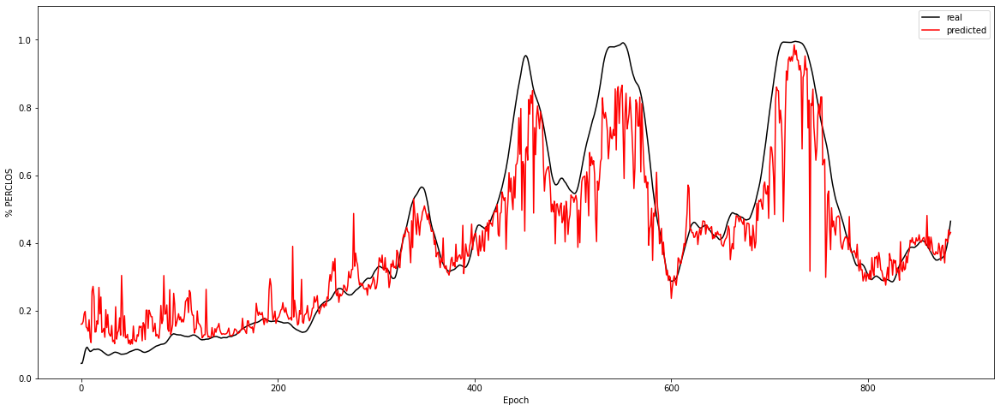

Experiment: 6_20151121_noon
	RMSE: 0.0790
	r^2: 0.6082


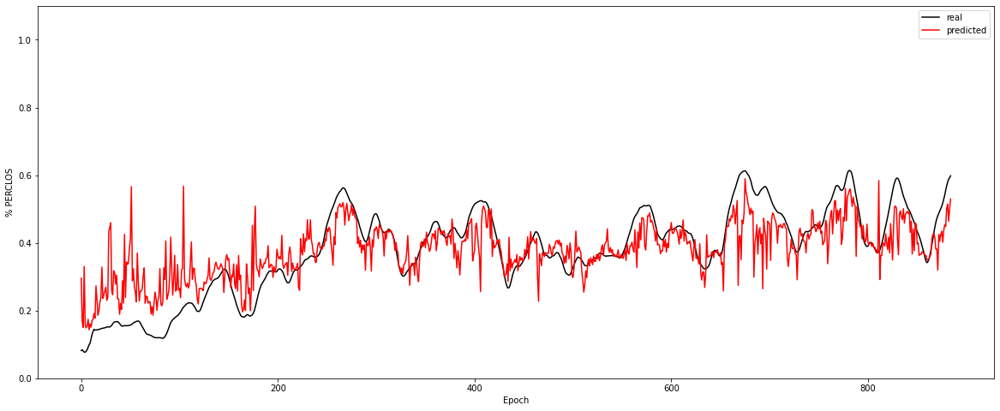

Experiment: 7_20151015_night
	RMSE: 0.0405
	r^2: 0.8756


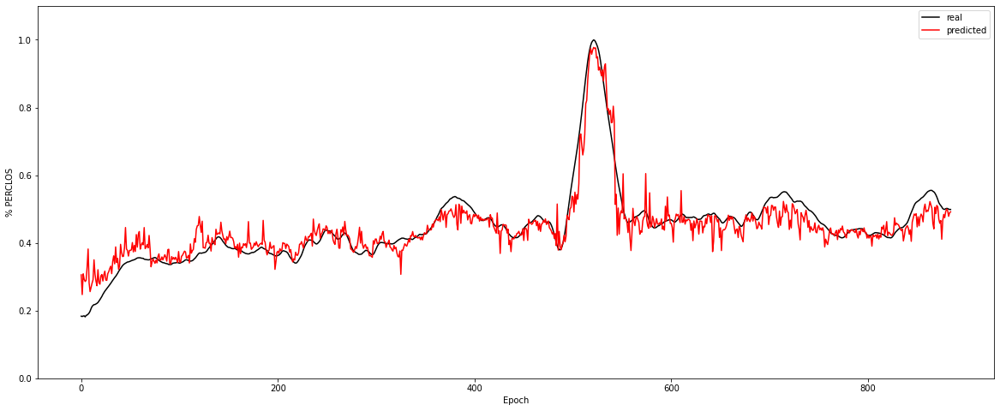

Experiment: 8_20151022_noon
	RMSE: 0.0500
	r^2: 0.9565


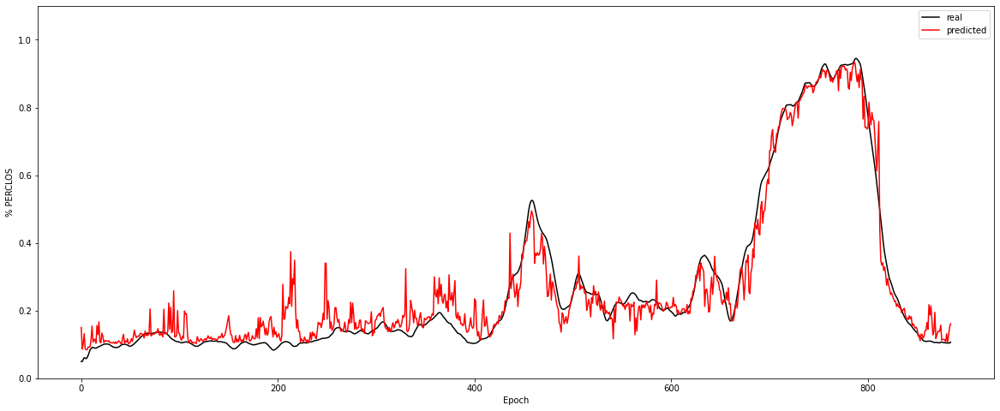

Experiment: 9_20151017_night
	RMSE: 0.0547
	r^2: 0.7996


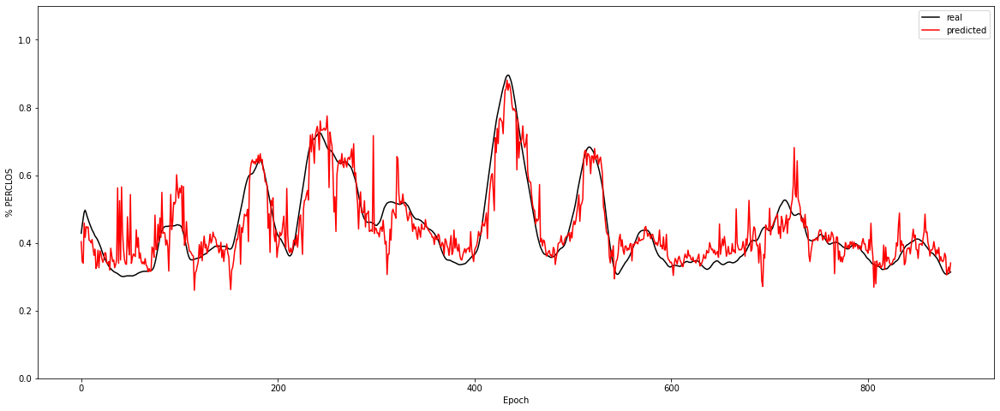

Experiment: 10_20151125_noon
	RMSE: 0.0759
	r^2: 0.7279


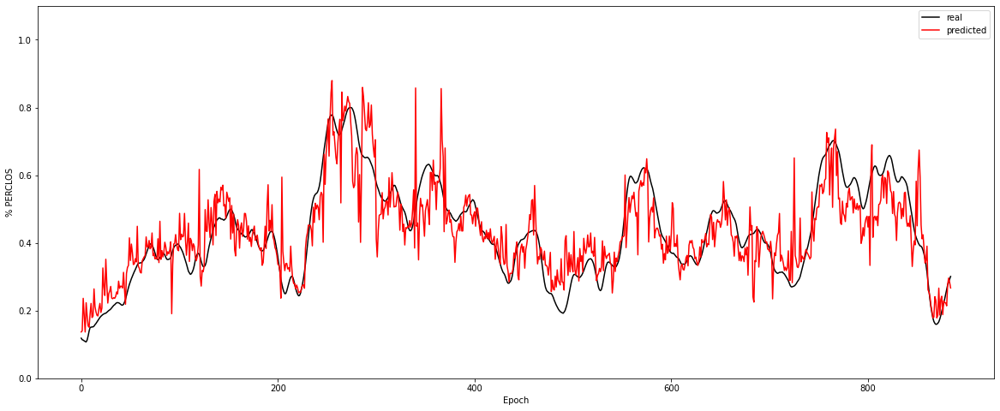

Experiment: 11_20151024_night
	RMSE: 0.0579
	r^2: 0.8070


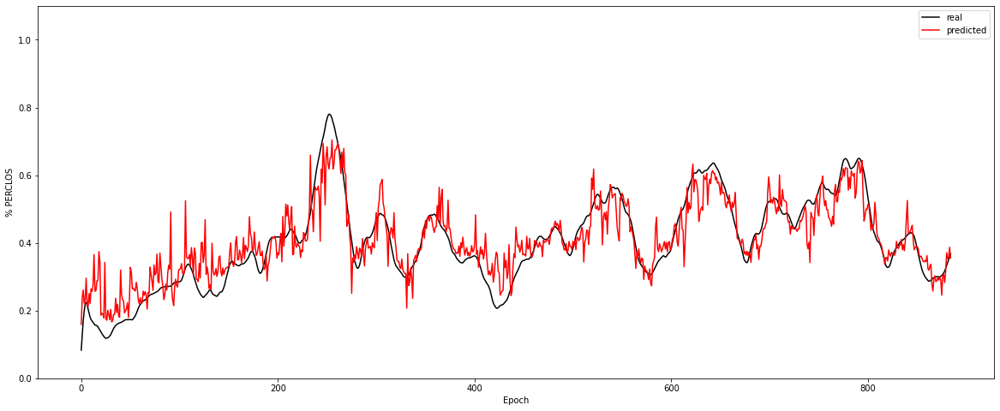

Experiment: 12_20150928_noon
	RMSE: 0.0895
	r^2: 0.9437


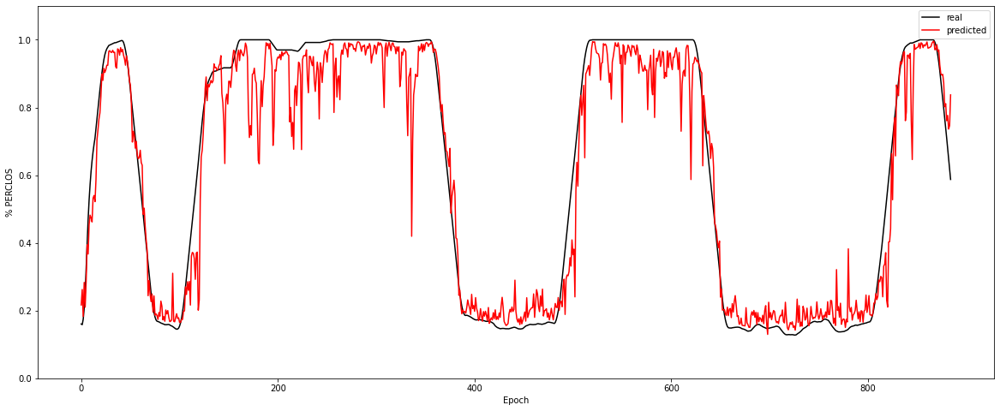

Experiment: 13_20150929_noon
	RMSE: 0.0808
	r^2: 0.8377


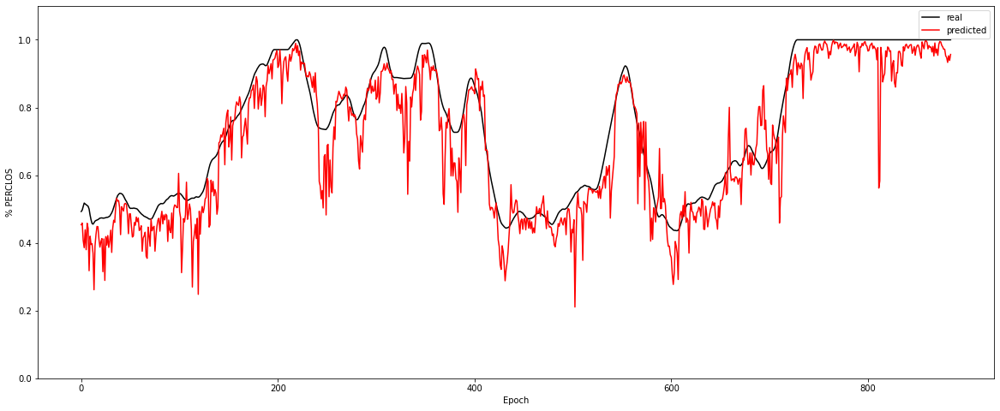

Experiment: 14_20151014_night
	RMSE: 0.0887
	r^2: 0.8487


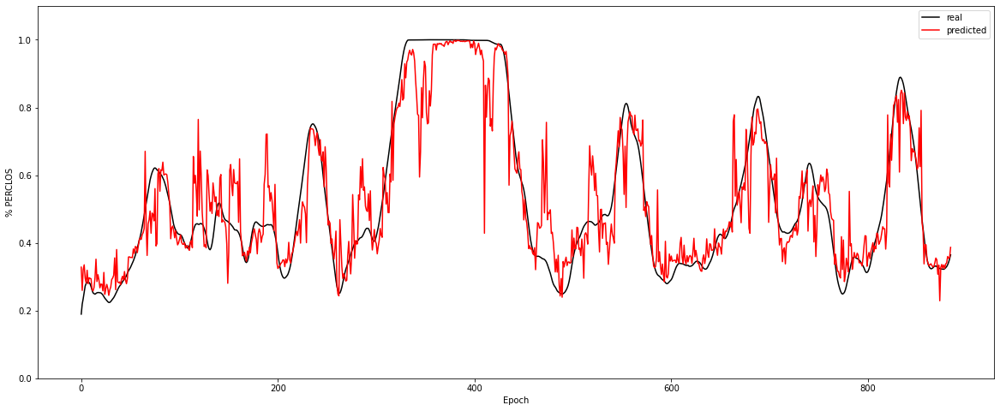

Experiment: 15_20151126_night
	RMSE: 0.0610
	r^2: 0.8607


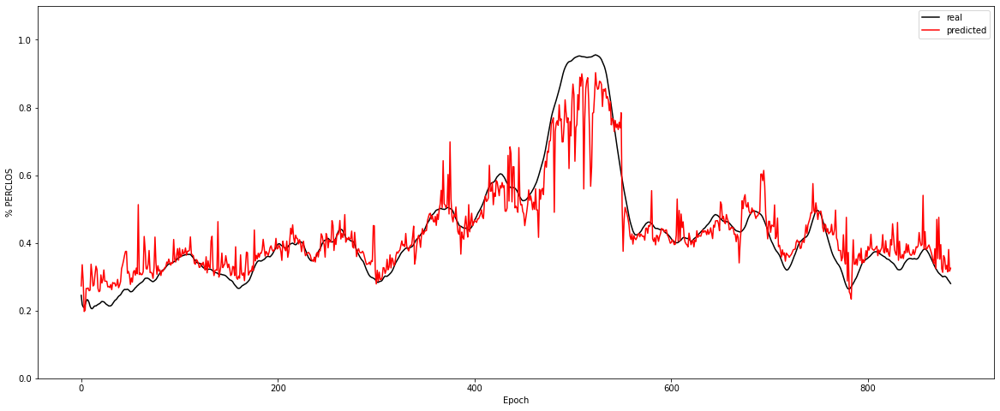

Experiment: 16_20151128_night
	RMSE: 0.0845
	r^2: 0.9316


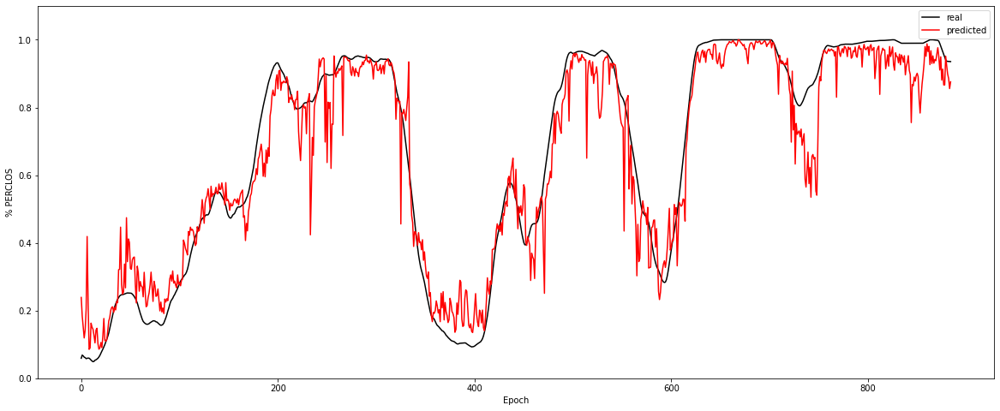

Experiment: 17_20150925_noon
	RMSE: 0.0599
	r^2: 0.9099


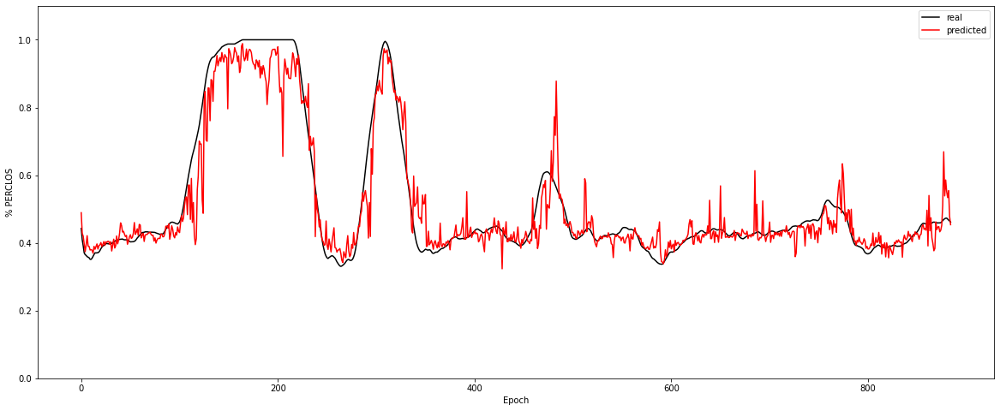

Experiment: 18_20150926_noon
	RMSE: 0.0624
	r^2: 0.9663


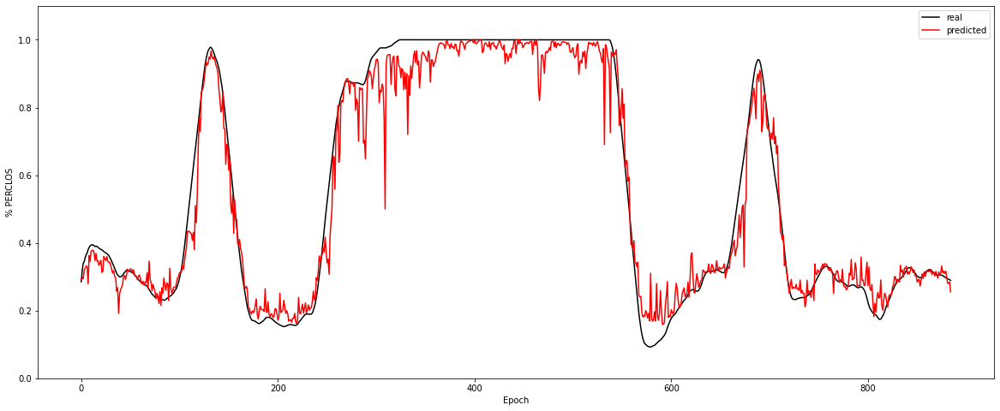

Experiment: 19_20151114_noon
	RMSE: 0.0626
	r^2: 0.7168


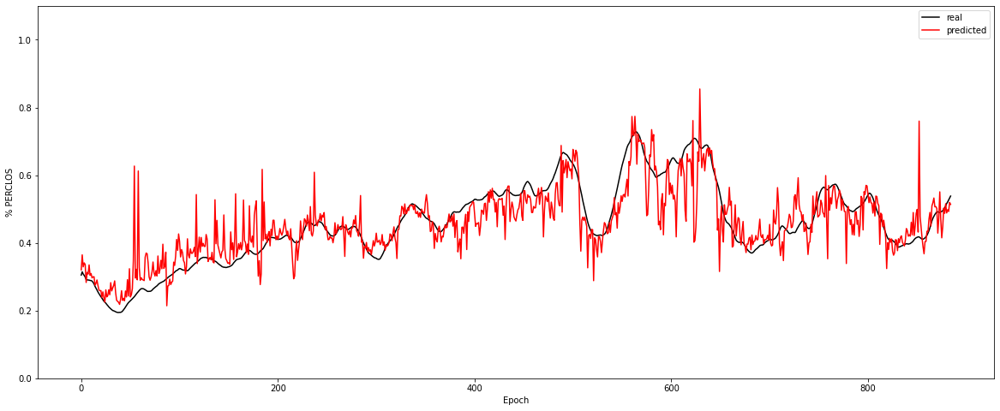

Experiment: 20_20151129_night
	RMSE: 0.1436
	r^2: 0.8402


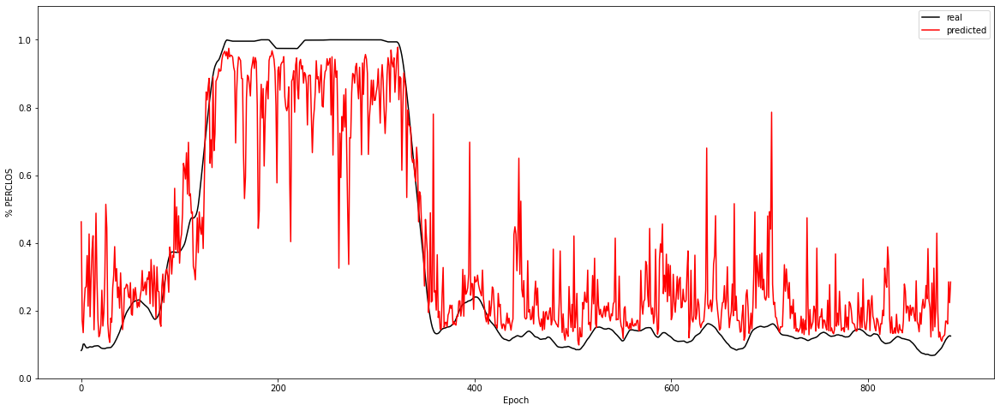

Experiment: 21_20151016_noon
	RMSE: 0.1071
	r^2: 0.8916


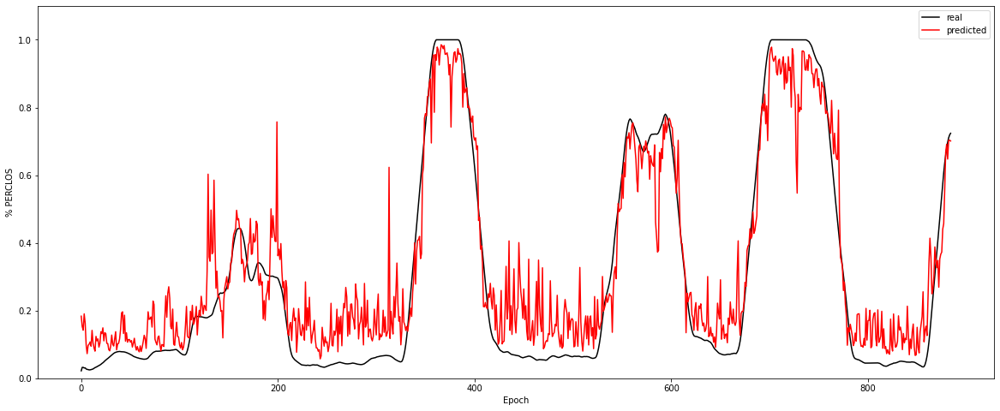

In [94]:
for key in X_all:
    data = X_all_eog[key]
    expected = y_all[key]
    predictions = general_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

# Modelo 90-10
- 21/23 = ~9%
- 2/23 = ~10%X_eog

In [8]:
# Separamos 2 experimentos para hacer las pruebas
subset_train, subset_test = train_test_split(features_files, test_size=2, random_state=77)

X_sub = []
X_sub_eog = []
y_sub = []

for key in subset_train:
    X_sub.append(X_all[key[:-4]])
    X_sub_eog.append(X_all_eog[key[:-4]])
    y_sub.append(y_all[key[:-4]])

X_sub = np.array(X_sub)
X_sub = X_sub.reshape((X_sub.shape[0]*X_sub.shape[1], X_sub.shape[2]))
X_sub_eog = np.array(X_sub_eog)
X_sub_eog = X_sub_eog.reshape((X_sub_eog.shape[0]*X_sub_eog.shape[1], X_sub_eog.shape[2]))
y_sub = np.array(y_sub)
y_sub = y_sub.reshape((y_sub.shape[0]*y_sub.shape[1]))

In [9]:
print(f'{X_sub.shape}, {X_sub_eog.shape}')

(18585, 5), (18585, 6)


## SMV-r

In [10]:
from sklearn.svm import SVR

### SMV-r PSD

In [12]:
print(f"Experiment: Modelo 90-10 SVM-r PSD")
model = SVR()

space = dict()

space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['tol'] = uniform(1e-5, 1e-1)
space['C'] = randint(1, 500)
space['epsilon'] = uniform(0.01, 0.5)
space['shrinking'] = [True, False]

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub, y_sub, model, space, cv=10,  n_iter=10)

Experiment: Modelo 90-10 SVM-r PSD
Best Model:
	Score: 0.4182
	Hyperparameters: {'C': 100, 'epsilon': 0.08143340896097039, 'gamma': 'scale', 'kernel': 'rbf', 'shrinking': True, 'tol': 0.09700098521619943}

Results with X_test:
	RMSE: 0.2085
	r^2: 0.4059


Experiment: 13_20150929_noon
	RMSE: 0.2978
	r^2: -1.2036


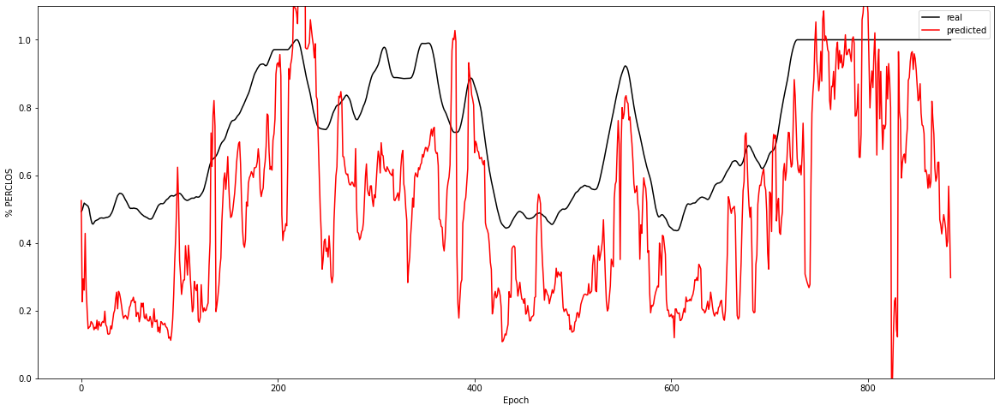

Experiment: 7_20151015_night
	RMSE: 0.2182
	r^2: -2.6127


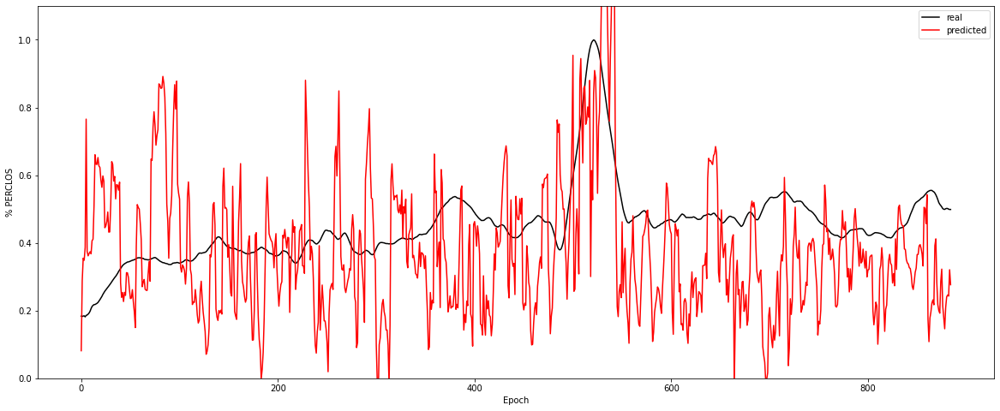

In [13]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### SMV-r PSD + EOG

In [14]:
print(f"Experiment: Modelo 90-10 SVM-r PSD + EOG")
model = SVR()

space = dict()

space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['tol'] = uniform(1e-5, 1e-1)
space['C'] = randint(1, 500)
space['epsilon'] = uniform(0.01, 0.5)
space['shrinking'] = [True, False]

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub_eog, y_sub, model, space, cv=10,  n_iter=10)

Experiment: Modelo 90-10 SVM-r PSD + EOG
Best Model:
	Score: 0.5347
	Hyperparameters: {'C': 100, 'epsilon': 0.08143340896097039, 'gamma': 'scale', 'kernel': 'rbf', 'shrinking': True, 'tol': 0.09700098521619943}

Results with X_test:
	RMSE: 0.1854
	r^2: 0.5305


Experiment: 13_20150929_noon
	RMSE: 0.2706
	r^2: -0.8189


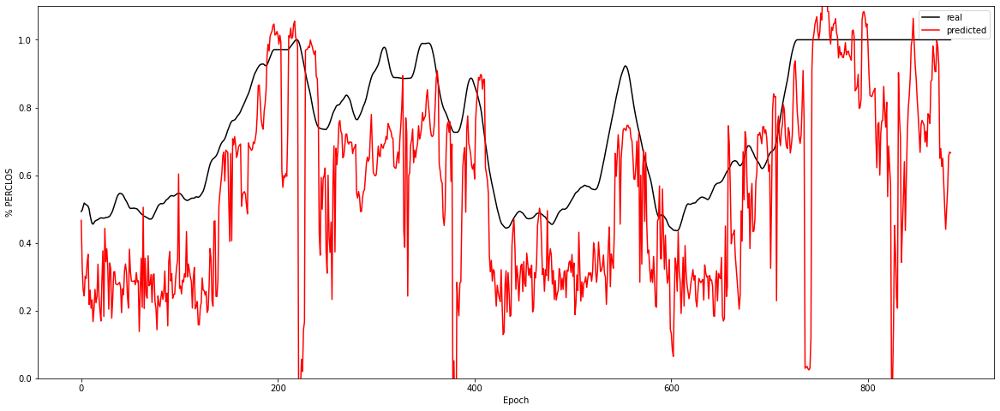

Experiment: 7_20151015_night
	RMSE: 0.2081
	r^2: -2.2837


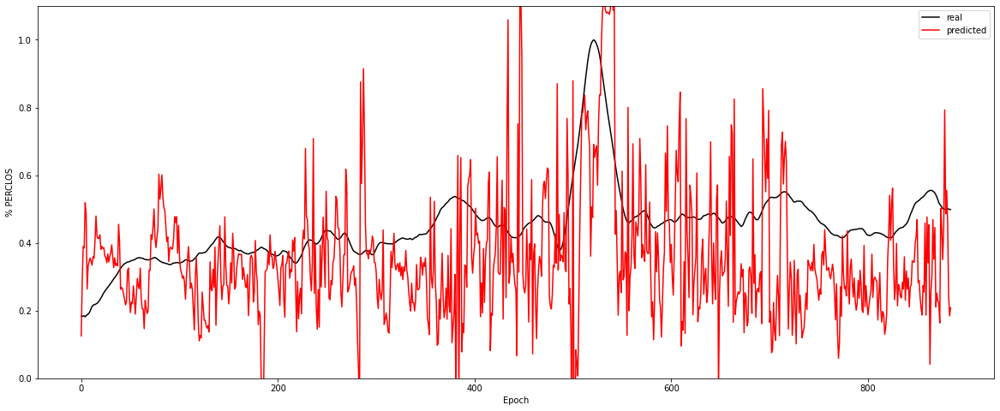

In [16]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")
    
    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

## KNN

In [17]:
from sklearn.neighbors import KNeighborsRegressor

### KNN PSD

In [18]:
print(f"Experiment: Modelo 90-10 KNN PSD")
model = KNeighborsRegressor(n_jobs=-1)

space = dict()
space['n_neighbors'] = randint(3, 25)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15, 45)
space['p'] = [1, 2]

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub, y_sub, model, space, cv=10,  n_iter=20)

Experiment: Modelo 90-10 KNN PSD
Best Model:
	Score: 0.7454
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 35, 'n_neighbors': 11, 'p': 1, 'weights': 'distance'}

Results with X_test:
	RMSE: 0.1396
	r^2: 0.7338


Experiment: 13_20150929_noon
	RMSE: 0.2601
	r^2: -0.6816


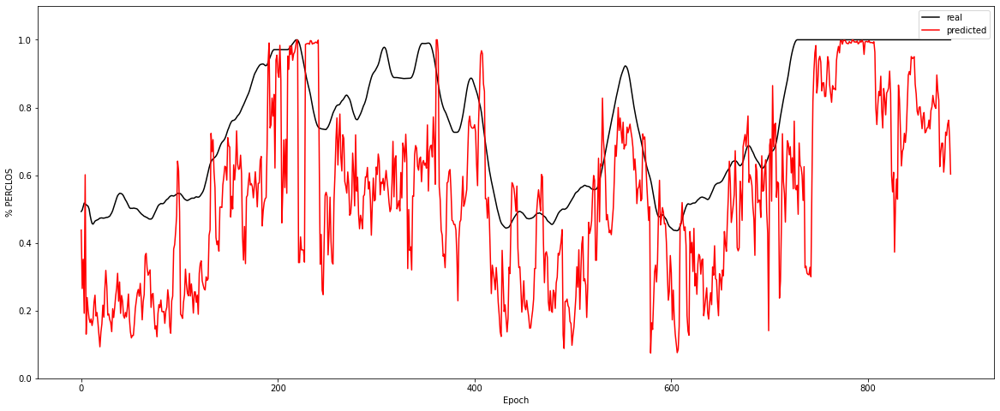

Experiment: 7_20151015_night
	RMSE: 0.1465
	r^2: -0.6283


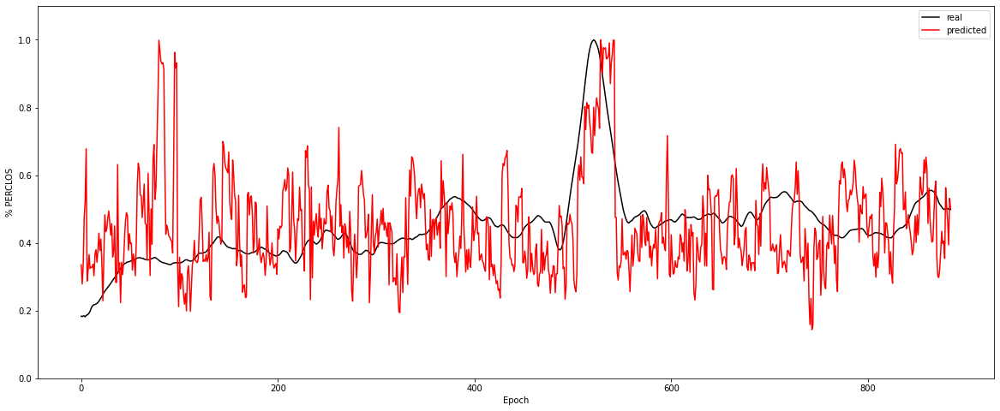

In [19]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### KNN PSD + EOG

In [20]:
print(f"Experiment: Modelo 90-10 KNN PSD+EOG")
model = KNeighborsRegressor(n_jobs=-1)

space = dict()
space['n_neighbors'] = randint(3, 25)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15, 45)
space['p'] = [1, 2]

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub_eog, y_sub, model, space, cv=10,  n_iter=20)

Experiment: Modelo 90-10 KNN PSD+EOG
Best Model:
	Score: 0.7409
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 35, 'n_neighbors': 11, 'p': 1, 'weights': 'distance'}

Results with X_test:
	RMSE: 0.1433
	r^2: 0.7195


Experiment: 13_20150929_noon
	RMSE: 0.2294
	r^2: -0.3080


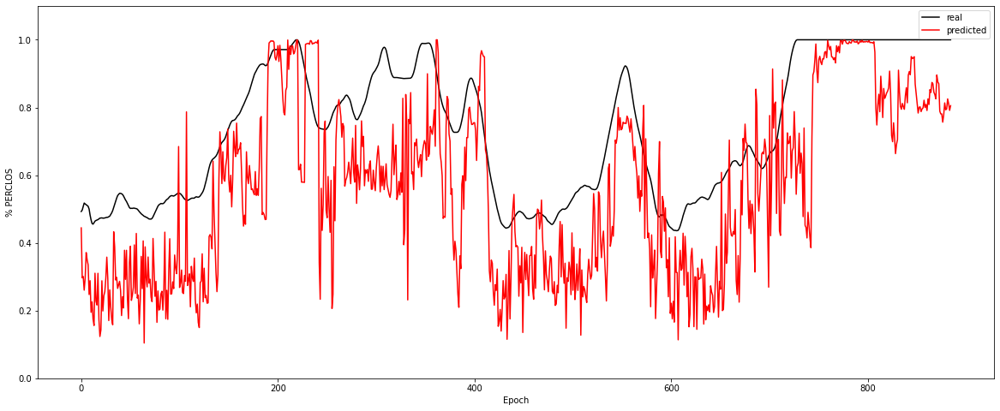

Experiment: 7_20151015_night
	RMSE: 0.1309
	r^2: -0.2990


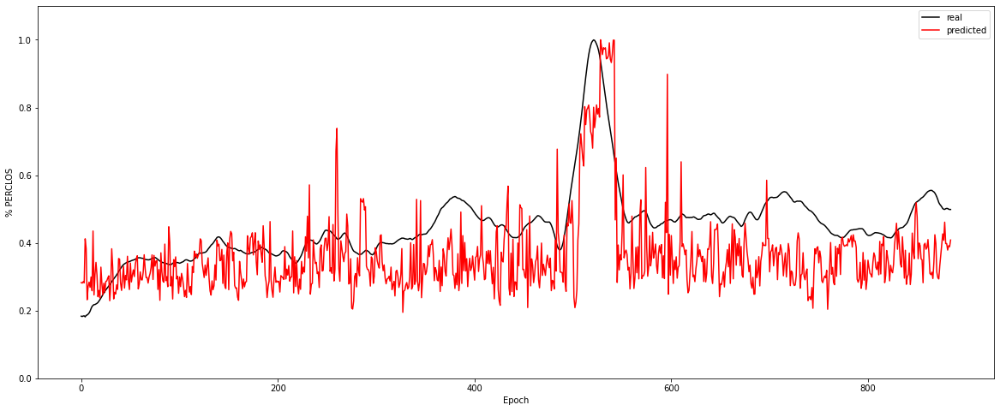

In [21]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")
    
    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

## Decision Tree

In [22]:
from sklearn.tree import DecisionTreeRegressor

### Decision Tree PSD

In [23]:
print(f"Experiment: Modelo 90-10 Decision Tree PSD")
model = DecisionTreeRegressor(random_state=42)

space = dict()
space['criterion'] = ['mse', 'friedman_mse']
space['splitter'] = ["best", "random"]
space['max_depth'] = [None]
space['min_samples_split'] = [2]
space['min_samples_leaf'] = [1]
space['max_features'] = ["auto", "sqrt", "log2"]

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub, y_sub, model, space, cv=10,  n_iter=100)

Experiment: Modelo 90-10 Decision Tree PSD


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:289: UserWarning: The total space of parameters 12 is smaller than n_iter=100. Running 12 iterations. For exhaustive searches, use GridSearchCV.
  % (grid_size, self.n_iter, grid_size), UserWarning)


Best Model:
	Score: 0.5880
	Hyperparameters: {'splitter': 'best', 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'auto', 'max_depth': None, 'criterion': 'mse'}

Results with X_test:
	RMSE: 0.1773
	r^2: 0.5706


In [24]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2707
psd_gamma: 0.2694
psd_theta: 0.1716
psd_delta: 0.1692
psd_betha: 0.1191


Experiment: 13_20150929_noon
	RMSE: 0.3194
	r^2: -1.5354


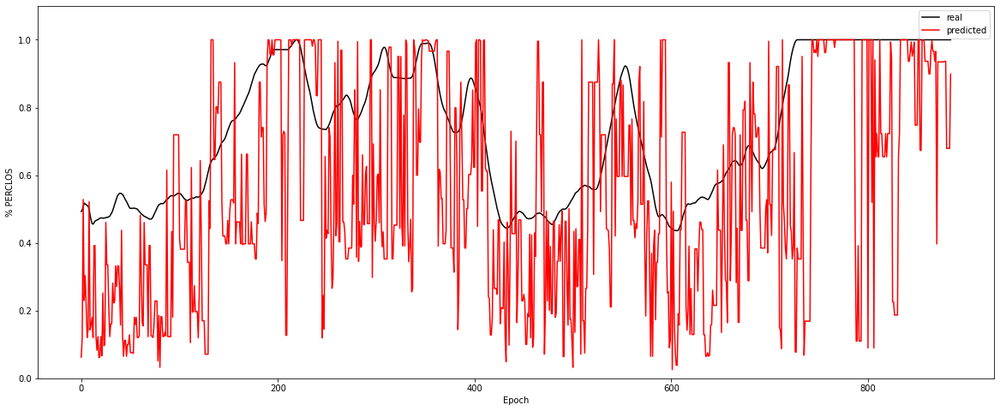

Experiment: 7_20151015_night
	RMSE: 0.3268
	r^2: -7.1028


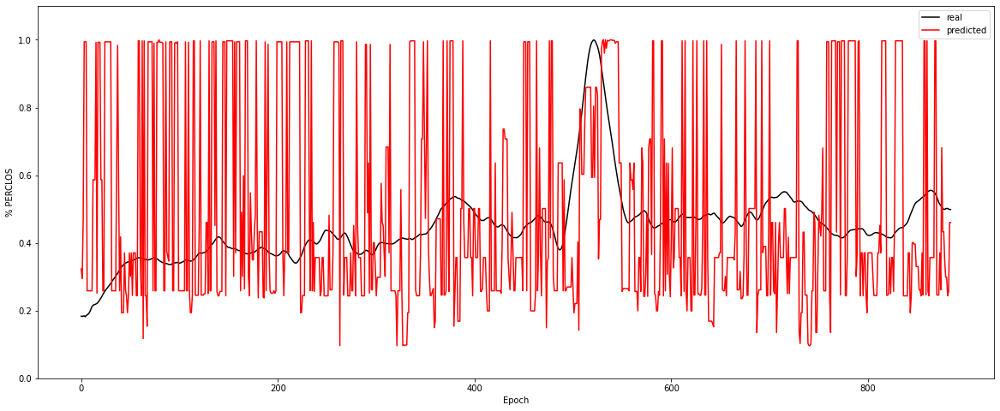

In [25]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### Decision Tree PSD + EOG

In [26]:
print(f"Experiment: Modelo 90-10 Decision Tree PSD")
model = DecisionTreeRegressor(random_state=42)

space = dict()
space['criterion'] = ['mse', 'friedman_mse']
space['splitter'] = ["best", "random"]
space['max_depth'] = [None]
space['min_samples_split'] = [2]
space['min_samples_leaf'] = [1]
space['max_features'] = ["auto", "sqrt", "log2"]

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub_eog, y_sub, model, space, cv=10,  n_iter=100)

Experiment: Modelo 90-10 Decision Tree PSD


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:289: UserWarning: The total space of parameters 12 is smaller than n_iter=100. Running 12 iterations. For exhaustive searches, use GridSearchCV.
  % (grid_size, self.n_iter, grid_size), UserWarning)


Best Model:
	Score: 0.5926
	Hyperparameters: {'splitter': 'best', 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'auto', 'max_depth': None, 'criterion': 'mse'}

Results with X_test:
	RMSE: 0.1741
	r^2: 0.5860


In [27]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

n_parpadeos: 0.3399
psd_alpha: 0.1520
psd_theta: 0.1470
psd_betha: 0.1245
psd_gamma: 0.1235
psd_delta: 0.1131


Experiment: 13_20150929_noon
	RMSE: 0.2747
	r^2: -0.8756


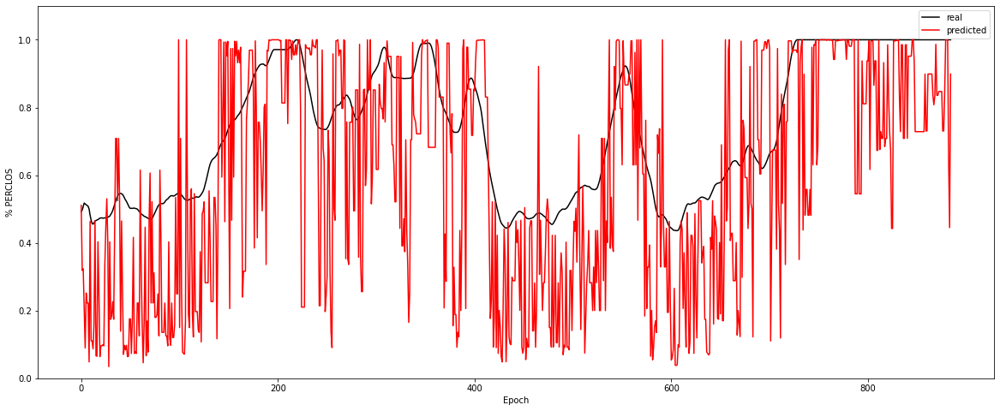

Experiment: 7_20151015_night
	RMSE: 0.1754
	r^2: -1.3332


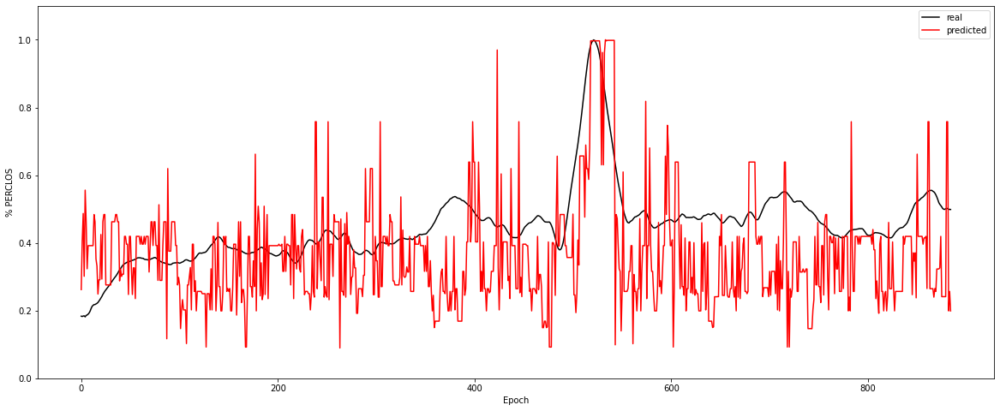

In [28]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")
    
    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

## Random Forest

In [31]:
from sklearn.ensemble import RandomForestRegressor

### Random Forest PSD

In [32]:
print(f"Experiment: Modelo 90-10 Random Forest PSD")
model = RandomForestRegressor(random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ['mse']
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'X_all_eogform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub, y_sub, model, space, cv=10,  n_iter=25)

Experiment: Modelo 90-10 Random Forest PSD
Best Model:
	Score: 0.7849
	Hyperparameters: {'criterion': 'mse', 'max_depth': 92, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	RMSE: 0.1257
	r^2: 0.7839


In [33]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2581
psd_gamma: 0.2380
psd_theta: 0.1991
psd_delta: 0.1635
psd_betha: 0.1414


Experiment: 13_20150929_noon
	RMSE: 0.2290
	r^2: -0.3030


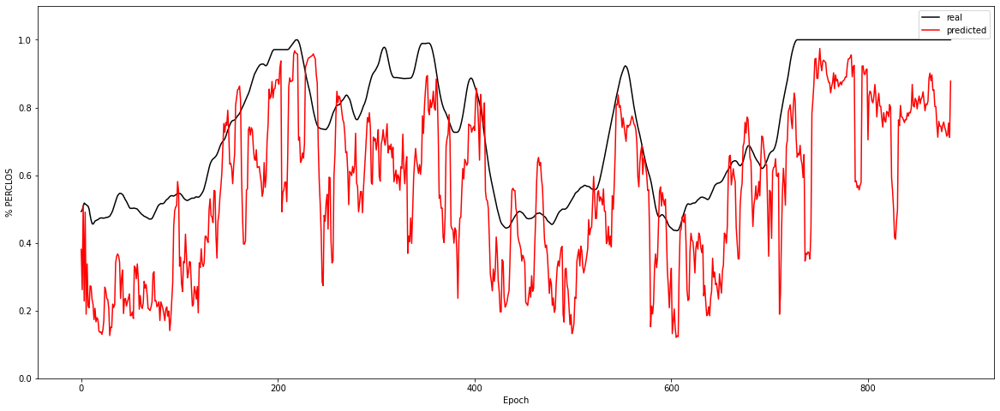

Experiment: 7_20151015_night
	RMSE: 0.1283
	r^2: -0.2489


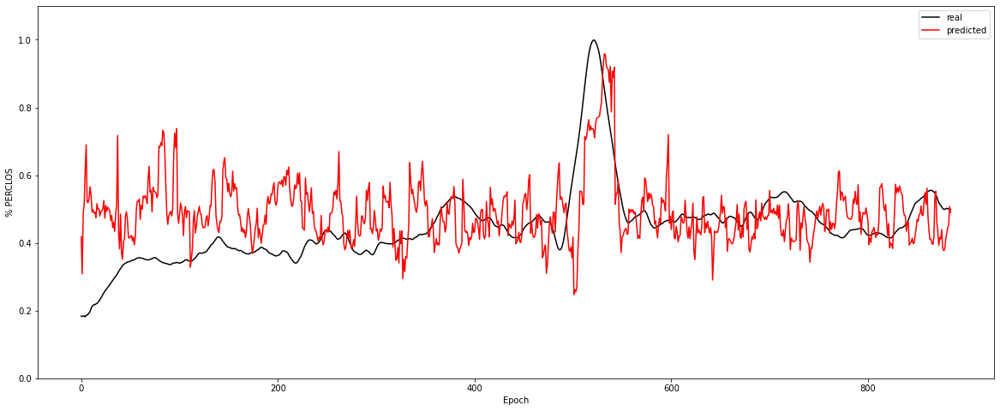

In [34]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### Random Forest PSD + EOG

In [35]:
print(f"Experiment: Modelo 90-10 Random Forest PSD")
model = RandomForestRegressor(random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ['mse']
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'X_all_eogform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub_eog, y_sub, model, space, cv=10,  n_iter=25)

Experiment: Modelo 90-10 Random Forest PSD
Best Model:
	Score: 0.7899
	Hyperparameters: {'criterion': 'mse', 'max_depth': 92, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	RMSE: 0.1265
	r^2: 0.7812


In [36]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

n_parpadeos: 0.2842
psd_alpha: 0.1827
psd_theta: 0.1576
psd_gamma: 0.1489
psd_delta: 0.1184
psd_betha: 0.1082


Experiment: 13_20150929_noon
	RMSE: 0.2102
	r^2: -0.0975


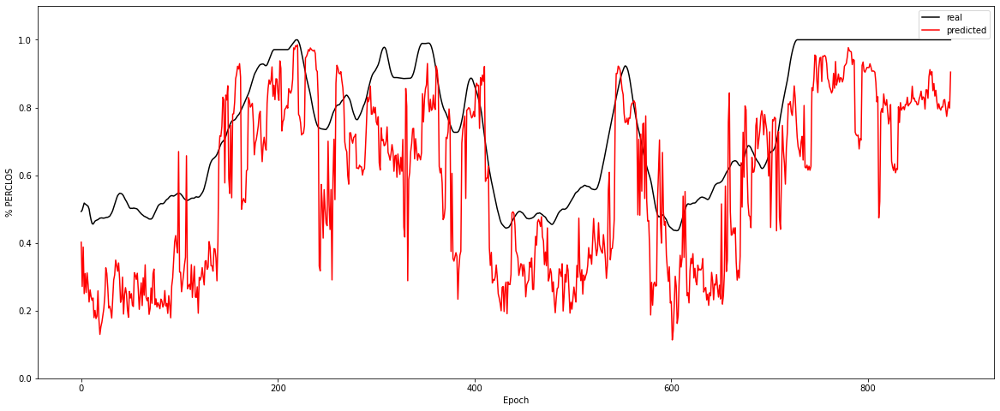

Experiment: 7_20151015_night
	RMSE: 0.1051
	r^2: 0.1626


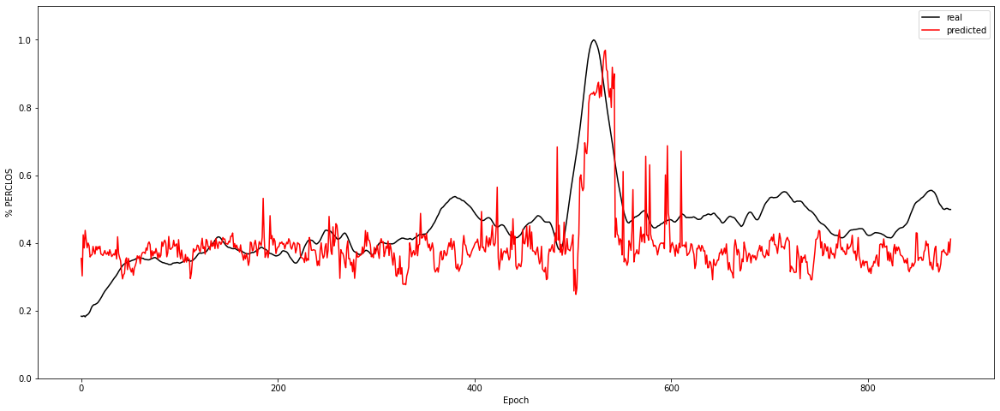

In [37]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

# Modelo 70-30
- 16/23 = ~70%
- 7/23 = ~30%X_all_eog

In [38]:
# Separamos 2 experimentos para hacer las pruebas
subset_train, subset_test = train_test_split(features_files, test_size=7, random_state=77)

X_sub = []
X_sub_eog = []
y_sub = []

for key in subset_train:
    X_sub.append(X_all[key[:-4]])
    X_sub_eog.append(X_all_eog[key[:-4]])
    y_sub.append(y_all[key[:-4]])

X_sub = np.array(X_sub)
X_sub = X_sub.reshape((X_sub.shape[0]*X_sub.shape[1], X_sub.shape[2]))
X_sub_eog = np.array(X_sub_eog)
X_sub_eog = X_sub_eog.reshape((X_sub_eog.shape[0]*X_sub_eog.shape[1], X_sub_eog.shape[2]))
y_sub = np.array(y_sub)
y_sub = y_sub.reshape((y_sub.shape[0]*y_sub.shape[1]))

In [39]:
print(f'{X_sub.shape}, {X_sub_eog.shape}')

(14160, 5), (14160, 6)


## SMV-r

In [40]:
from sklearn.svm import SVR

### SMV-r PSD

In [41]:
print(f"Experiment: Modelo 90-10 SVM-r PSD")
model = SVR()

space = dict()

space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['tol'] = uniform(1e-5, 1e-1)
space['C'] = randint(1, 500)
space['epsilon'] = uniform(0.01, 0.5)
space['shrinking'] = [True, False]

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub, y_sub, model, space, cv=10,  n_iter=10)

Experiment: Modelo 90-10 SVM-r PSD
Best Model:
	Score: 0.4588
	Hyperparameters: {'C': 100, 'epsilon': 0.08143340896097039, 'gamma': 'scale', 'kernel': 'rbf', 'shrinking': True, 'tol': 0.09700098521619943}

Results with X_test:
	RMSE: 0.2055
	r^2: 0.4664


Experiment: 13_20150929_noon
	RMSE: 0.2682
	r^2: -0.7877


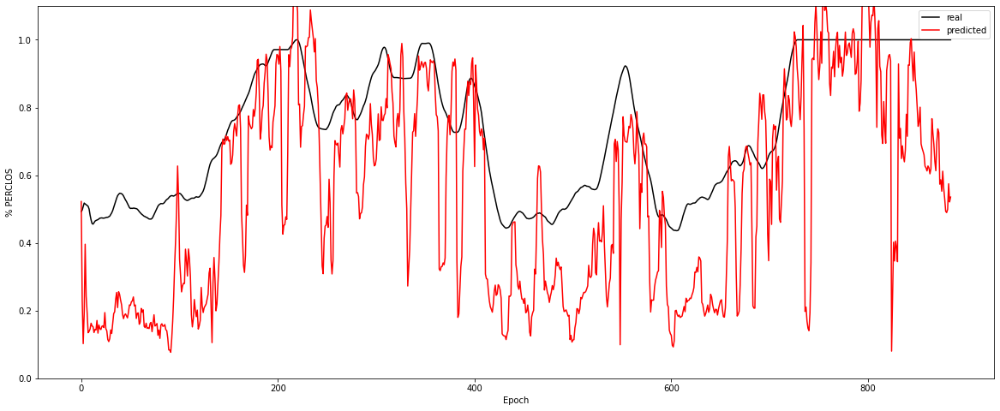

Experiment: 7_20151015_night
	RMSE: 0.3553
	r^2: -8.5736


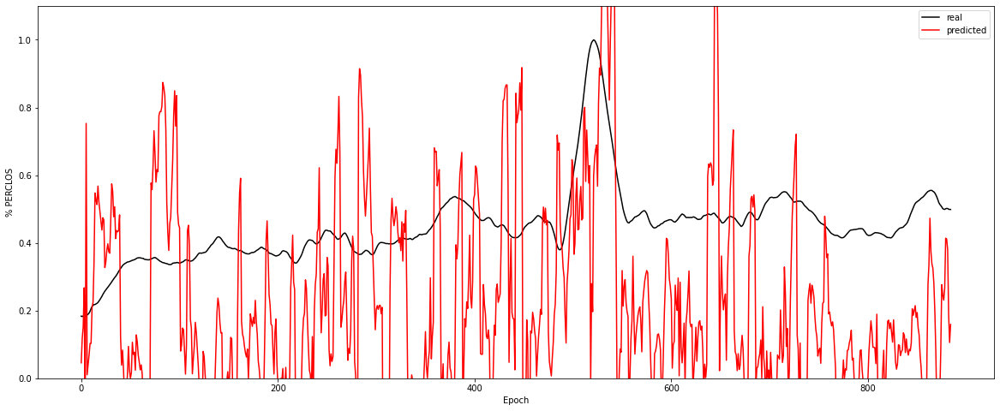

Experiment: 2_20151106_noon
	RMSE: 0.1781
	r^2: -0.1838


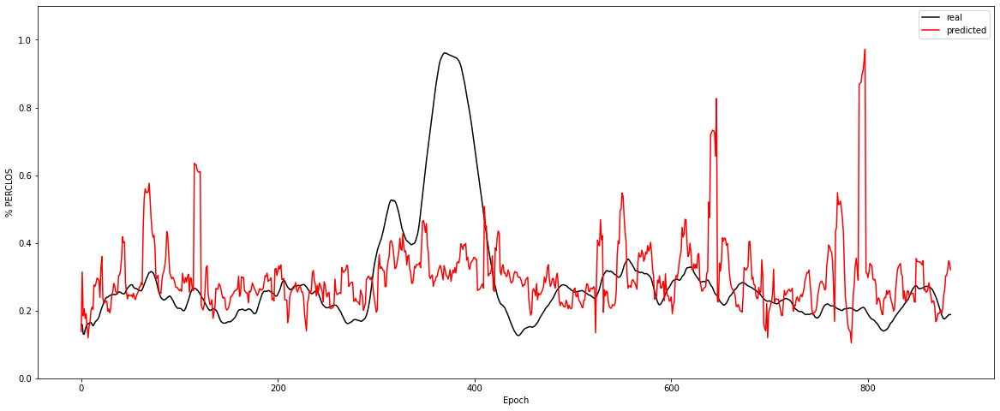

Experiment: 8_20151022_noon
	RMSE: 0.2912
	r^2: -0.4745


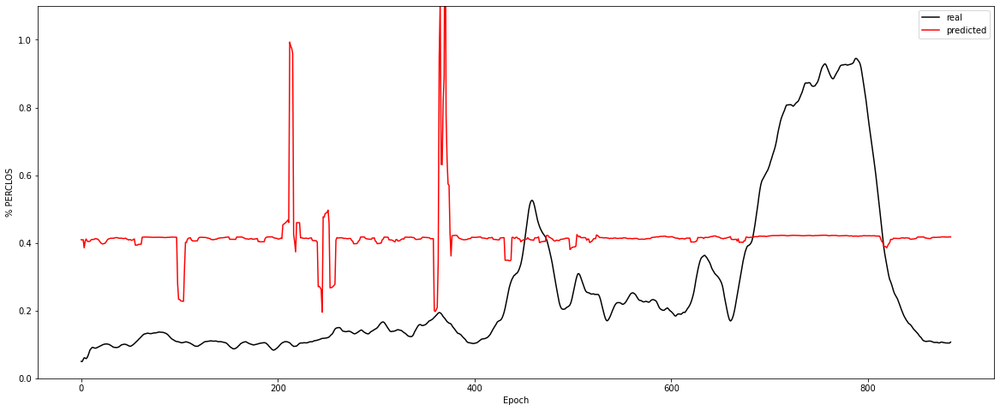

Experiment: 14_20151014_night
	RMSE: 0.2347
	r^2: -0.0586


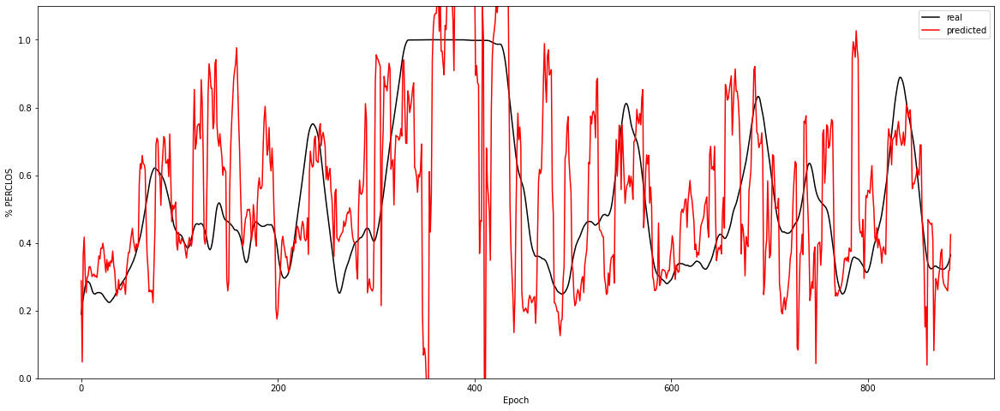

Experiment: 3_20151024_noon
	RMSE: 0.2882
	r^2: -2.1260


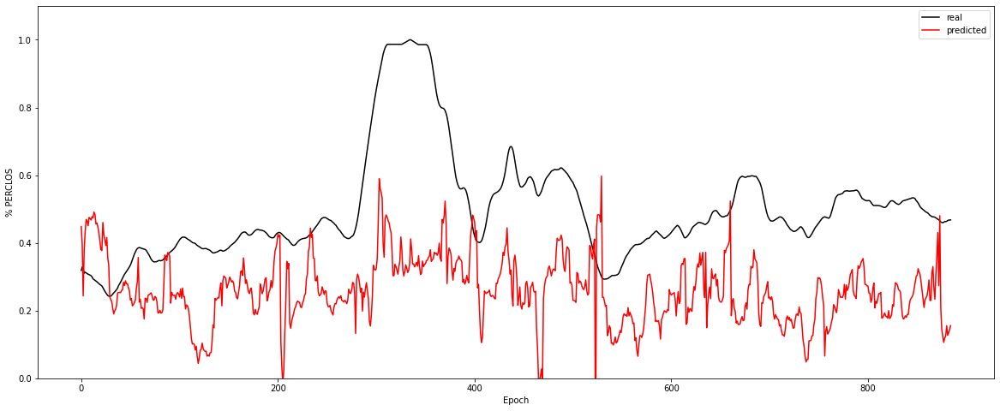

Experiment: 9_20151017_night
	RMSE: 0.1759
	r^2: -1.0715


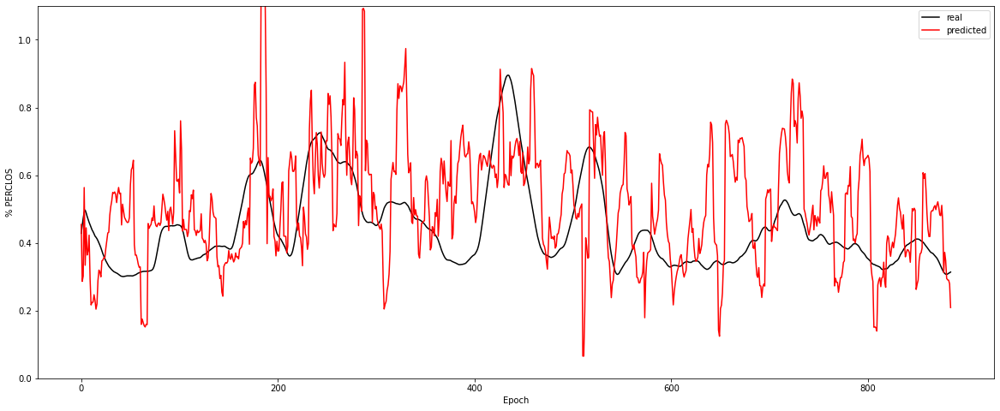

In [42]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### SMV-r PSD + EOG

In [43]:
print(f"Experiment: Modelo 90-10 SVM-r PSD + EOG")
model = SVR()

space = dict()

space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['tol'] = uniform(1e-5, 1e-1)
space['C'] = randint(1, 500)
space['epsilon'] = uniform(0.01, 0.5)
space['shrinking'] = [True, False]

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub_eog, y_sub, model, space, cv=10,  n_iter=10)

Experiment: Modelo 90-10 SVM-r PSD + EOG
Best Model:
	Score: 0.5486
	Hyperparameters: {'C': 100, 'epsilon': 0.08143340896097039, 'gamma': 'scale', 'kernel': 'rbf', 'shrinking': True, 'tol': 0.09700098521619943}

Results with X_test:
	RMSE: 0.1864
	r^2: 0.5613


Experiment: 13_20150929_noon
	RMSE: 0.2790
	r^2: -0.9348


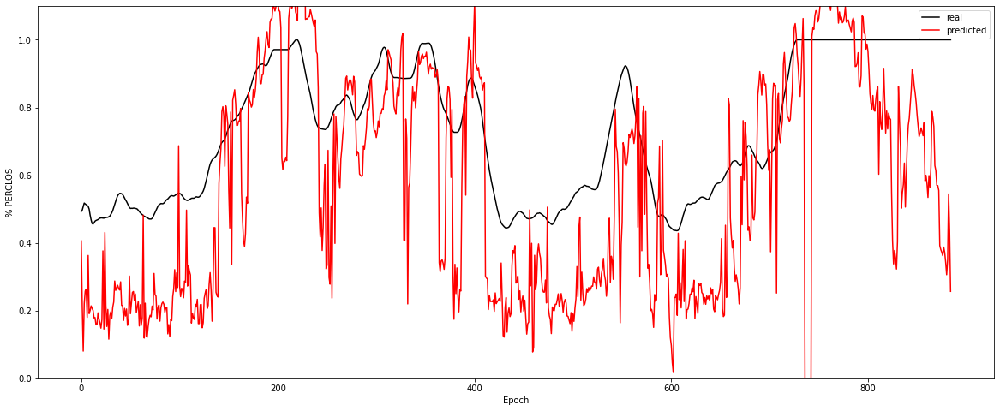

Experiment: 7_20151015_night
	RMSE: 0.3368
	r^2: -7.6066


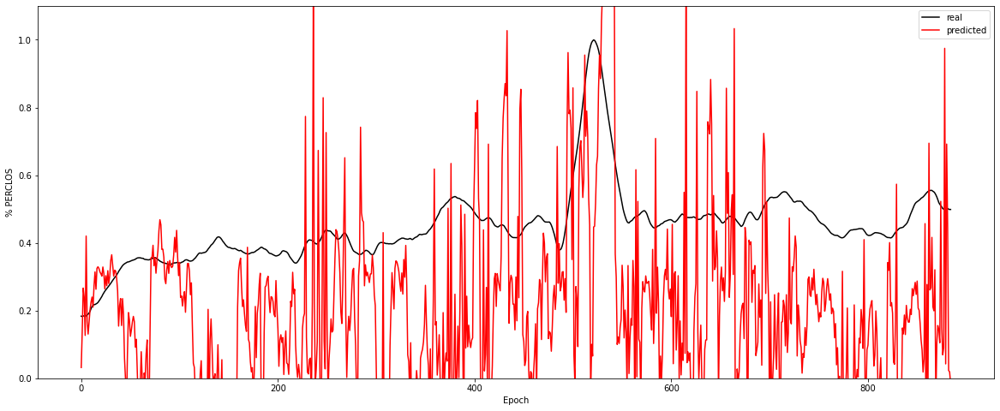

Experiment: 2_20151106_noon
	RMSE: 0.1710
	r^2: -0.0917


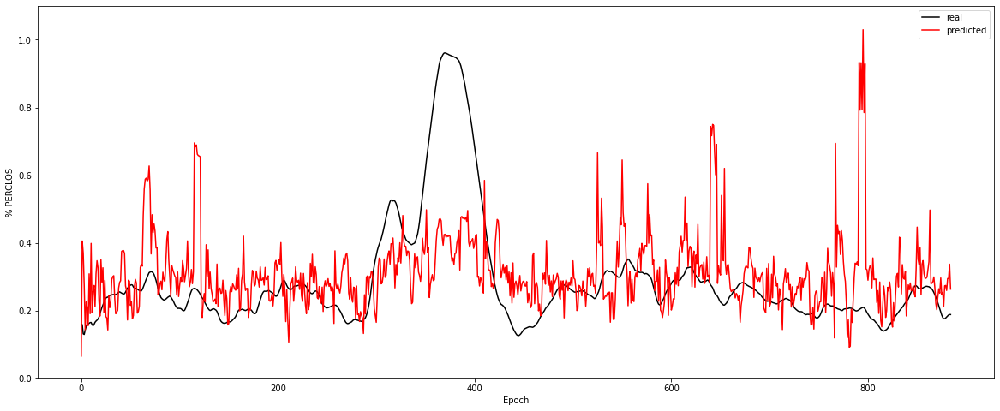

Experiment: 8_20151022_noon
	RMSE: 0.2496
	r^2: -0.0835


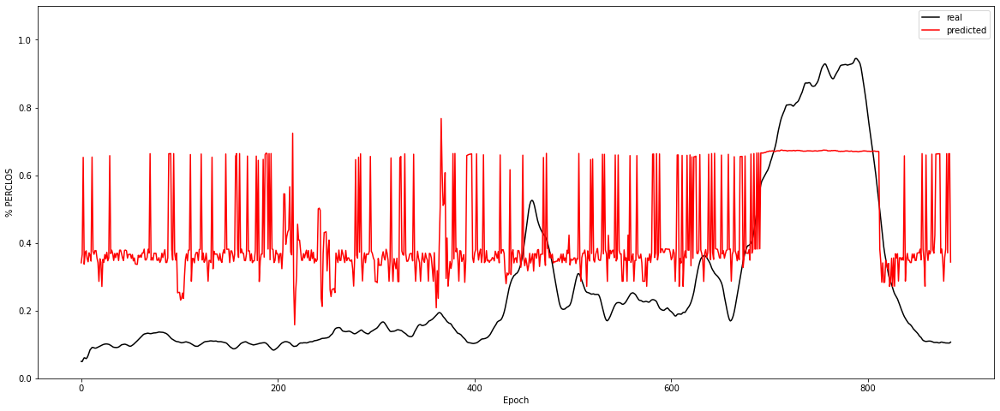

Experiment: 14_20151014_night
	RMSE: 0.2361
	r^2: -0.0716


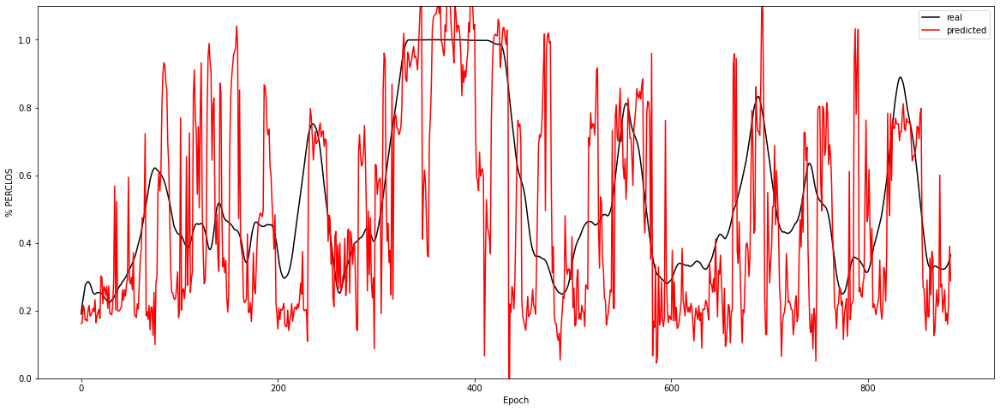

Experiment: 3_20151024_noon
	RMSE: 0.2774
	r^2: -1.8968


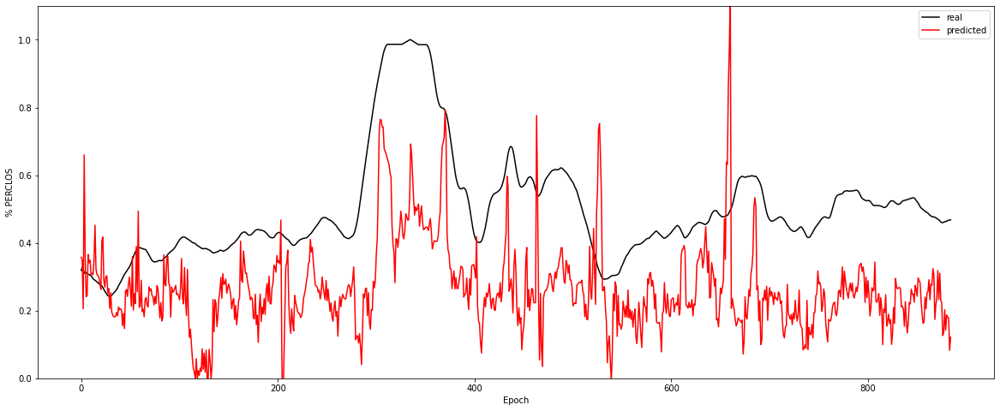

Experiment: 9_20151017_night
	RMSE: 0.1767
	r^2: -1.0915


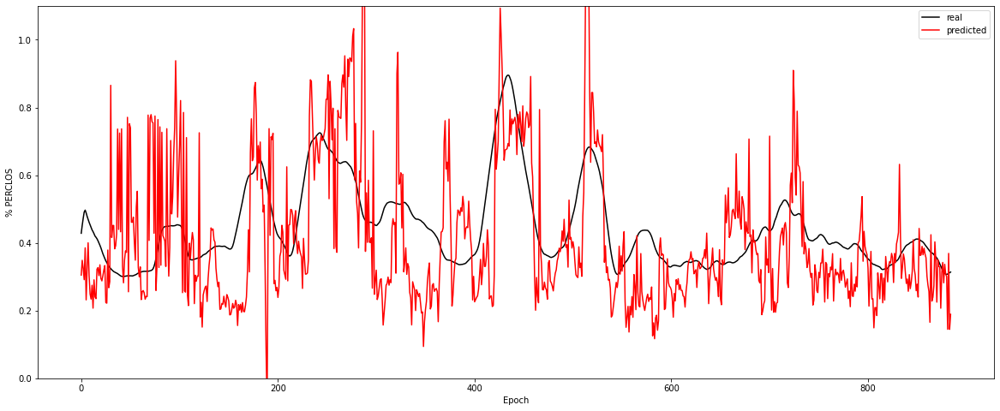

In [44]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

## KNN

In [45]:
from sklearn.neighbors import KNeighborsRegressor

### KNN PSD

In [46]:
print(f"Experiment: Modelo 70-30 KNN PSD")
model = KNeighborsRegressor(n_jobs=-1)

space = dict()
space['n_neighbors'] = randint(3, 25)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15, 45)
space['p'] = [1, 2]

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub, y_sub, model, space, cv=10,  n_iter=20)

Experiment: Modelo 70-30 KNN PSD
Best Model:
	Score: 0.7461
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 35, 'n_neighbors': 11, 'p': 1, 'weights': 'distance'}

Results with X_test:
	RMSE: 0.1377
	r^2: 0.7604


Experiment: 13_20150929_noon
	RMSE: 0.2538
	r^2: -0.6012


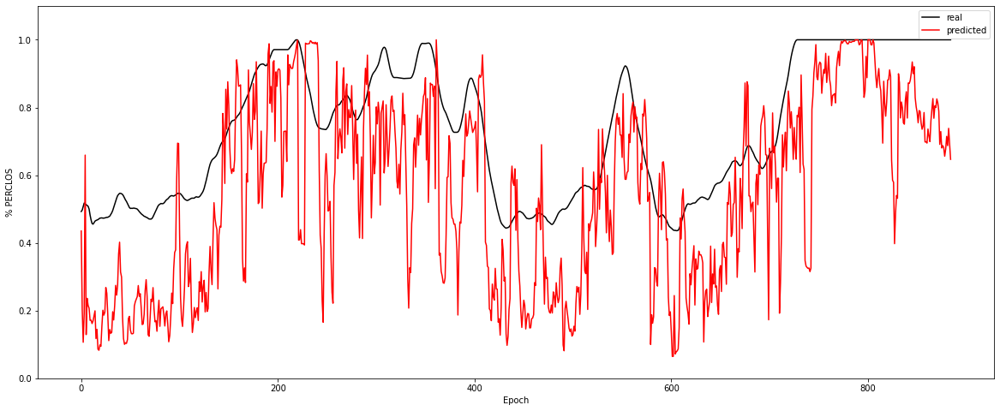

Experiment: 7_20151015_night
	RMSE: 0.1617
	r^2: -0.9823


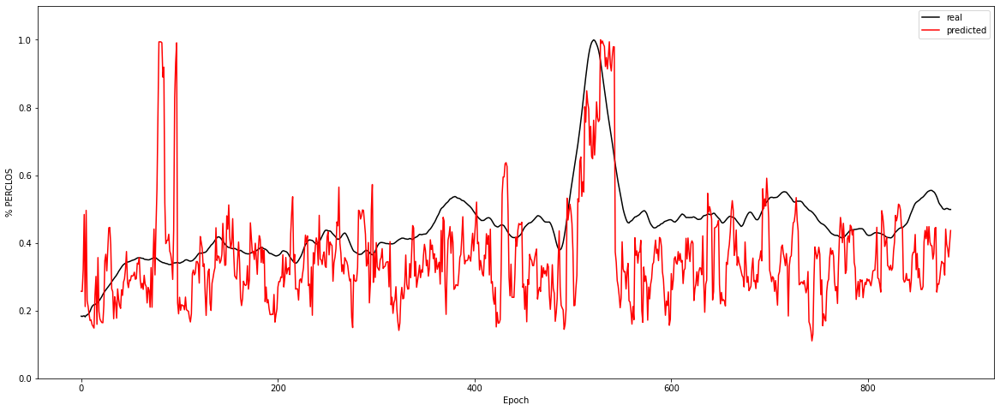

Experiment: 2_20151106_noon
	RMSE: 0.1867
	r^2: -0.3001


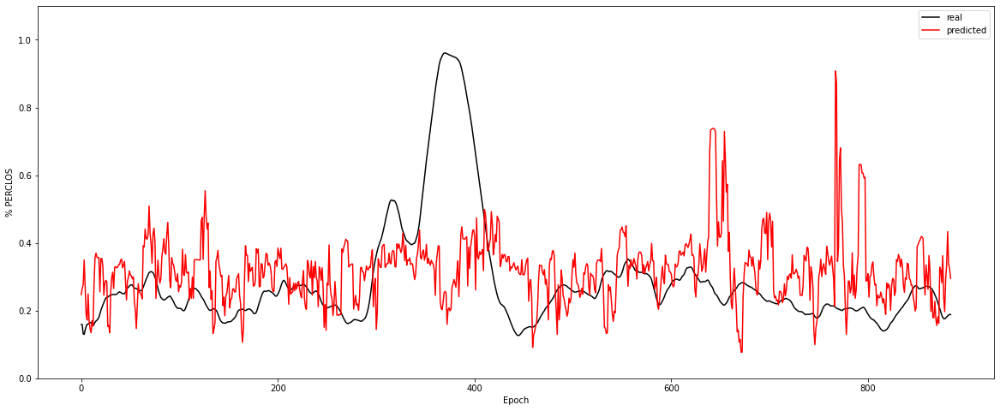

Experiment: 8_20151022_noon
	RMSE: 0.2546
	r^2: -0.1269


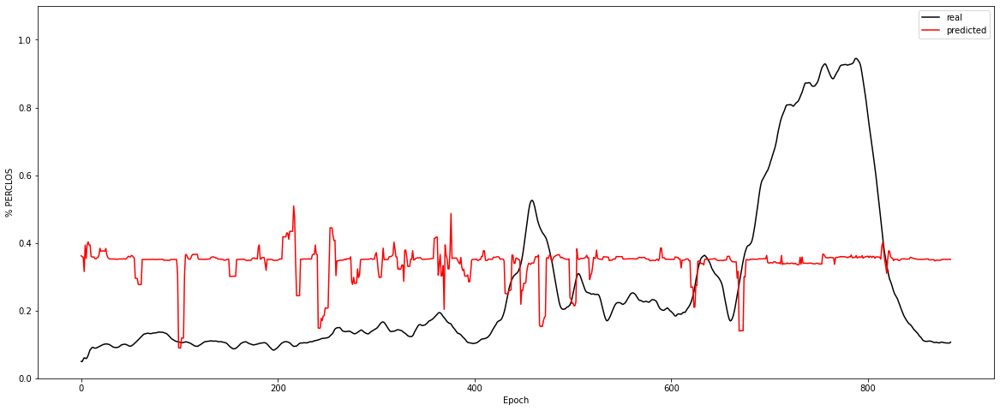

Experiment: 14_20151014_night
	RMSE: 0.2342
	r^2: -0.0546


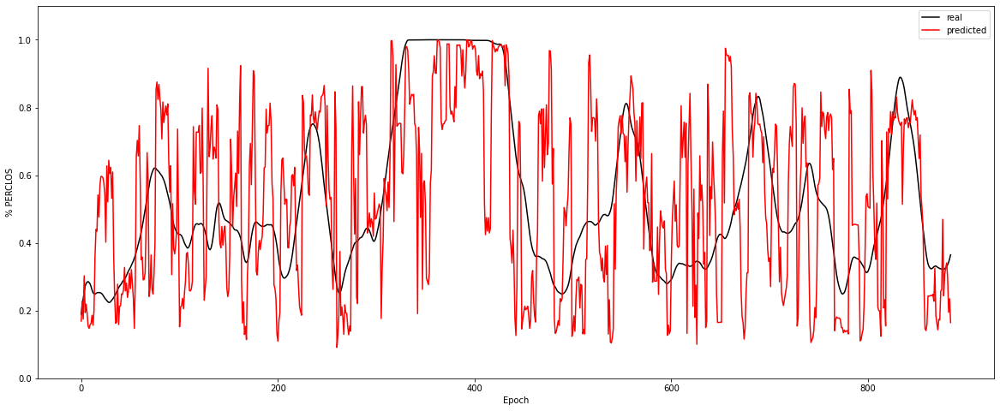

Experiment: 3_20151024_noon
	RMSE: 0.2785
	r^2: -1.9209


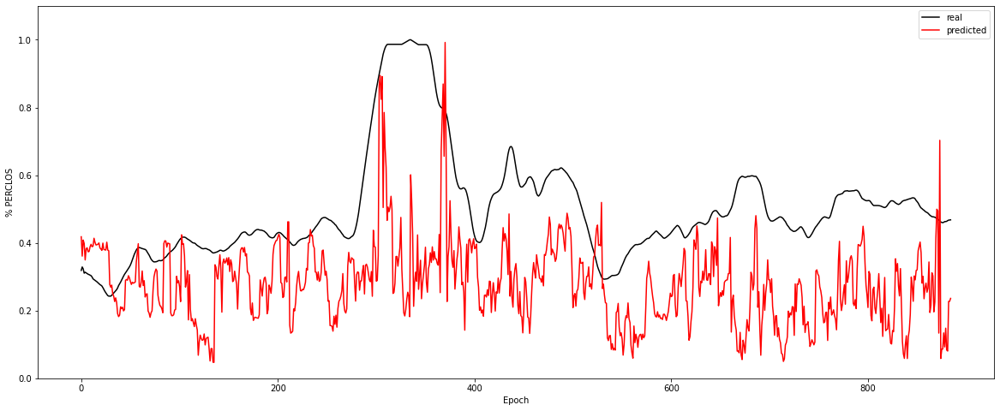

Experiment: 9_20151017_night
	RMSE: 0.1682
	r^2: -0.8945


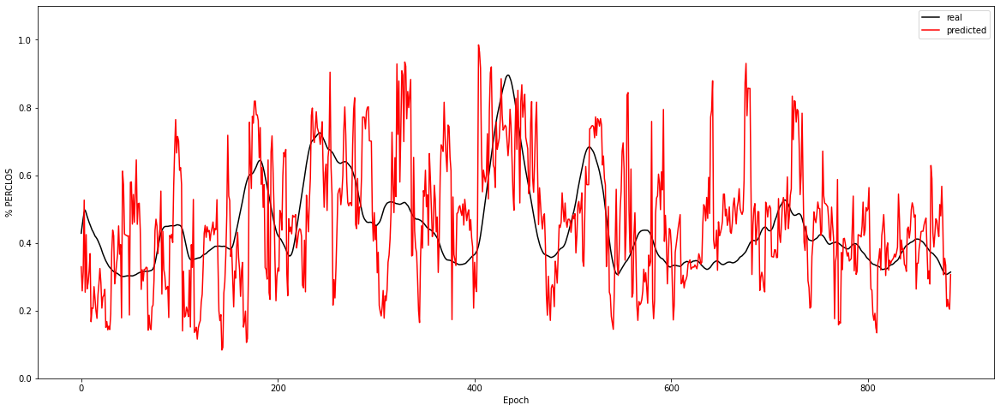

In [47]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### KNN PSD + EOG

In [48]:
print(f"Experiment: Modelo 70-30 KNN PSD")
model = KNeighborsRegressor(n_jobs=-1)

space = dict()
space['n_neighbors'] = randint(3, 25)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15, 45)
space['p'] = [1, 2]

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub_eog, y_sub, model, space, cv=10,  n_iter=20)

Experiment: Modelo 70-30 KNN PSD
Best Model:
	Score: 0.7403
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 35, 'n_neighbors': 11, 'p': 1, 'weights': 'distance'}

Results with X_test:
	RMSE: 0.1401
	r^2: 0.7520


Experiment: 13_20150929_noon
	RMSE: 0.2372
	r^2: -0.3976


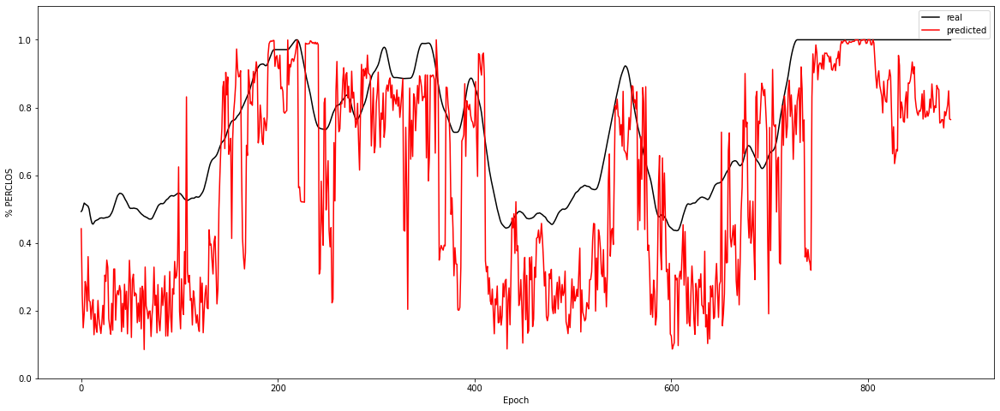

Experiment: 7_20151015_night
	RMSE: 0.1527
	r^2: -0.7683


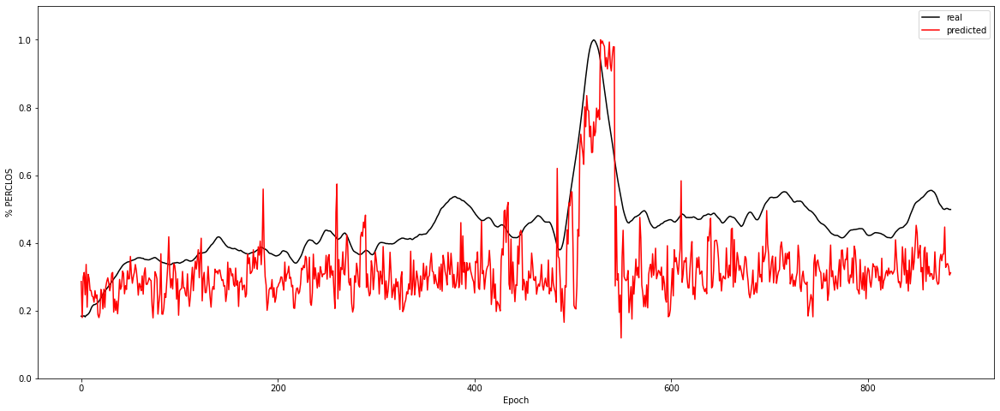

Experiment: 2_20151106_noon
	RMSE: 0.1811
	r^2: -0.2241


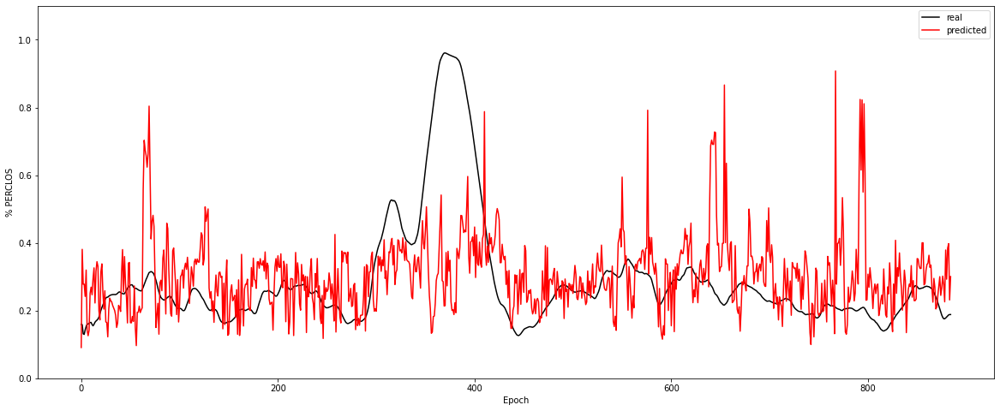

Experiment: 8_20151022_noon
	RMSE: 0.2669
	r^2: -0.2390


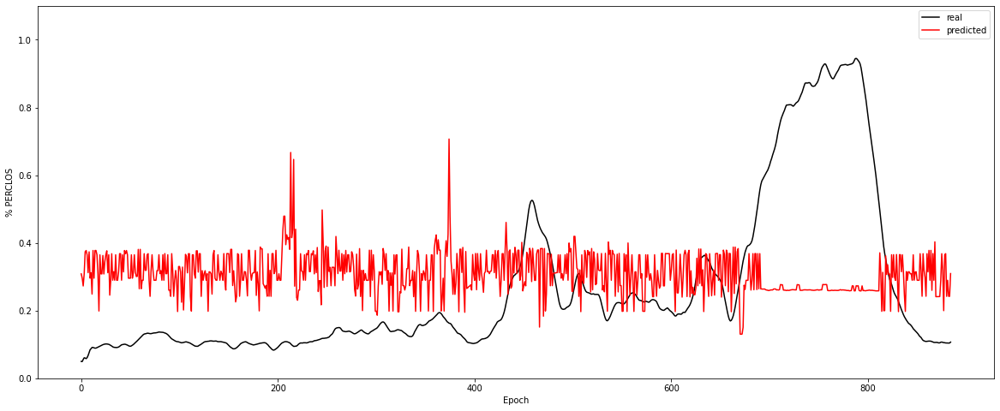

Experiment: 14_20151014_night
	RMSE: 0.2018
	r^2: 0.2170


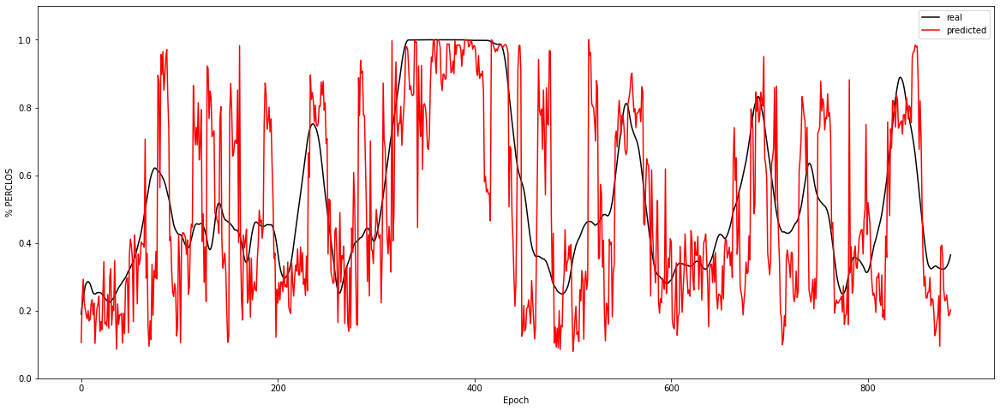

Experiment: 3_20151024_noon
	RMSE: 0.2493
	r^2: -1.3392


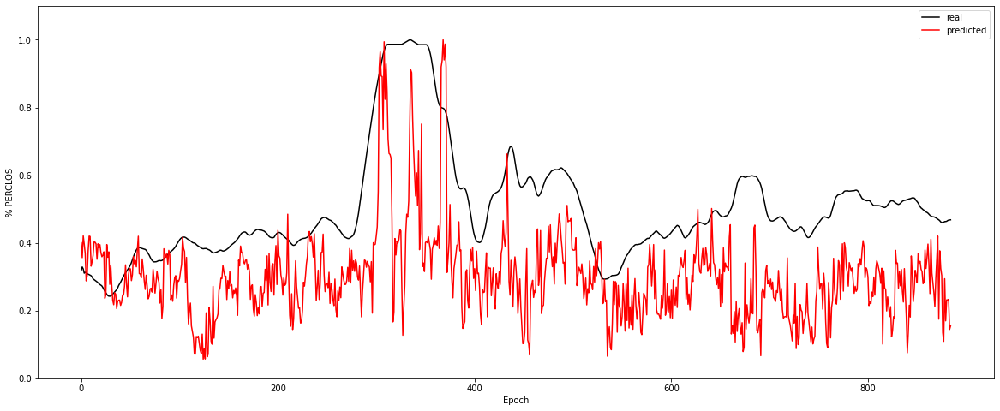

Experiment: 9_20151017_night
	RMSE: 0.1354
	r^2: -0.2275


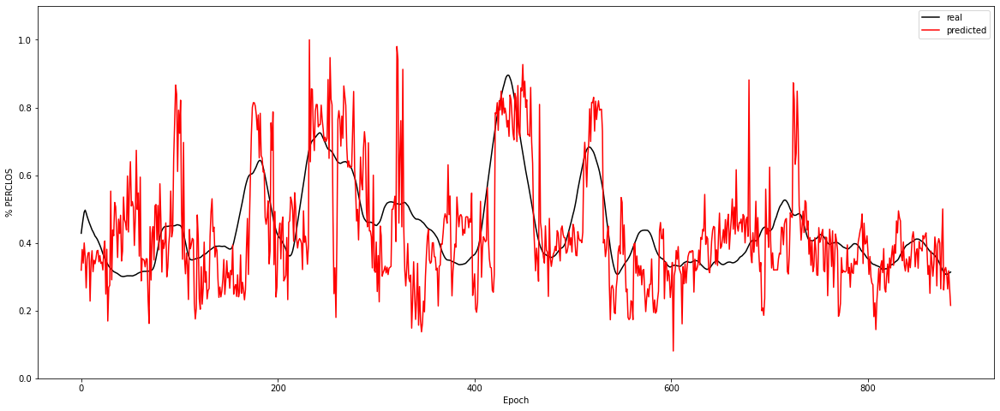

In [49]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

## Decision Tree

In [50]:
from sklearn.tree import DecisionTreeRegressor

### Decision Tree PSD

In [61]:
print(f"Experiment: Modelo 90-10 Decision Tree PSD")
model = DecisionTreeRegressor(random_state=42)

space = dict()
space['criterion'] = ['mse', 'friedman_mse']
space['splitter'] = ["best", "random"]
space['max_depth'] = [None]
space['min_samples_split'] = [2]
space['min_samples_leaf'] = [1]
space['max_features'] = ["auto", "sqrt", "log2"]

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub, y_sub, model, space, cv=10,  n_iter=10)

Experiment: Modelo 90-10 Decision Tree PSD
Best Model:
	Score: 0.6078
	Hyperparameters: {'splitter': 'best', 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'auto', 'max_depth': None, 'criterion': 'mse'}

Results with X_test:
	RMSE: 0.1776
	r^2: 0.6017


In [62]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_gamma: 0.2741
psd_alpha: 0.2370
psd_theta: 0.1923
psd_delta: 0.1890
psd_betha: 0.1075


Experiment: 13_20150929_noon
	RMSE: 0.3130
	r^2: -1.4338


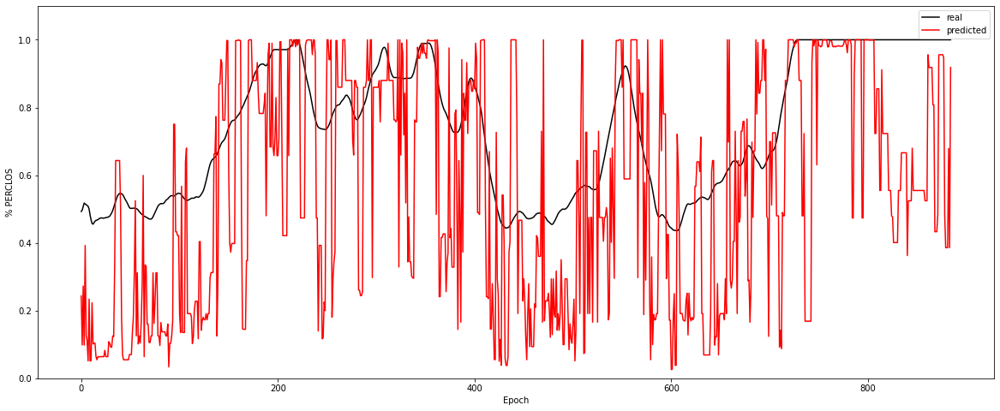

Experiment: 7_20151015_night
	RMSE: 0.1873
	r^2: -1.6623


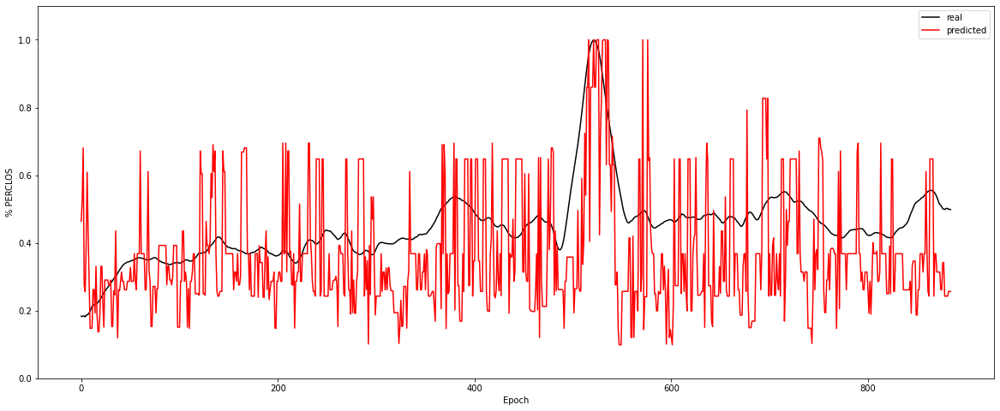

Experiment: 2_20151106_noon
	RMSE: 0.2061
	r^2: -0.5860


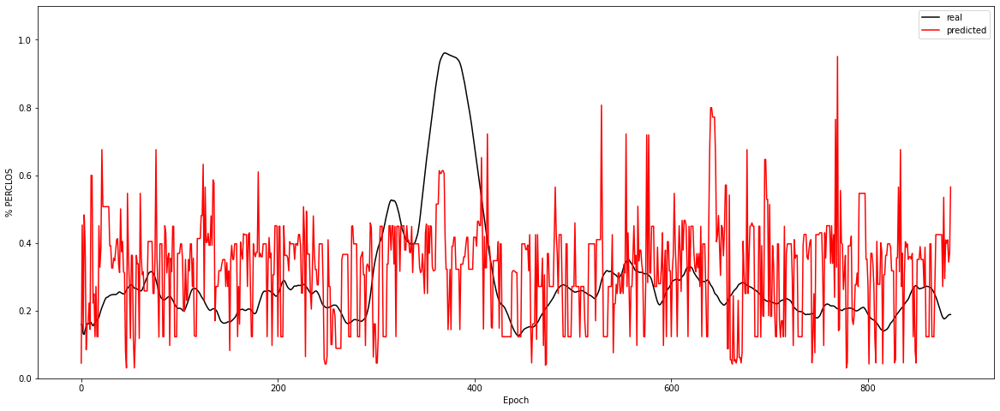

Experiment: 8_20151022_noon
	RMSE: 0.2834
	r^2: -0.3963


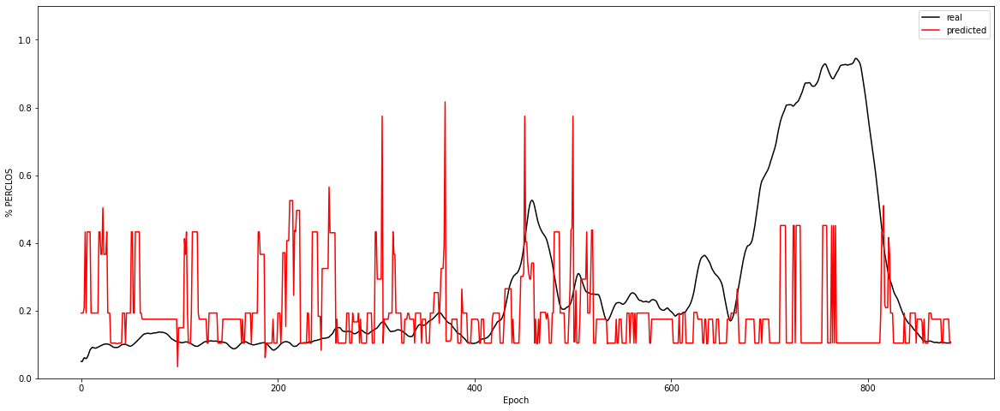

Experiment: 14_20151014_night
	RMSE: 0.3588
	r^2: -1.4742


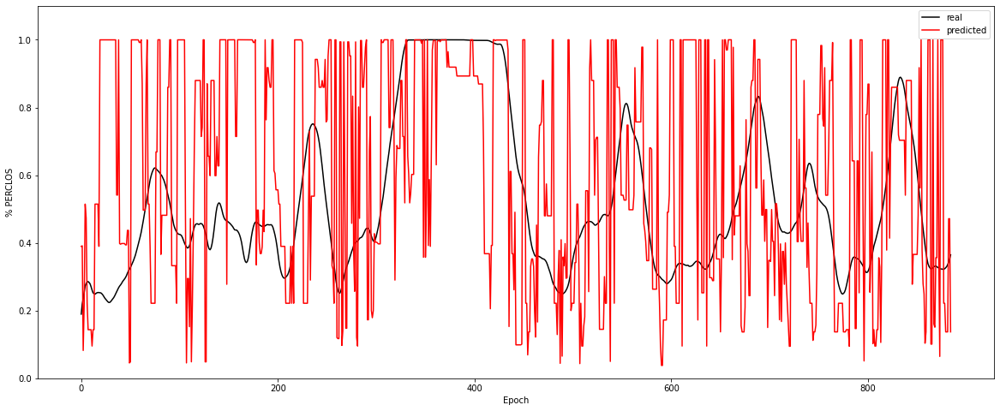

Experiment: 3_20151024_noon
	RMSE: 0.2727
	r^2: -1.7988


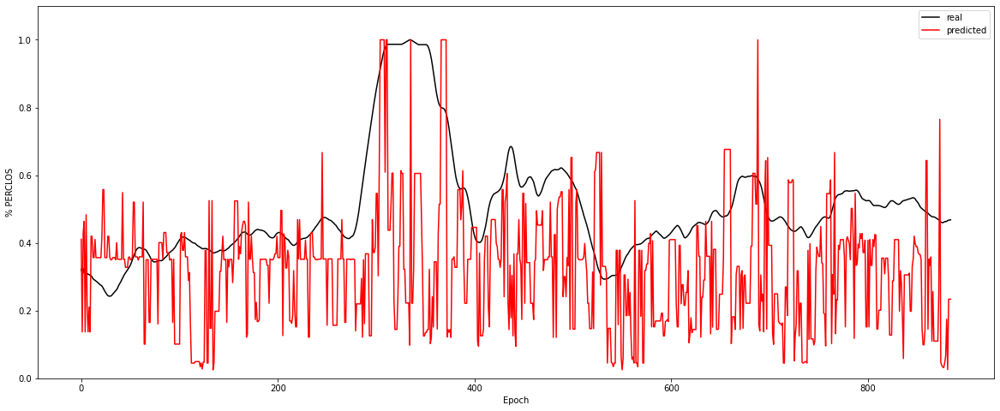

Experiment: 9_20151017_night
	RMSE: 0.2552
	r^2: -3.3614


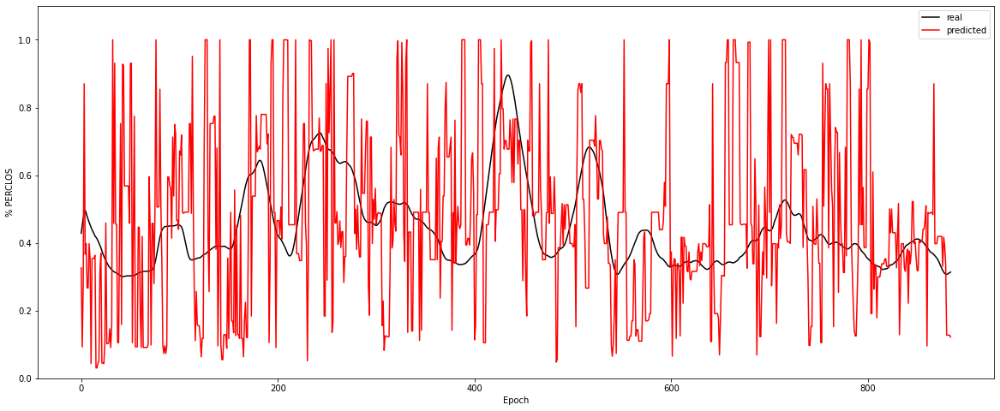

In [63]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### Decision Tree PSD + EOG

In [54]:
print(f"Experiment: Modelo 90-10 Decision Tree PSD")
model = DecisionTreeRegressor(random_state=42)

space = dict()
space['criterion'] = ['mse', 'friedman_mse']
space['splitter'] = ["best", "random"]
space['max_depth'] = [None]
space['min_samples_split'] = [2]
space['min_samples_leaf'] = [1]
space['max_features'] = ["auto", "sqrt", "log2"]

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub_eog, y_sub, model, space, cv=10,  n_iter=100)

Experiment: Modelo 90-10 Decision Tree PSD


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:289: UserWarning: The total space of parameters 12 is smaller than n_iter=100. Running 12 iterations. For exhaustive searches, use GridSearchCV.
  % (grid_size, self.n_iter, grid_size), UserWarning)


Best Model:
	Score: 0.6054
	Hyperparameters: {'splitter': 'best', 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'auto', 'max_depth': None, 'criterion': 'friedman_mse'}

Results with X_test:
	RMSE: 0.1751
	r^2: 0.6128


In [55]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

n_parpadeos: 0.3422
psd_gamma: 0.1603
psd_alpha: 0.1447
psd_theta: 0.1412
psd_delta: 0.1167
psd_betha: 0.0949


Experiment: 13_20150929_noon
	RMSE: 0.3030
	r^2: -1.2809


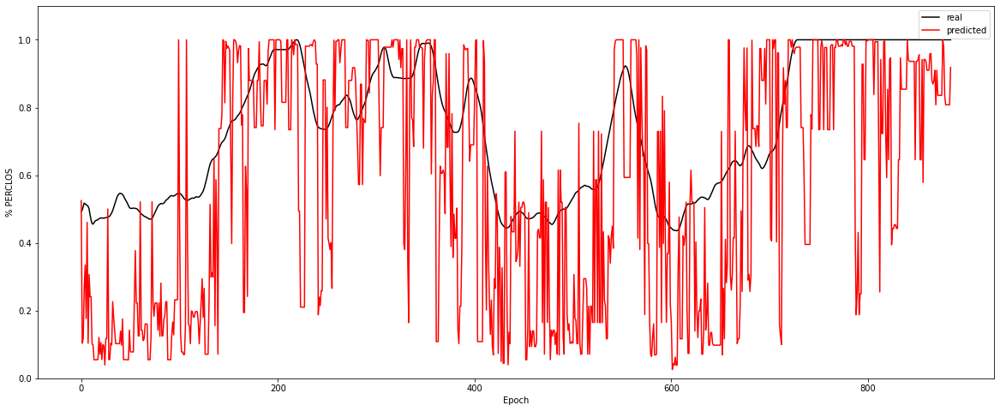

Experiment: 7_20151015_night
	RMSE: 0.2116
	r^2: -2.3949


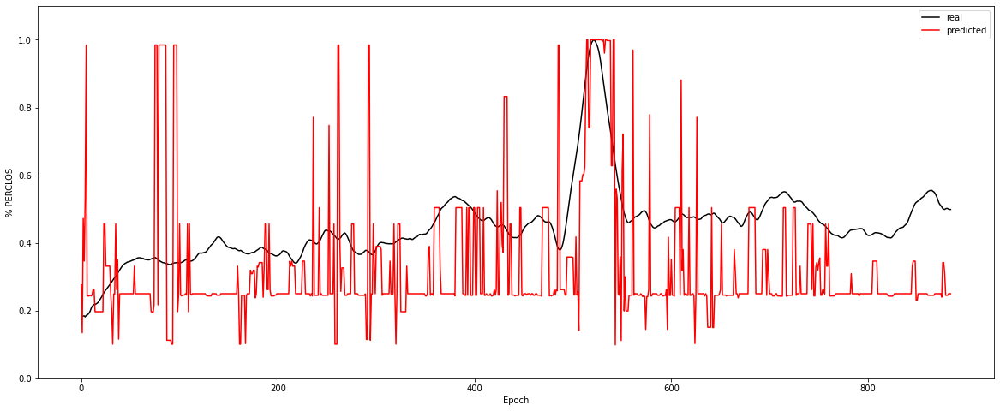

Experiment: 2_20151106_noon
	RMSE: 0.2100
	r^2: -0.6452


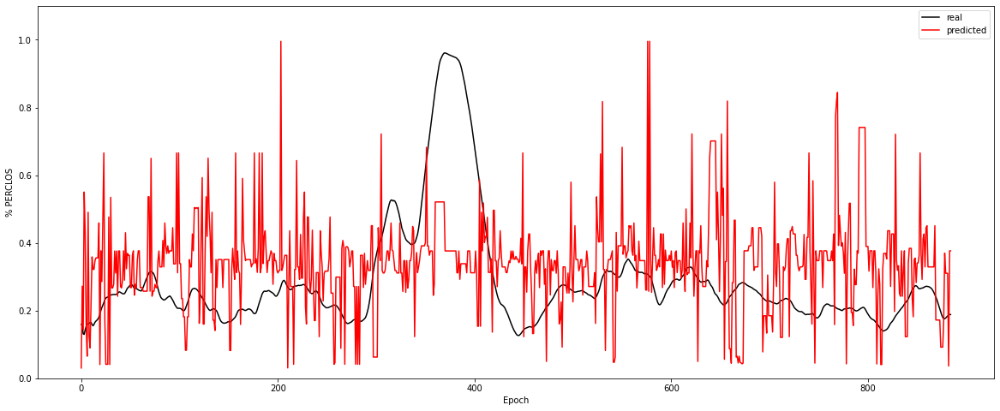

Experiment: 8_20151022_noon
	RMSE: 0.2208
	r^2: 0.1521


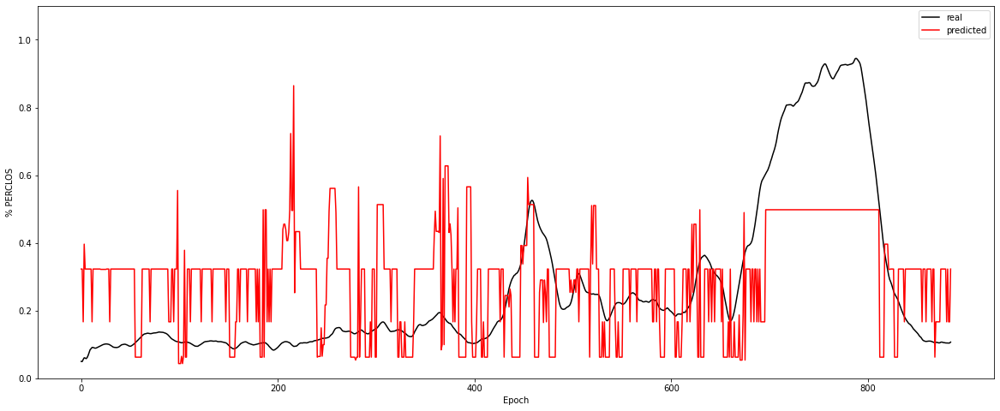

Experiment: 14_20151014_night
	RMSE: 0.2580
	r^2: -0.2793


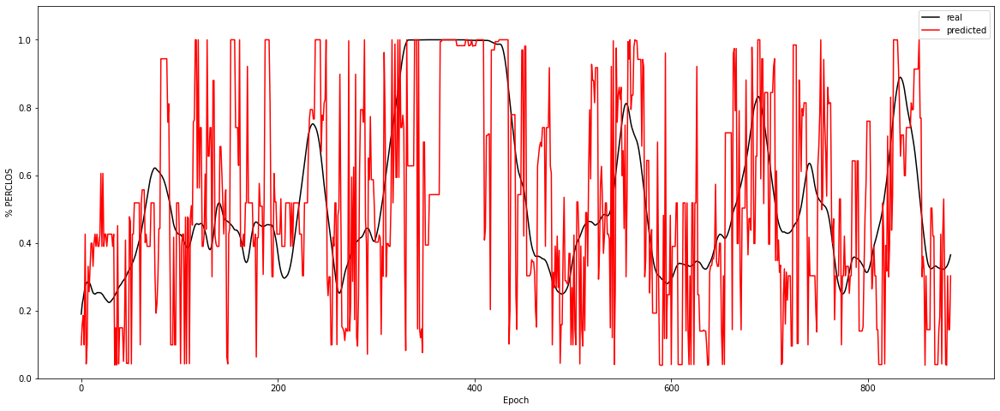

Experiment: 3_20151024_noon
	RMSE: 0.2650
	r^2: -1.6439


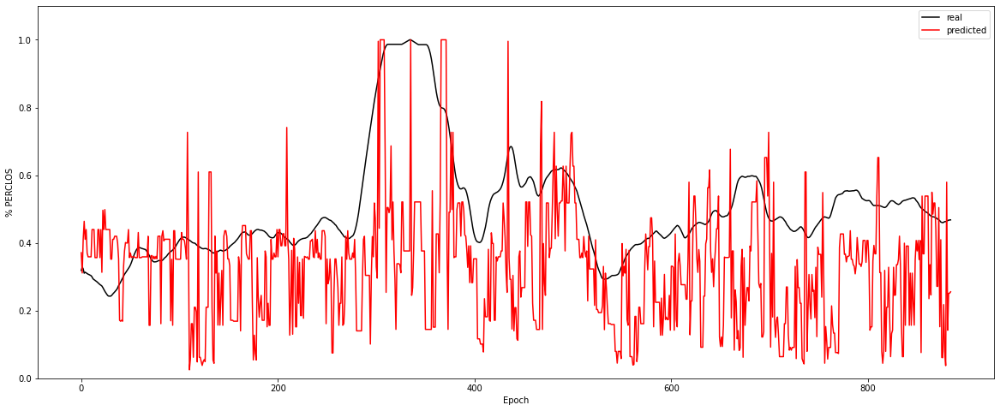

Experiment: 9_20151017_night
	RMSE: 0.2202
	r^2: -2.2481


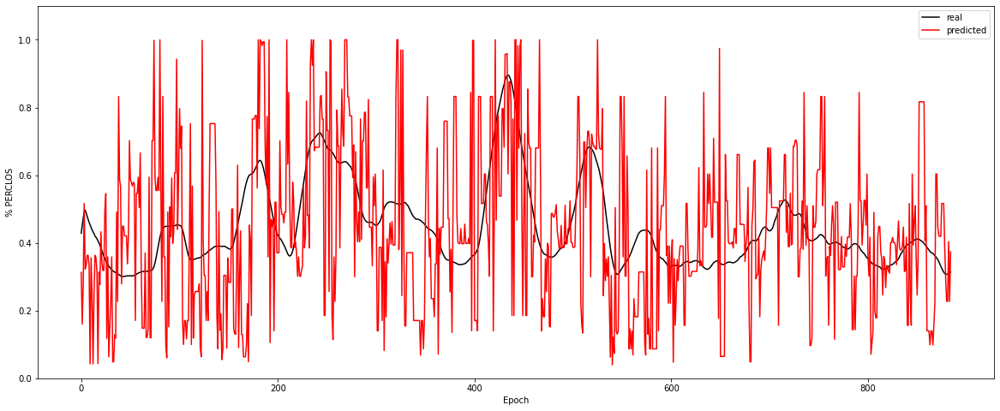

In [56]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

## Random Forest

In [65]:
from sklearn.ensemble import RandomForestRegressor

### Random Forest PSD

In [64]:
print(f"Experiment: Modelo 70-30 Random Forest PSD")
model = RandomForestRegressor(random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ['mse']
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'X_all_eogform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub, y_sub, model, space, cv=10,  n_iter=25)

Experiment: Modelo 70-30 Random Forest PSD
Best Model:
	Score: 0.7972
	Hyperparameters: {'criterion': 'mse', 'max_depth': 92, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	RMSE: 0.1288
	r^2: 0.7905


In [66]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2647
psd_gamma: 0.2476
psd_theta: 0.1911
psd_delta: 0.1617
psd_betha: 0.1349


Experiment: 13_20150929_noon
	RMSE: 0.2244
	r^2: -0.2509


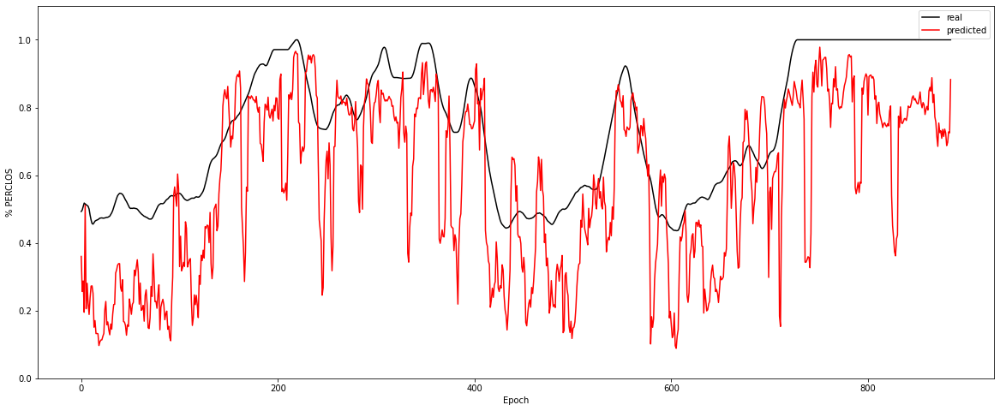

Experiment: 7_20151015_night
	RMSE: 0.1140
	r^2: 0.0140


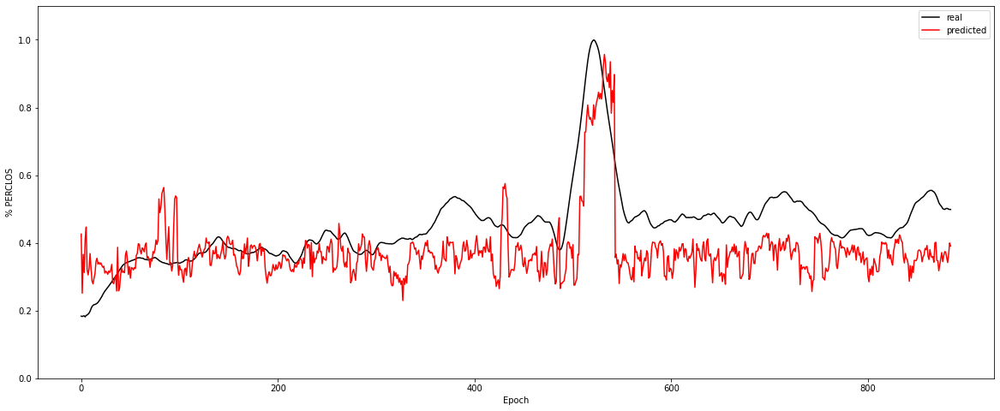

Experiment: 2_20151106_noon
	RMSE: 0.1724
	r^2: -0.1088


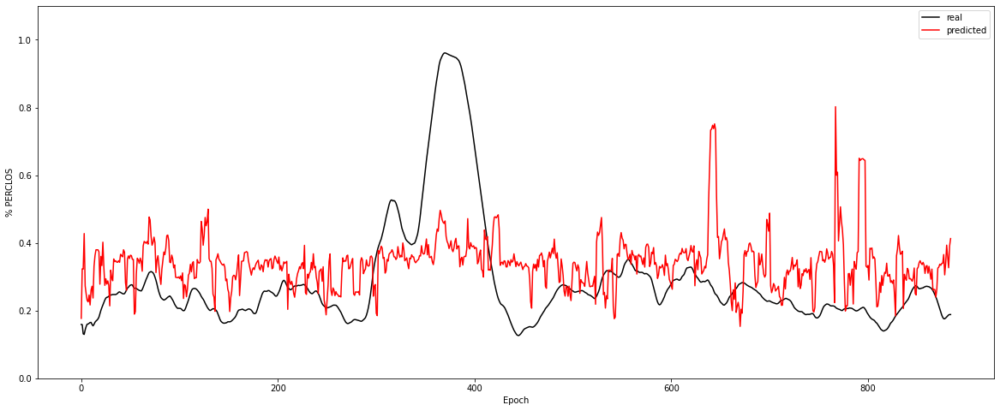

Experiment: 8_20151022_noon
	RMSE: 0.2145
	r^2: 0.2002


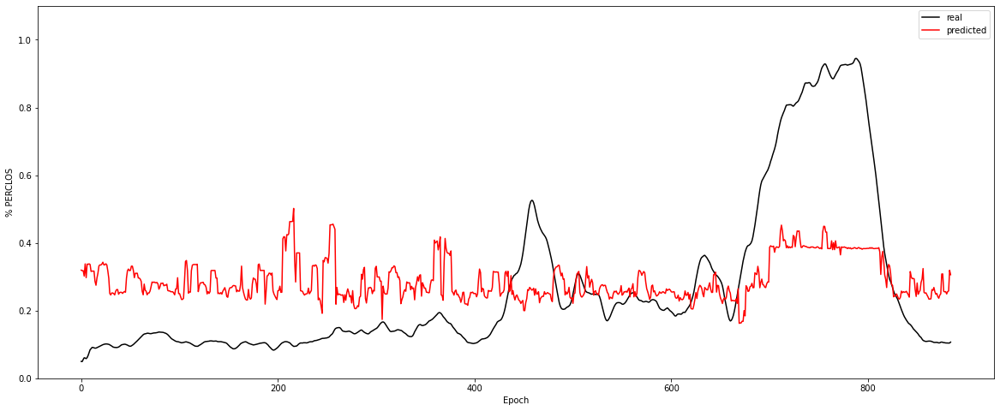

Experiment: 14_20151014_night
	RMSE: 0.2058
	r^2: 0.1862


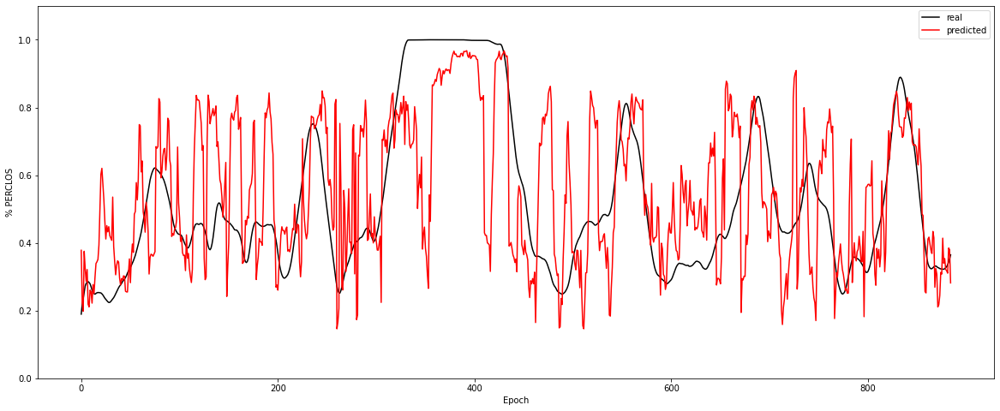

Experiment: 3_20151024_noon
	RMSE: 0.2418
	r^2: -1.2014


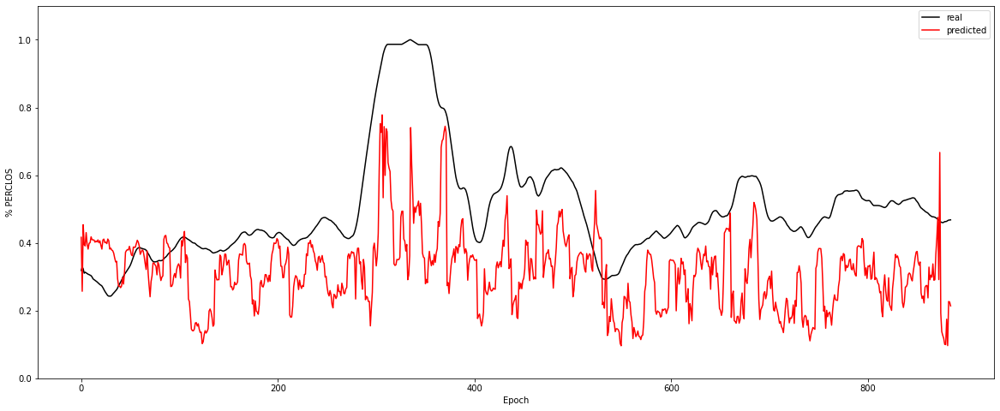

Experiment: 9_20151017_night
	RMSE: 0.1515
	r^2: -0.5378


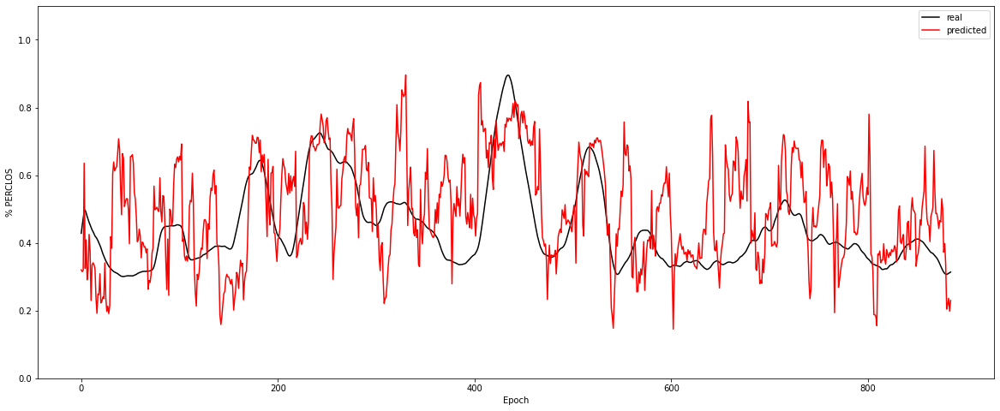

In [67]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

### Random Forest PSD + EOG

In [68]:
print(f"Experiment: Modelo 70-30 Random Forest PSD+EOG")
model = RandomForestRegressor(random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ['mse']
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'X_all_eogform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

partial_model, rmse, r2 = find_and_test_best_model_reg(X_sub_eog, y_sub, model, space, cv=10,  n_iter=25)

Experiment: Modelo 70-30 Random Forest PSD
Best Model:
	Score: 0.7934
	Hyperparameters: {'criterion': 'mse', 'max_depth': 92, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	RMSE: 0.1297
	r^2: 0.7874


In [69]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

n_parpadeos: 0.2672
psd_alpha: 0.1898
psd_gamma: 0.1617
psd_theta: 0.1555
psd_delta: 0.1220
psd_betha: 0.1038


Experiment: 13_20150929_noon
	RMSE: 0.2182
	r^2: -0.1835


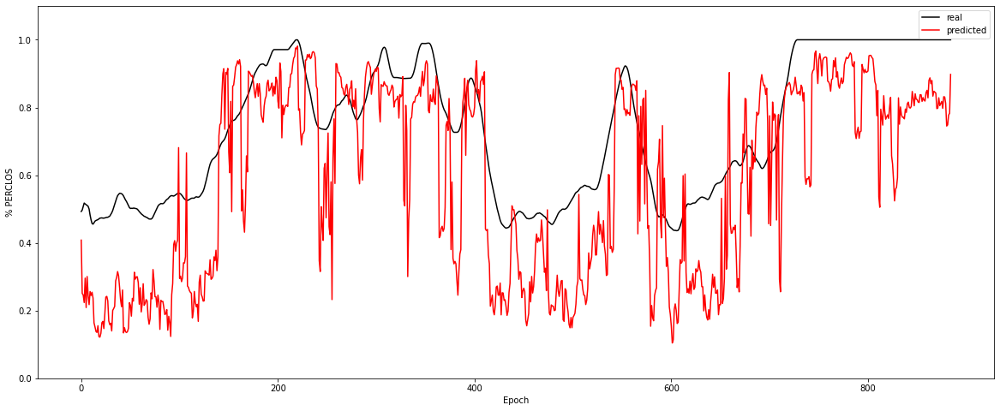

Experiment: 7_20151015_night
	RMSE: 0.1376
	r^2: -0.4362


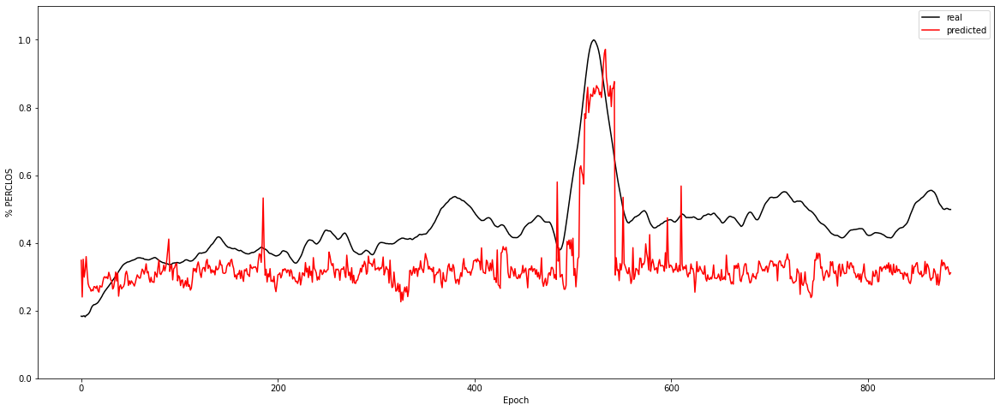

Experiment: 2_20151106_noon
	RMSE: 0.1673
	r^2: -0.0451


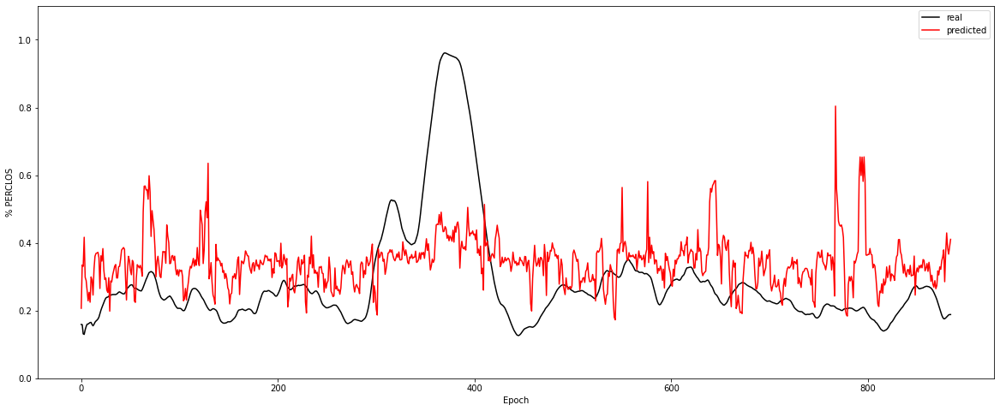

Experiment: 8_20151022_noon
	RMSE: 0.2325
	r^2: 0.0603


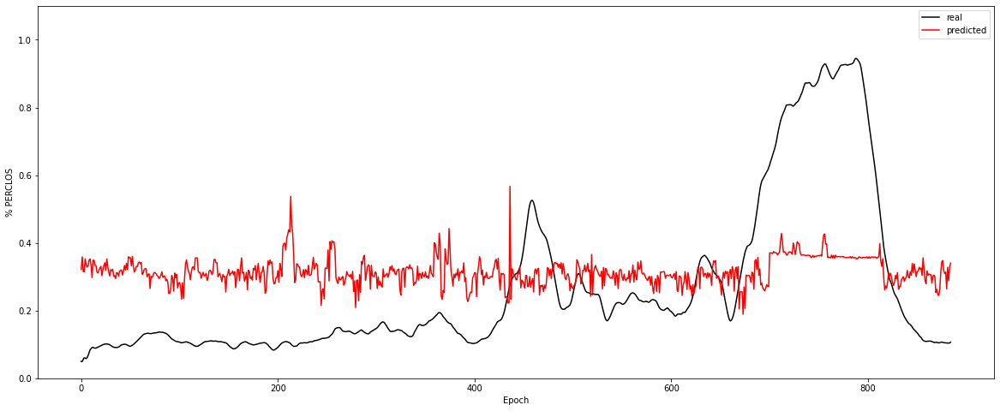

Experiment: 14_20151014_night
	RMSE: 0.1791
	r^2: 0.3834


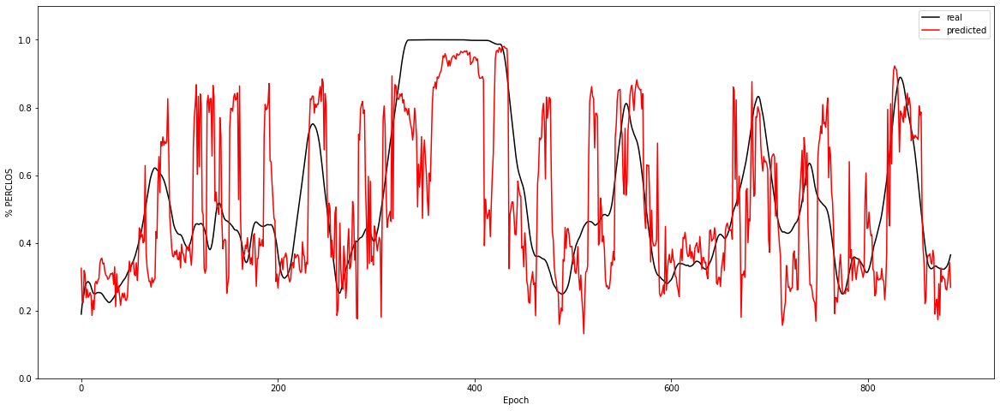

Experiment: 3_20151024_noon
	RMSE: 0.2319
	r^2: -1.0239


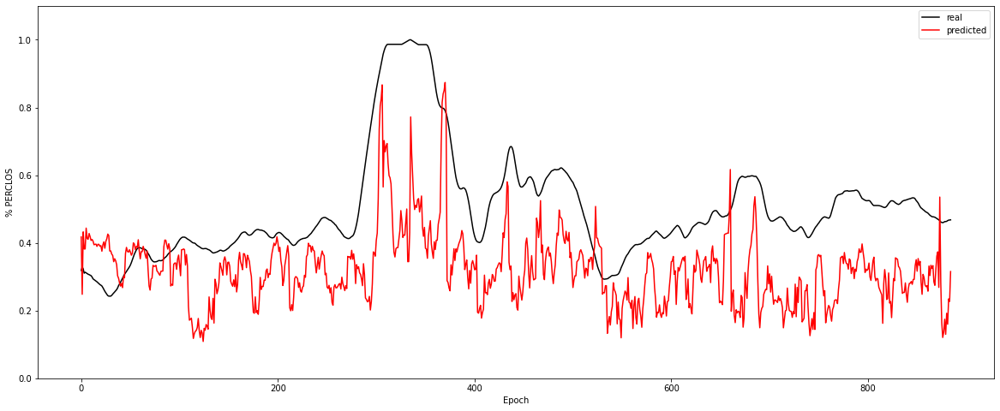

Experiment: 9_20151017_night
	RMSE: 0.1170
	r^2: 0.0837


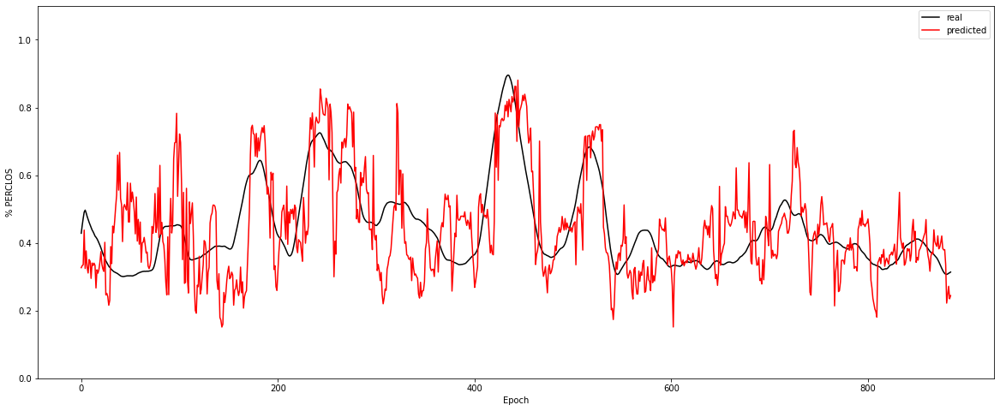

In [70]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    expected = y_all[key]
    predictions = partial_model.predict(data)
    local_rmse = np.sqrt(mean_squared_error(expected, predictions))
    local_r2 = r2_score(expected, predictions)

    print(f'Experiment: {key}')
    print(f"\tRMSE: {local_rmse:.4f}")
    print(f"\tr^2: {local_r2:.4f}")

    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()

# Ahora que tenemos una input mucho mas grande al juntar todos los X en uno, vamos a probar con Deep Learning (GRU)

In [57]:
import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, GRU
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
from tensorflow.keras.optimizers import SGD, Adam

In [41]:
def gru_train_model(X, y, neurons=15, layers=2, verbose=1):
    
    # Tenemos que pasar de X de (885,n_features) a (885,n_features,1) para trabajar con RNN (LSTM, GRU, ...)
    X_rs = np.reshape(X, (X.shape[0],X.shape[1],1))
    # Tenemos que pasar de y de (885,) a (885,1)
    y_rs = np.reshape(y, (y.shape[0],1))

    X_train, X_test, y_train, y_test = train_test_split(X_rs, y_rs, test_size=0.25, random_state=42)

    model = Sequential()
    model.add(GRU(neurons, input_shape=(None, 1), return_sequences=True))
    
    #Internal layers
    for i in range(layers-1):
        model.add(GRU(neurons, return_sequences=True))
    model.add(GRU(neurons))
    
    model.add(Dense(1))

    early_stop = EarlyStopping(monitor='loss', patience=10, verbose=verbose)
    optimizer = Adam(beta_1=0.9, beta_2=0.999, lr=0.01, decay=1e-4)

    model.compile(loss='mean_squared_error', optimizer=optimizer)

    #model.summary()
    
    model.fit(X_train, y_train, batch_size=32, epochs=200, verbose=verbose, callbacks=[early_stop])
    
    return model

In [42]:
DL_model = gru_train_model(X, y)

Epoch 1/200
478/478 [==============================] - 5s 4ms/step - loss: 0.0706
Epoch 2/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0556
Epoch 3/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0509
Epoch 4/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0483
Epoch 5/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0434
Epoch 6/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0395
Epoch 7/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0377
Epoch 8/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0360
Epoch 9/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0345
Epoch 10/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0343
Epoch 11/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0314
Epoch 12/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0314
Epoch 13/200


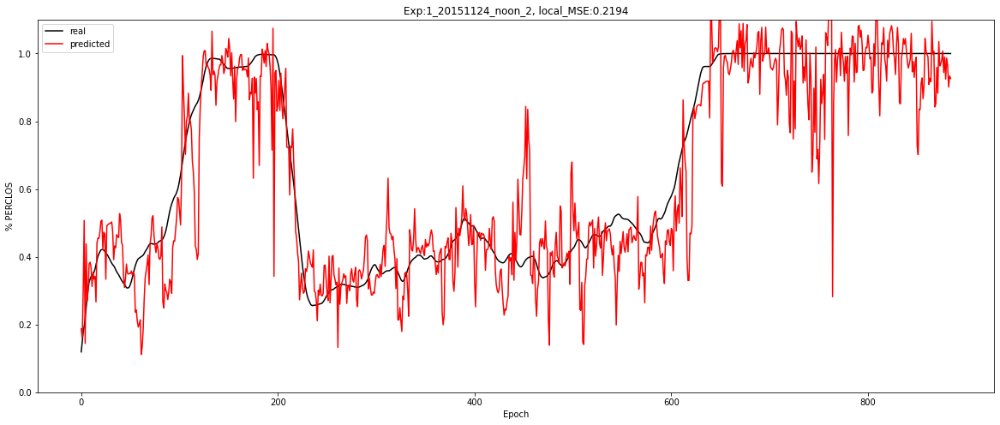

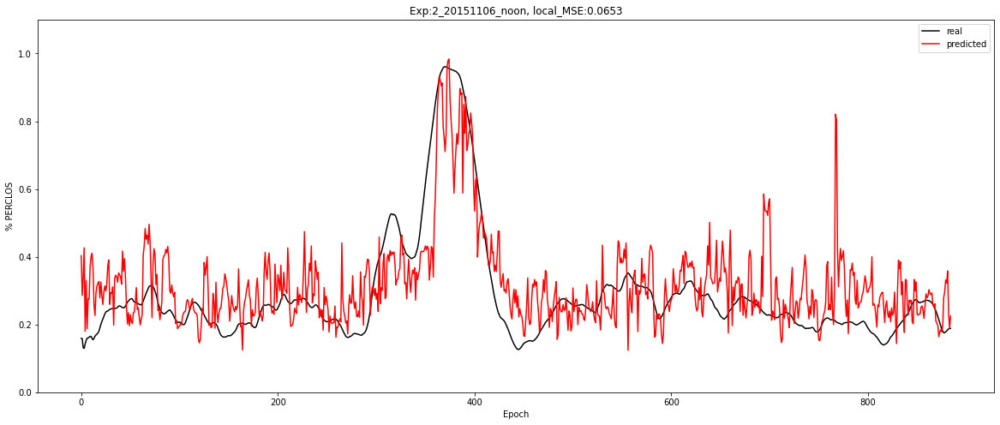

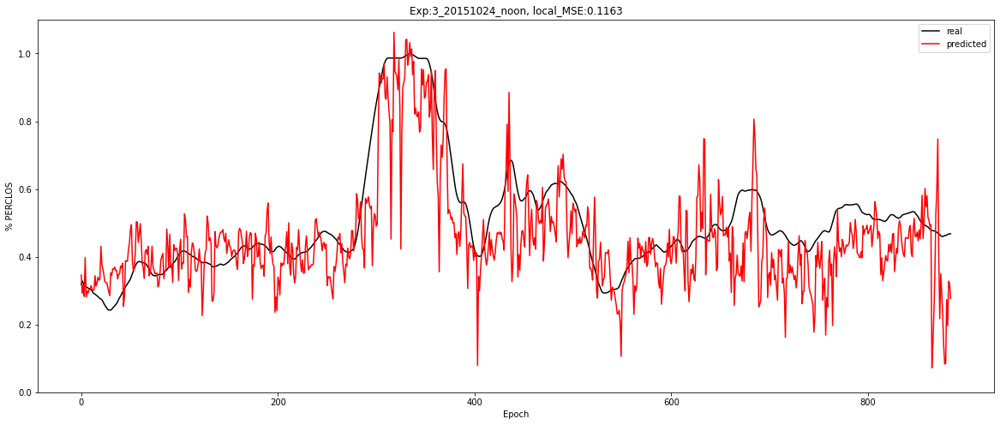

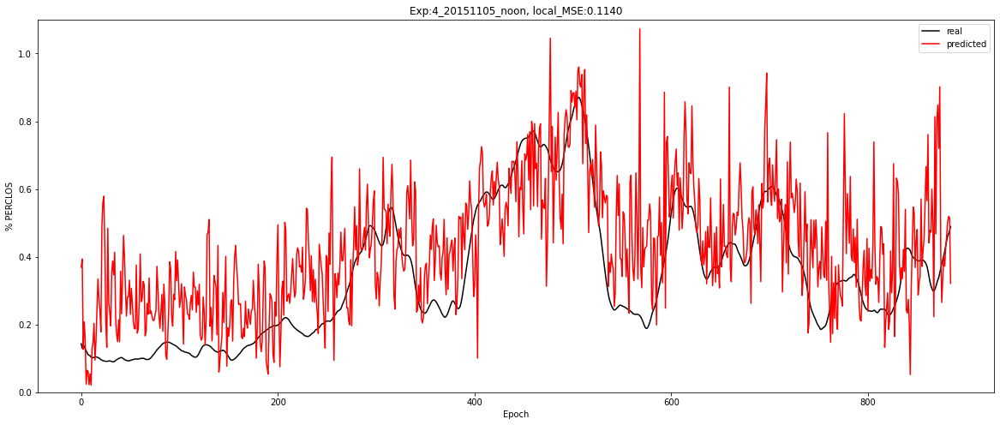

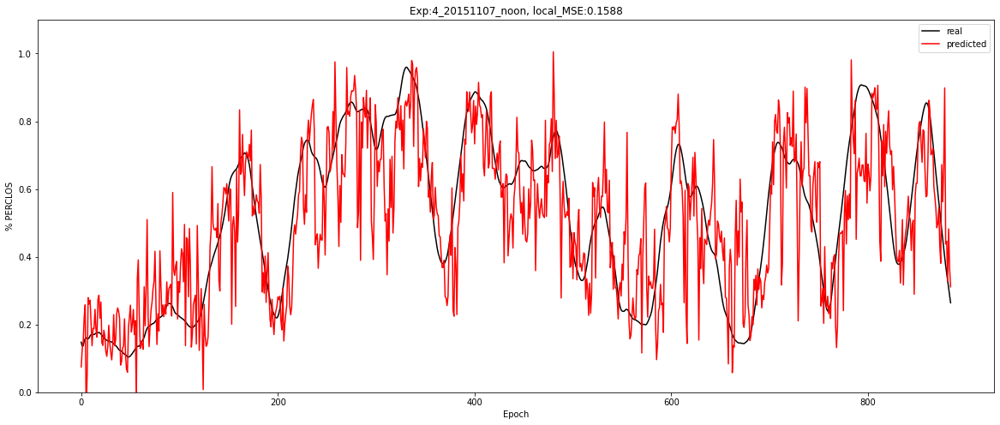

...

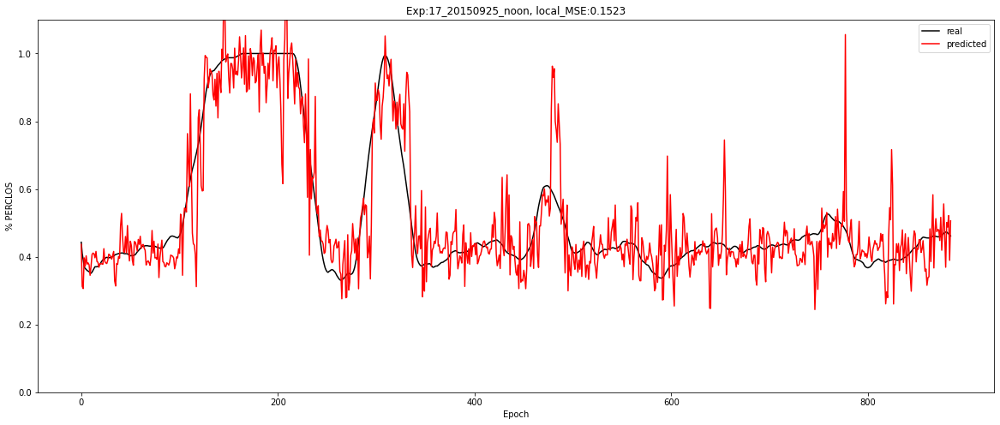

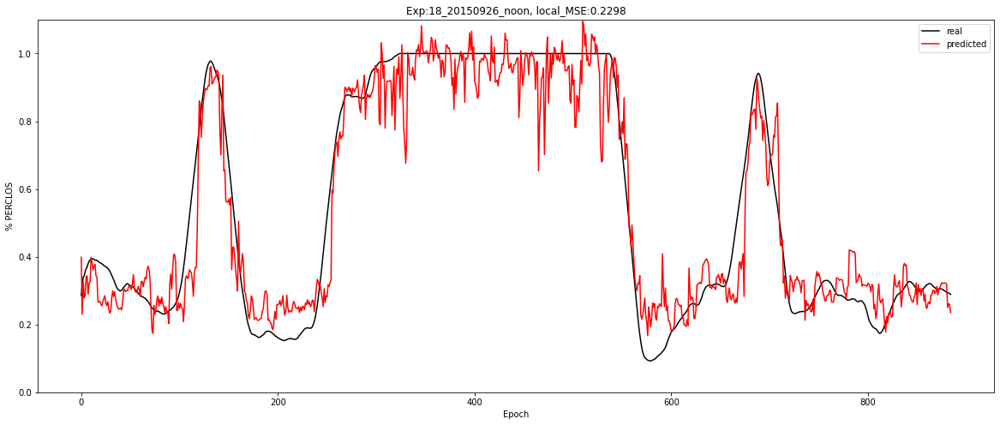

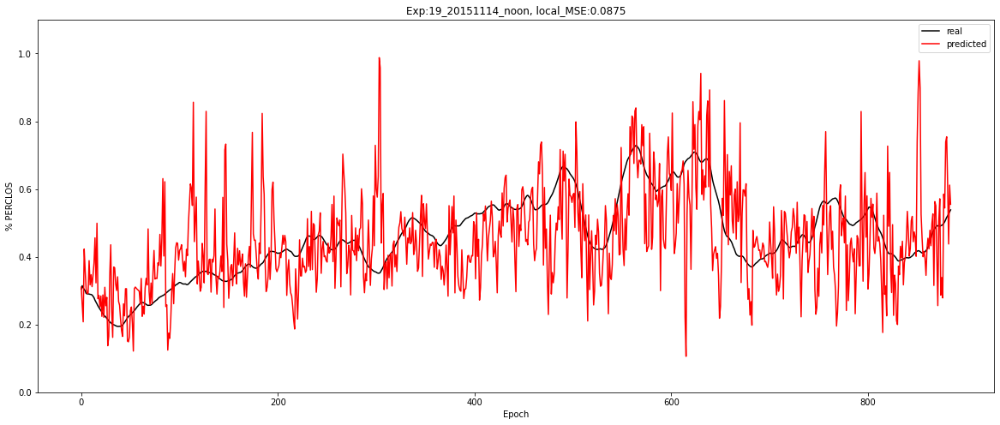

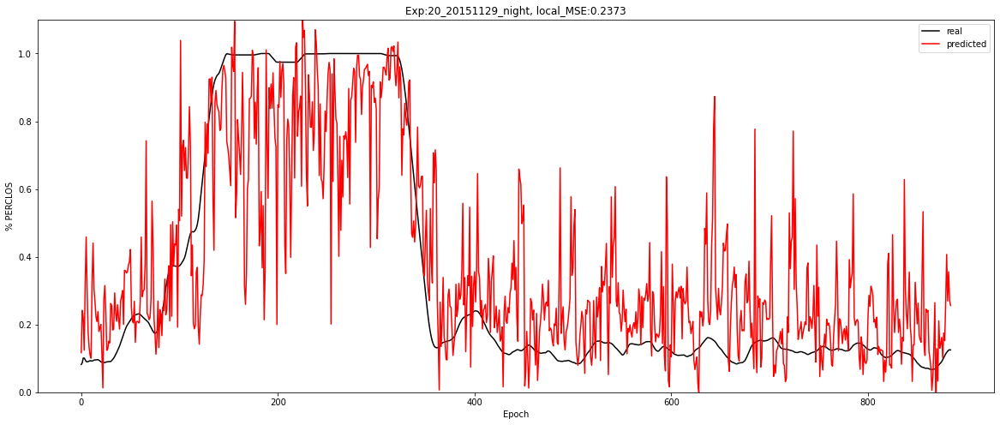

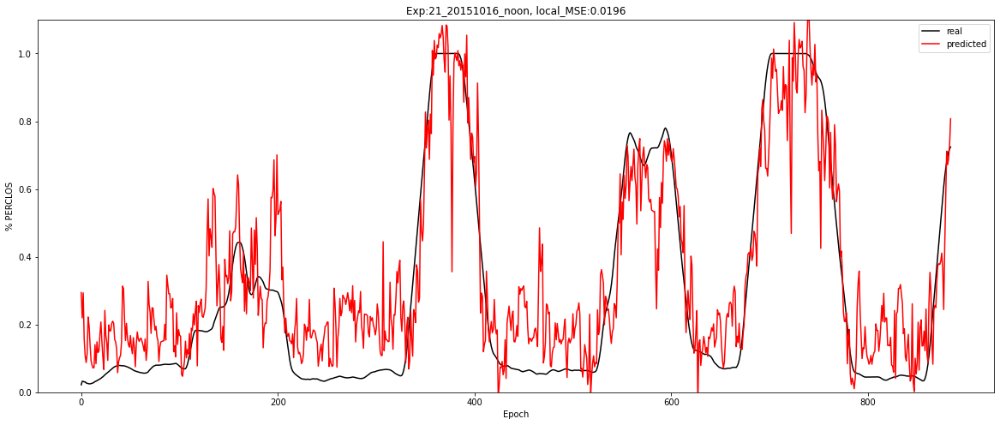

In [44]:
for key in X_all:
    data = X_all[key]
    expected = y_all[key]

    predictions = DL_model.predict(np.reshape(data, (data.shape[0],data.shape[1],1)))
    local_mse = mean_squared_error(np.reshape(expected, (expected.shape[0],1)), prediction)
    
    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.title(f'Exp:{key}, local_MSE:{local_mse:.4f}')
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()